In [1]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
# print(sc.__version__)

In [2]:
import squidpy as sq

/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/numba/core/decorators.py:246: RuntimeWarning: nopython is set for njit and is ignored
  warnings.warn('nopython is set for njit and is ignored', RuntimeWarning)


In [3]:
sq.__version__

'1.6.2'

In [4]:
%matplotlib inline

In [5]:
plt.style.use('seaborn-white')

/tmp/ipykernel_317129/1193657973.py:1: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-white')


In [6]:
# sc.logging.print_versions()
sc.set_figure_params(facecolor="white", figsize=(8, 8))
sc.settings.verbosity = 3

In [1585]:
# the spot level results (one spot may have serveral cells)

In [1583]:
# Load processed dataset from spatial HEMO data
# We directly adopted processed spatial deconvoluted cell type from the study of "Organoid-based single-cell spatiotemporal gene expression landscape of human embryonic development and hematopoiesis"
# data available at # https://www-nature-com.eproxy.lib.hku.hk/articles/s41392-023-01455-y
adata = sc.read_h5ad('upload/blood_slice4/sp_adata.h5ad')
adata

AnnData object with n_obs × n_vars = 1217 × 2015
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'clusters', 'id', 'cell_count'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'estimated_be'
    uns: 'cell_locations', 'clusters_colors', 'hvg', 'id_colors', 'leiden', 'log1p', 'neighbors', 'pca', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'image_features', 'spatial'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

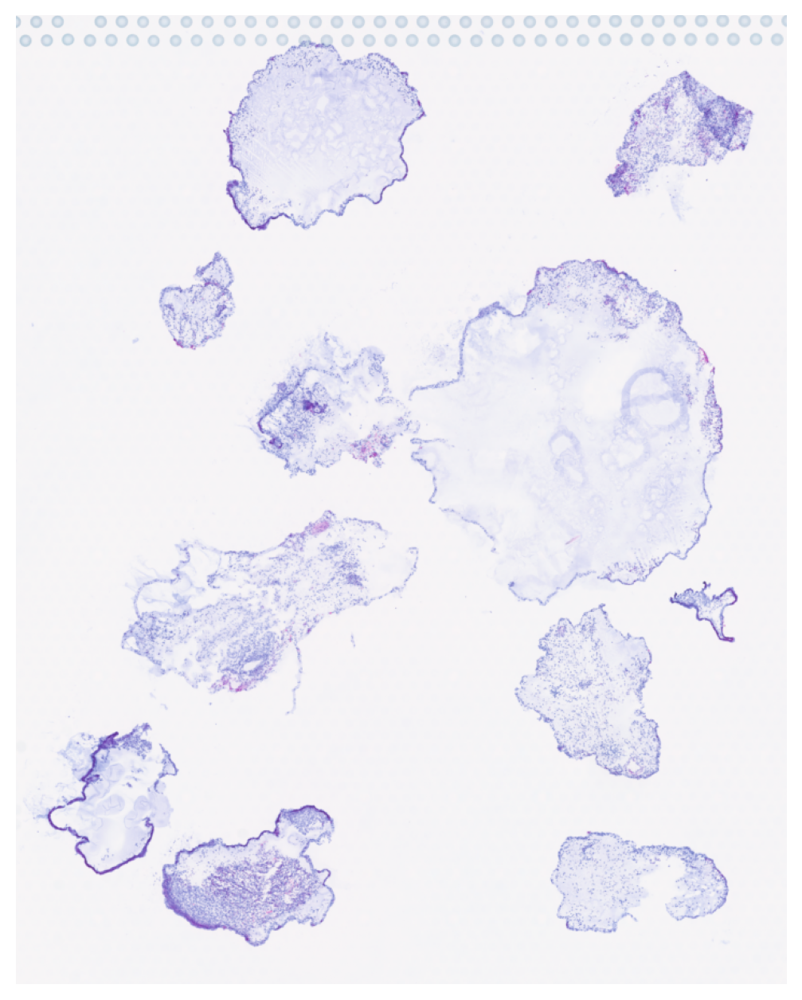

In [1584]:
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(
    adata,
    img_key="hires",
    size=1
)

In [1619]:
# read deconvolution info from https://www-nature-com.eproxy.lib.hku.hk/articles/s41392-023-01455-y
c_adata = sc.read_h5ad('upload/blood_slice4/generated_cells.h5ad')
adata.uns['cell_locations'] = c_adata.obs
c_adata

AnnData object with n_obs × n_vars = 3997 × 2235
    obs: 'x', 'y', 'spot_index', 'cell_index', 'cell_nums', 'discrete_label', 'discrete_label_ct'

In [1622]:
c_adata.obsm['spatial'] = adata.uns['cell_locations'][["x", "y"]].to_numpy().copy()
c_adata.uns = adata.uns

In [1624]:
c_adata.X.shape

(3997, 2235)

In [1625]:
c_adata.obs.head()

,x,y,spot_index,cell_index,cell_nums,discrete_label,discrete_label_ct
0,7229.568182,1376.250000,AAACAATCTACTAGCA-1,AAACAATCTACTAGCA-1_0,2,16,TB-like
1,7265.208333,1328.215278,AAACAATCTACTAGCA-1,AAACAATCTACTAGCA-1_1,2,16,TB-like
2,9521.443038,7487.443038,AAACCTAAGCAGCCGG-1,AAACCTAAGCAGCCGG-1_0,2,6,MEP
3,9567.500000,7461.450000,AAACCTAAGCAGCCGG-1,AAACCTAAGCAGCCGG-1_1,2,4,Fibro
4,9986.863014,7445.328767,AAACGGGCGTACGGGT-1,AAACGGGCGTACGGGT-1_0,3,11,Mono


In [1626]:
c_adata

AnnData object with n_obs × n_vars = 3997 × 2235
    obs: 'x', 'y', 'spot_index', 'cell_index', 'cell_nums', 'discrete_label', 'discrete_label_ct'
    uns: 'cell_locations', 'clusters_colors', 'hvg', 'id_colors', 'leiden', 'log1p', 'neighbors', 'pca', 'spatial', 'umap', 'discrete_label_ct_colors', 'clone_colors'
    obsm: 'spatial'

In [1627]:
c_adata.to_df().head()

,HES4,ISG15,AGRN,TNFRSF18,TNFRSF4,HES5,AL139246.5,TNFRSF14,SMIM1,TNFRSF25,...,LHB,OSM,SSTR3,LINC02154,CD40LG,PLXNB3,FASLG,AC084116.1,CCL13,AC007922.4
0,0.000000,2.533981,0.00000,0.001024,0.002245,0.000092,0.000000,0.000220,0.000000,0.000000,...,0.000000,0.003412,0.000000,0.000000,0.000000,0.000000,0.001499,0.000164,0.002297,0.000000
1,0.000000,9.822296,0.00000,0.000000,0.001429,0.000000,0.000491,0.000000,0.001231,0.000444,...,0.000000,0.001536,0.002760,0.006052,0.000000,0.000000,0.003097,0.001149,0.000973,0.000000
2,0.006395,13.374535,0.00000,0.000000,0.006044,0.000140,0.000000,0.001580,0.000000,0.000783,...,0.000000,0.001020,0.000000,0.000182,0.000000,0.001029,0.000000,0.000000,0.002076,0.001103
3,0.000000,6.655397,0.00893,0.004104,0.002893,0.000000,0.000402,0.000000,3.123613,0.000000,...,0.000000,0.000000,0.000527,0.001568,0.002671,0.000000,0.000000,0.000123,0.000295,0.003708
4,0.008664,0.007048,0.00000,0.002290,0.003134,0.000863,0.003909,0.001865,0.001669,0.001643,...,0.001325,0.003648,0.000000,0.000000,0.000000,0.000000,0.000901,0.000000,0.000000,0.000000


In [1628]:
# get hemo label

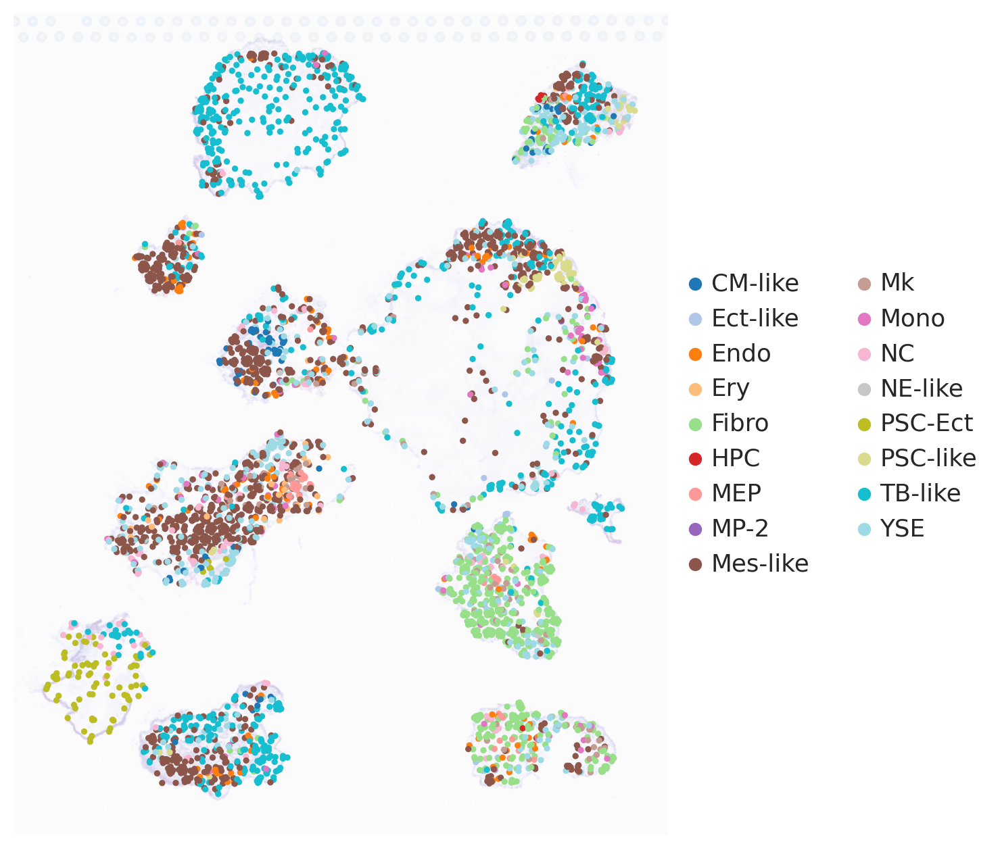

In [1629]:
import matplotlib as mpl

fig, ax = plt.subplots(1,1,figsize=(12, 8),dpi=100)

merged_df = adata.uns['cell_locations'].copy()
# merged_df = merged_df[merged_df['discrete_label_ct'].isin(['Ery', 'Mk', 'MEP', 'YSE'])]

# merged_df
# test = sc.AnnData(np.zeros(merged_df.shape), obs=merged_df)
test = sc.AnnData(c_adata.X, obs=merged_df)
test.obsm['spatial'] = merged_df[["x", "y"]].to_numpy().copy()
test.uns = adata.uns

size=0.8
size=0.8
alpha_img=0.3
lw=1
palette='tab20'
show_circle = False
# show_circle = True
legend = True
# ax=None
annotation_list = ["discrete_label_ct"]
crop_coord = None
# crop_coord = [5500, 8200, 4500, 6200]

subset=None
if crop_coord != None:
    subset = test.obs[['x','y']].query('(%d<x<%d) & (%d<y<%d)' % (crop_coord[0], crop_coord[1], crop_coord[2], crop_coord[3])).index

if subset is not None:
        #test = test[test.obs[annotation_list].isin(subset)]
        # test.obs.loc[~test.obs[annotation_list].isin(subset),annotation_list] = None
        test.obs.loc[~test.obs.index.isin(subset),annotation_list] = None
sc.pl.spatial(
        test,
        color=annotation_list,
        crop_coord = crop_coord,
        size=size,
        frameon=False,
        alpha_img=alpha_img,
        show=False,
        palette=palette,
        na_in_legend=False,
        ax=ax,title='',sort_order=True
    )
if show_circle:
        sf = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['tissue_hires_scalef']
        spot_radius = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['spot_diameter_fullres']/2
        for sloc in adata.obsm['spatial']:
            rect = mpl.patches.Circle(
                (sloc[0] * sf, sloc[1] * sf),
                spot_radius * sf,
                ec="grey",
                lw=lw,
                fill=False
            )
            ax.add_patch(rect)
ax.axes.xaxis.label.set_visible(False)
ax.axes.yaxis.label.set_visible(False)

if not legend:
    ax.get_legend().remove()

# make frame visible
for _, spine in ax.spines.items():
    spine.set_visible(True)

In [1630]:
all_part_i = [['frag1', 5500, 8200, 4500, 6200], ['frag2', 6000, 9000, 800, 2500], ['frag3', 8000, 10700, 2500, 5400], ['frag4', 9000, 10700, 7000, 8000], ['frag5', 9500, 11000, 0, 2500], ['frag6', 6800, 8000, 3000, 4500], ['frag7', 8900, 10200, 5300, 6800], ['frag8', 5000, 6500, 6200, 7600], ['frag9', 6000, 7800, 6800, 8100], ['frag10', 6000, 7000, 2500, 3500]]
# all_part_i = [['frag1', [5500, 8200, 4500, 6200], ['frag2', 6000, 9000, 800, 2500], ['frag3', 8000, 10700, 2500, 5400], ['frag4', 9000, 10700, 7000, 8000], ['frag5', 9500, 11000, 0, 2500], ['frag6', 6800, 8000, 3000, 4500], ['frag7', 8900, 10200, 5300, 6800], ['frag8', 5000, 6500, 6200, 7600], ['frag9', 6000, 7800, 6800, 8100], ['frag10', 6000, 7000, 2500, 3500]]
all_part_i = [['hemo1', [5500, 8200, 4500, 6200], None], ['hemo2', [6800, 8000, 3000, 4500], None], ['hemo3', [6100, 7800, 6800, 8100], [6100, 6200, 6800, 7200]], ['hemo4', [6000, 7000, 2500, 3500], None],  ['hemo5', [9500, 11000, 1000, 2200],None]]


def get_tar_df(i_df, _x='x', _y='y', _crop_coord=[5500, 8200, 4500, 6200], _skip_coord=None):
    tar_df = i_df[[_x, _y]].query('(%d<x<%d) & (%d<y<%d)' % (_crop_coord[0], _crop_coord[1], _crop_coord[2], _crop_coord[3]))
    if _skip_coord is not None:
        sp = i_df[[_x, _y]].query('(%d<x<%d) & (%d<y<%d)' % (_skip_coord[0], _skip_coord[1], _skip_coord[2], _skip_coord[3]))
        tar_df = pd.DataFrame.drop(tar_df, index=sp.index)
    return tar_df.index


[None]

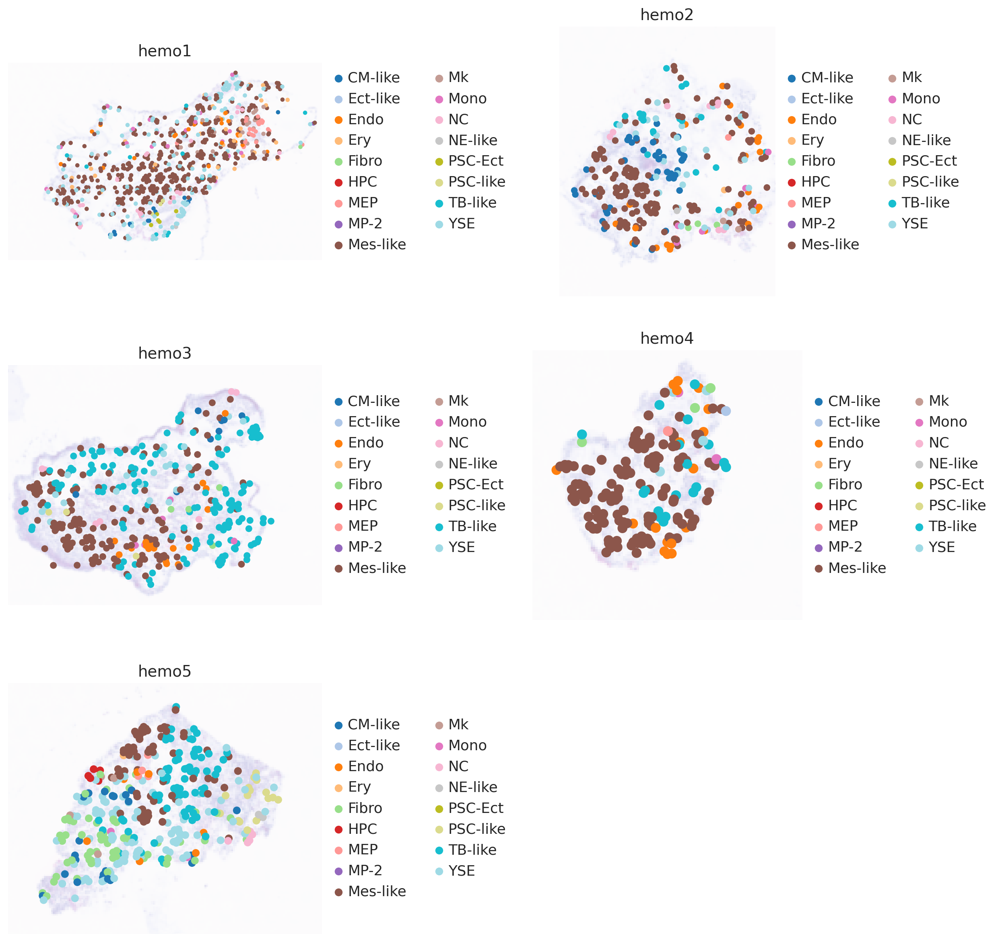

In [1631]:
import matplotlib as mpl


import math


ncols = 2
_n = len(all_part_i)
n_l = int(math.ceil(_n/ncols))

nrows = n_l
figsize = 5
wspace = 0.6
fig, axs = plt.subplots(
    nrows=nrows,
    ncols=ncols,
    figsize=(ncols * figsize + figsize * wspace * (ncols - 1), nrows * figsize),
)
# print(axs)
plt.subplots_adjust(wspace=wspace)

p_s = 1.5


for i in range(_n):
#     print(i, int(i/ncols), i%ncols)
    _ax = axs[int(i/ncols), i%ncols]
#     _ax = axs[int(i%ncols)]
    _ax.get_xaxis().set_visible(False)
    _ax.get_yaxis().set_visible(False)


# fig, ax = plt.subplots(1,1,figsize=(12, 8),dpi=100)
    ax = _ax
    merged_df = adata.uns['cell_locations'].copy()
    # merged_df = merged_df[merged_df['discrete_label_ct'].isin(['Ery', 'Mk', 'MEP', 'YSE'])]
    
    # merged_df
    test = sc.AnnData(np.zeros(merged_df.shape), obs=merged_df)
    test.obsm['spatial'] = merged_df[["x", "y"]].to_numpy().copy()
    test.uns = adata.uns
    
    size=0.8
    size=0.5
    alpha_img=0.3
    lw=1
    palette='tab20'
    show_circle = False
    legend = True
    # ax=None
    annotation_list = ["discrete_label_ct"]
    crop_coord = None
    _title = ""
    crop_coord = [5500, 8200, 4500, 6200]
    crop_coord = all_part_i[i][1]
    skip_coord = all_part_i[i][2]
    _title = all_part_i[i][0]
    subset=None
    
    if crop_coord != None:
        # subset = test.obs[['x','y']].query('(%d<x<%d) & (%d<y<%d)' % (crop_coord[0], crop_coord[1], crop_coord[2], crop_coord[3])).index
        subset = get_tar_df(test.obs, 'x', 'y', crop_coord, skip_coord)
    
    if subset is not None:
            #test = test[test.obs[annotation_list].isin(subset)]
            # test.obs.loc[~test.obs[annotation_list].isin(subset),annotation_list] = None
            test.obs.loc[~test.obs.index.isin(subset),annotation_list] = None
    sc.pl.spatial(
            test,
            color=annotation_list,
            crop_coord = crop_coord,
            size=size,
            frameon=False,
            alpha_img=alpha_img,
            show=False,
            palette=palette,
            na_in_legend=False,
            ax=ax,title=_title,sort_order=True
        )
    if show_circle:
            sf = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['tissue_hires_scalef']
            spot_radius = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['spot_diameter_fullres']/2
            for sloc in adata.obsm['spatial']:
                rect = mpl.patches.Circle(
                    (sloc[0] * sf, sloc[1] * sf),
                    spot_radius * sf,
                    ec="grey",
                    lw=lw,
                    fill=False
                )
                ax.add_patch(rect)
    ax.axes.xaxis.label.set_visible(False)
    ax.axes.yaxis.label.set_visible(False)
    
    if not legend:
        ax.get_legend().remove()
    
    # make frame visible
    for _, spine in ax.spines.items():
        spine.set_visible(True)
        
[fig.delaxes(ax) for ax in axs.flatten() if not ax.has_data()]


In [1632]:
new_cell_loc_df = adata.uns['cell_locations'].copy()
new_cell_loc_df['cell_w'] = 1.0/new_cell_loc_df['cell_nums']

# add hemo label
new_cell_loc_df['hemo_label'] = ''

_n = len(all_part_i)
for i in range(_n):
    crop_coord = all_part_i[i][1]
    skip_coord = all_part_i[i][2]
    _title = all_part_i[i][0]
    subset = get_tar_df(new_cell_loc_df, 'x', 'y', crop_coord, skip_coord)
    new_cell_loc_df.loc[subset, 'hemo_label'] = _title
new_cell_loc_df.tail(5)

,x,y,spot_index,cell_index,cell_nums,discrete_label,discrete_label_ct,cell_w,hemo_label
3992,6376.629630,5483.444444,TTGTTTCCATACAACT-1,TTGTTTCCATACAACT-1_0,3,9,Mes-like,0.333333,hemo1
3993,6373.215190,5493.670886,TTGTTTCCATACAACT-1,TTGTTTCCATACAACT-1_1,3,9,Mes-like,0.333333,hemo1
3994,6367.573333,5464.906667,TTGTTTCCATACAACT-1,TTGTTTCCATACAACT-1_2,3,9,Mes-like,0.333333,hemo1
3995,7690.871369,1769.336100,TTGTTTGTGTAAATTC-1,TTGTTTGTGTAAATTC-1_0,2,16,TB-like,0.500000,
3996,7731.149883,1738.145199,TTGTTTGTGTAAATTC-1,TTGTTTGTGTAAATTC-1_1,2,16,TB-like,0.500000,


In [1634]:
# create Genotype + clone csv for loading in cell type annotation
out_dir = './mquad/tree_dev/'
af_o_df = pd.read_csv(out_dir + "/clone_af.csv", sep="\t", header=0,  index_col=0)
af_m = af_o_df.to_numpy(dtype=np.float64)

# parse barcode and snp name
# af_cutoff = 0.02
# af_m[af_m>=af_cutoff] = 1
# af_m[af_m<af_cutoff] = 0

snp_id = ["%s%s>%s" % (tuple(i.split("_")[1:])) for i in af_o_df.index]

af_df = pd.DataFrame(af_m.T, columns=snp_id, dtype=np.float64)
af_columns = af_df.columns

af_columns_o = sorted(af_columns, key=lambda x:int(x[:-3]))

af_df['barcode'] = af_o_df.columns + "-1"

clone_df = pd.read_csv(out_dir + "/clone.csv")
clone_df['barcode'] = clone_df['barcode'] + "-1"

clone_af_all_df = pd.merge(af_df, clone_df, how='left')
# clone_af_all_df.to_csv(out_dir + '/clone_af_all.csv', index=False)
clone_label_prefix = 'clone'
c_o = sorted(clone_af_all_df['clone'].unique(), key=lambda x:int(x[len(clone_label_prefix):]))
print(c_o)
tmp_merge_o = clone_af_all_df.copy()
tmp_merge_o.head(2)


['clone0', 'clone1', 'clone2']


,1872T>A,1868G>A,2129G>A,1906G>A,843G>A,842C>A,9989T>C,838T>A,8594T>G,3219G>A,...,8610T>G,8618T>G,2292G>A,1858G>A,2562T>G,2351T>G,8603T>G,2507A>T,barcode,clone
0,0.014337,0.003546,0.019608,0.009464,0.024793,0.024000,0.000000,0.016000,0.000000,0.066667,...,0.000000,0.040000,0.000000,0.000000,0.000,0.051282,0.038462,0.000000,AAACAATCTACTAGCA-1,clone1
1,0.037931,0.025862,0.018059,0.008798,0.021277,0.025424,0.050562,0.025424,0.140351,0.007519,...,0.035714,0.053571,0.023392,0.005119,0.025,0.022989,0.140351,0.059524,AAACACCAATAACTGC-1,clone2


In [1635]:
# af_columns_o

In [1636]:
# create Genotype + clone csv for loading in cell type annotation
out_dir = './mquad/tree_dev/'
af_o_df = pd.read_csv(out_dir + "/clone_af.csv", sep="\t", header=0,  index_col=0)
af_m = af_o_df.to_numpy(dtype=np.float64)

# parse barcode and snp name
af_cutoff = 0.02
af_m[af_m>=af_cutoff] = 1
af_m[af_m<af_cutoff] = 0

snp_id = ["%s%s>%s" % (tuple(i.split("_")[1:])) for i in af_o_df.index]

af_df = pd.DataFrame(af_m.T, columns=snp_id, dtype=np.float64)
af_columns = af_df.columns

af_columns_o = sorted(af_columns, key=lambda x:int(x[:-3]))

af_df['barcode'] = af_o_df.columns + "-1"

clone_df = pd.read_csv(out_dir + "/clone.csv")
clone_df['barcode'] = clone_df['barcode'] + "-1"

clone_af_all_df = pd.merge(af_df, clone_df, how='left')
# clone_af_all_df.to_csv(out_dir + '/clone_af_all.csv', index=False)
clone_label_prefix = 'clone'
c_o = sorted(clone_af_all_df['clone'].unique(), key=lambda x:int(x[len(clone_label_prefix):]))
print(c_o)
clone_af_all_df.head(2)


['clone0', 'clone1', 'clone2']


,1872T>A,1868G>A,2129G>A,1906G>A,843G>A,842C>A,9989T>C,838T>A,8594T>G,3219G>A,...,8610T>G,8618T>G,2292G>A,1858G>A,2562T>G,2351T>G,8603T>G,2507A>T,barcode,clone
0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,...,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,AAACAATCTACTAGCA-1,clone1
1,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,...,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,AAACACCAATAACTGC-1,clone2


In [1637]:
m_df = pd.merge(new_cell_loc_df, clone_af_all_df, how='left', left_on='spot_index', right_on="barcode")
# m_df.tail(3)
# m_df.shape
c_adata.obs = m_df.copy()
c_adata.obs.tail()

,x,y,spot_index,cell_index,cell_nums,discrete_label,discrete_label_ct,cell_w,hemo_label,1872T>A,...,8610T>G,8618T>G,2292G>A,1858G>A,2562T>G,2351T>G,8603T>G,2507A>T,barcode,clone
3992,6376.629630,5483.444444,TTGTTTCCATACAACT-1,TTGTTTCCATACAACT-1_0,3,9,Mes-like,0.333333,hemo1,1.0,...,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,TTGTTTCCATACAACT-1,clone1
3993,6373.215190,5493.670886,TTGTTTCCATACAACT-1,TTGTTTCCATACAACT-1_1,3,9,Mes-like,0.333333,hemo1,1.0,...,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,TTGTTTCCATACAACT-1,clone1
3994,6367.573333,5464.906667,TTGTTTCCATACAACT-1,TTGTTTCCATACAACT-1_2,3,9,Mes-like,0.333333,hemo1,1.0,...,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,TTGTTTCCATACAACT-1,clone1
3995,7690.871369,1769.336100,TTGTTTGTGTAAATTC-1,TTGTTTGTGTAAATTC-1_0,2,16,TB-like,0.500000,,1.0,...,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,TTGTTTGTGTAAATTC-1,clone2
3996,7731.149883,1738.145199,TTGTTTGTGTAAATTC-1,TTGTTTGTGTAAATTC-1_1,2,16,TB-like,0.500000,,1.0,...,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,TTGTTTGTGTAAATTC-1,clone2


/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/autofs/bal31/jhsu/home/_env

[]

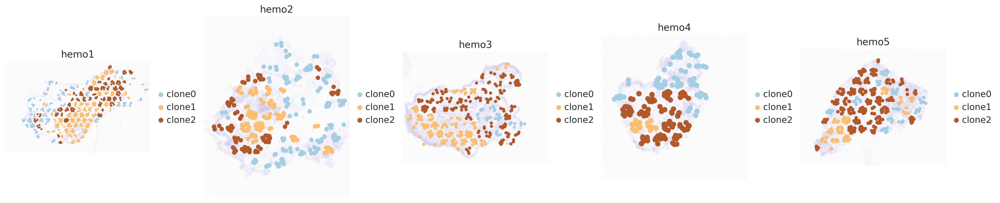

In [1643]:
import matplotlib as mpl


import math


ncols = 5
_n = len(all_part_i)
n_l = int(math.ceil(_n/ncols))

nrows = n_l
figsize = 4
wspace = 0
fig, axs = plt.subplots(
    nrows=nrows,
    ncols=ncols,
    figsize=(ncols * figsize + figsize * wspace * (ncols - 1), nrows * figsize),constrained_layout=True
)
# print(axs)
# plt.subplots_adjust(wspace=wspace)

p_s = 1.5

axs = axs.flatten()

for i in range(_n):
#     print(i, int(i/ncols), i%ncols)
    # _ax = axs[int(i/ncols), i%ncols]
    _ax = axs[i]
#     _ax = axs[int(i%ncols)]
    _ax.get_xaxis().set_visible(False)
    _ax.get_yaxis().set_visible(False)


# fig, ax = plt.subplots(1,1,figsize=(12, 8),dpi=100)
    ax = _ax
    # merged_df = adata.uns['cell_locations'].copy()
    merged_df = m_df.copy()
    # merged_df = merged_df[merged_df['discrete_label_ct'].isin(['Ery', 'Mk', 'MEP', 'YSE'])]
    
    # merged_df
    test = sc.AnnData(np.zeros(merged_df.shape), obs=merged_df)
    test.obsm['spatial'] = merged_df[["x", "y"]].to_numpy().copy()
    test.uns = adata.uns
    
    size=0.8
    size=0.5
    alpha_img=0.3
    lw=1
    palette='Paired'
    show_circle = False
    legend = True
    # ax=None
    # annotation_list = ["discrete_label_ct"]
    annotation_list = ["clone"]
    crop_coord = None
    _title = ""
    crop_coord = [5500, 8200, 4500, 6200]
    crop_coord = all_part_i[i][1]
    skip_coord = all_part_i[i][2]
    _title = all_part_i[i][0]
    subset=None
    
    if crop_coord != None:
        # subset = test.obs[['x','y']].query('(%d<x<%d) & (%d<y<%d)' % (crop_coord[0], crop_coord[1], crop_coord[2], crop_coord[3])).index
        subset = get_tar_df(test.obs, 'x', 'y', crop_coord, skip_coord)
    
    if subset is not None:
            #test = test[test.obs[annotation_list].isin(subset)]
            # test.obs.loc[~test.obs[annotation_list].isin(subset),annotation_list] = None
            test.obs.loc[~test.obs.index.isin(subset),annotation_list] = None
    sc.pl.spatial(
            test,
            color=annotation_list,
            crop_coord = crop_coord,
            size=size,
            frameon=False,
            alpha_img=alpha_img,
            show=False,
            palette=palette,
            na_in_legend=False,
            ax=ax,title=_title,sort_order=True
        )
    if show_circle:
            sf = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['tissue_hires_scalef']
            spot_radius = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['spot_diameter_fullres']/2
            for sloc in adata.obsm['spatial']:
                rect = mpl.patches.Circle(
                    (sloc[0] * sf, sloc[1] * sf),
                    spot_radius * sf,
                    ec="grey",
                    lw=lw,
                    fill=False
                )
                ax.add_patch(rect)
    ax.axes.xaxis.label.set_visible(False)
    ax.axes.yaxis.label.set_visible(False)
    
    if not legend:
        ax.get_legend().remove()
    
    # make frame visible
    for _, spine in ax.spines.items():
        spine.set_visible(True)
        
[fig.delaxes(ax) for ax in axs.flatten() if not ax.has_data()]


/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


[None, None]

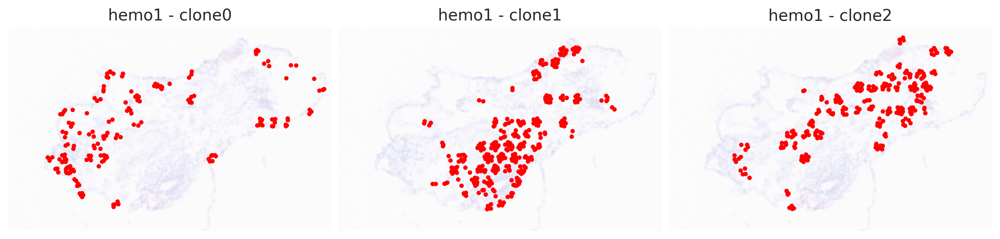

In [1617]:
import matplotlib as mpl


import math


ncols = 5
_n = len(all_part_i)
n_l = int(math.ceil(_n/ncols))

nrows = n_l
figsize = 4
wspace = 0
fig, axs = plt.subplots(
    nrows=nrows,
    ncols=ncols,
    figsize=(ncols * figsize + figsize * wspace * (ncols - 1), nrows * figsize),constrained_layout=True
)
# print(axs)
# plt.subplots_adjust(wspace=wspace)

p_s = 1.5

axs = axs.flatten()

for _i in range(3):
    _cc_n = "clone%s" % (_i)
    i = 0
#     print(i, int(i/ncols), i%ncols)
    # _ax = axs[int(i/ncols), i%ncols]
    _ax = axs[_i]
#     _ax = axs[int(i%ncols)]
    _ax.get_xaxis().set_visible(False)
    _ax.get_yaxis().set_visible(False)


# fig, ax = plt.subplots(1,1,figsize=(12, 8),dpi=100)
    ax = _ax
    # merged_df = adata.uns['cell_locations'].copy()
    merged_df = m_df.copy()
    # merged_df = merged_df[merged_df['discrete_label_ct'].isin(['Ery', 'Mk', 'MEP', 'YSE'])]
    
    # merged_df
    test = sc.AnnData(np.zeros(merged_df.shape), obs=merged_df)
    test.obsm['spatial'] = merged_df[["x", "y"]].to_numpy().copy()
    test.uns = adata.uns
    
    size=0.8
    size=0.5
    alpha_img=0.3
    lw=1
    palette='Reds'
    show_circle = False
    legend = True
    # ax=None
    # annotation_list = ["discrete_label_ct"]
    annotation_list = ["clone"]
    crop_coord = None
    _title = ""
    crop_coord = [5500, 8200, 4500, 6200]
    crop_coord = all_part_i[i][1]
    skip_coord = all_part_i[i][2]
    _title = all_part_i[i][0]
    subset=None
    
    if crop_coord != None:
        # subset = test.obs[['x','y']].query('(%d<x<%d) & (%d<y<%d)' % (crop_coord[0], crop_coord[1], crop_coord[2], crop_coord[3])).index
        subset = get_tar_df(test.obs, 'x', 'y', crop_coord, skip_coord)
    
    if subset is not None:
            #test = test[test.obs[annotation_list].isin(subset)]
            # test.obs.loc[~test.obs[annotation_list].isin(subset),annotation_list] = None
            test.obs.loc[~test.obs.index.isin(subset),annotation_list] = None
    cm = dict()
    for i in range(3):
        cm["clone" + str(i)] = "red"
    sc.pl.spatial(
            test,
            color=annotation_list,
            crop_coord = crop_coord,
             groups=[_cc_n], 
            size=size,
            frameon=False,
            alpha_img=alpha_img,
            show=False,
            palette=cm,
            na_in_legend=False,
            ax=ax,title=_title + " - " + _cc_n,sort_order=True
        )
    if show_circle:
            sf = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['tissue_hires_scalef']
            spot_radius = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['spot_diameter_fullres']/2
            for sloc in adata.obsm['spatial']:
                rect = mpl.patches.Circle(
                    (sloc[0] * sf, sloc[1] * sf),
                    spot_radius * sf,
                    ec="grey",
                    lw=lw,
                    fill=False
                )
                ax.add_patch(rect)
    ax.axes.xaxis.label.set_visible(False)
    ax.axes.yaxis.label.set_visible(False)
    
    ax.get_legend().remove()
    
    # make frame visible
    for _, spine in ax.spines.items():
        spine.set_visible(True)
    # break
        
[fig.delaxes(ax) for ax in axs.flatten() if not ax.has_data()]


[]

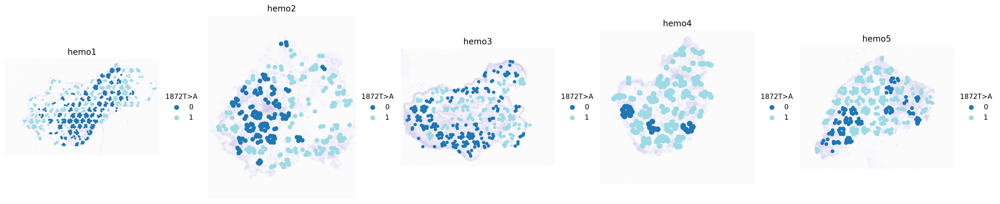

In [742]:
import matplotlib as mpl


import math


ncols = 5
_n = len(all_part_i)
n_l = int(math.ceil(_n/ncols))

nrows = n_l
figsize = 4
wspace = 0
fig, axs = plt.subplots(
    nrows=nrows,
    ncols=ncols,
    figsize=(ncols * figsize + figsize * wspace * (ncols - 1), nrows * figsize),constrained_layout=True
)
# print(axs)
# plt.subplots_adjust(wspace=wspace)

p_s = 1.5


tar_l = '1872T>A'
axs = axs.flatten()

for i in range(_n):
#     print(i, int(i/ncols), i%ncols)
    # _ax = axs[int(i/ncols), i%ncols]
    _ax = axs[i]
#     _ax = axs[int(i%ncols)]
    _ax.get_xaxis().set_visible(False)
    _ax.get_yaxis().set_visible(False)


# fig, ax = plt.subplots(1,1,figsize=(12, 8),dpi=100)
    ax = _ax
    # merged_df = adata.uns['cell_locations'].copy()
    merged_df = m_df.copy()
    merged_df[tar_l] = merged_df[tar_l].astype('int64').astype('str')
    
    # merged_df = merged_df[merged_df['discrete_label_ct'].isin(['Ery', 'Mk', 'MEP', 'YSE'])]
    
    # merged_df
    test = sc.AnnData(np.zeros(merged_df.shape), obs=merged_df)
    test.obsm['spatial'] = merged_df[["x", "y"]].to_numpy().copy()
    test.uns = adata.uns
    
    size=0.8
    size=0.5
    alpha_img=0.3
    lw=1
    palette='tab20'
    show_circle = False
    legend = True
    # ax=None
    annotation_list = [tar_l]
    # annotation_list = ["clone"]
    crop_coord = None
    _title = ""
    crop_coord = [5500, 8200, 4500, 6200]
    crop_coord = all_part_i[i][1]
    skip_coord = all_part_i[i][2]
    _title = all_part_i[i][0]
    subset=None
    
    if crop_coord != None:
        # subset = test.obs[['x','y']].query('(%d<x<%d) & (%d<y<%d)' % (crop_coord[0], crop_coord[1], crop_coord[2], crop_coord[3])).index
        subset = get_tar_df(test.obs, 'x', 'y', crop_coord, skip_coord)
    
    if subset is not None:
            #test = test[test.obs[annotation_list].isin(subset)]
            # test.obs.loc[~test.obs[annotation_list].isin(subset),annotation_list] = None
            test.obs.loc[~test.obs.index.isin(subset),annotation_list] = None
    sc.pl.spatial(
            test,
            color=annotation_list,
            crop_coord = crop_coord,
            size=size,
            frameon=False,
            alpha_img=alpha_img,
            show=False,
            palette=palette,
            na_in_legend=False,
            ax=ax,title=_title,sort_order=True
        )
    if show_circle:
            sf = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['tissue_hires_scalef']
            spot_radius = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['spot_diameter_fullres']/2
            for sloc in adata.obsm['spatial']:
                rect = mpl.patches.Circle(
                    (sloc[0] * sf, sloc[1] * sf),
                    spot_radius * sf,
                    ec="grey",
                    lw=lw,
                    fill=False
                )
                ax.add_patch(rect)
    ax.axes.xaxis.label.set_visible(False)
    ax.axes.yaxis.label.set_visible(False)
    
    # ax.legend(bbox_to_anchor=(1.3, 0.85),fontsize=9)
    ax.get_legend().set_title("%s" % (tar_l))
    if not legend:
        ax.get_legend().remove()
    
    # make frame visible
    for _, spine in ax.spines.items():
        spine.set_visible(True)
        
[fig.delaxes(ax) for ax in axs.flatten() if not ax.has_data()]


In [179]:
import sys

if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")

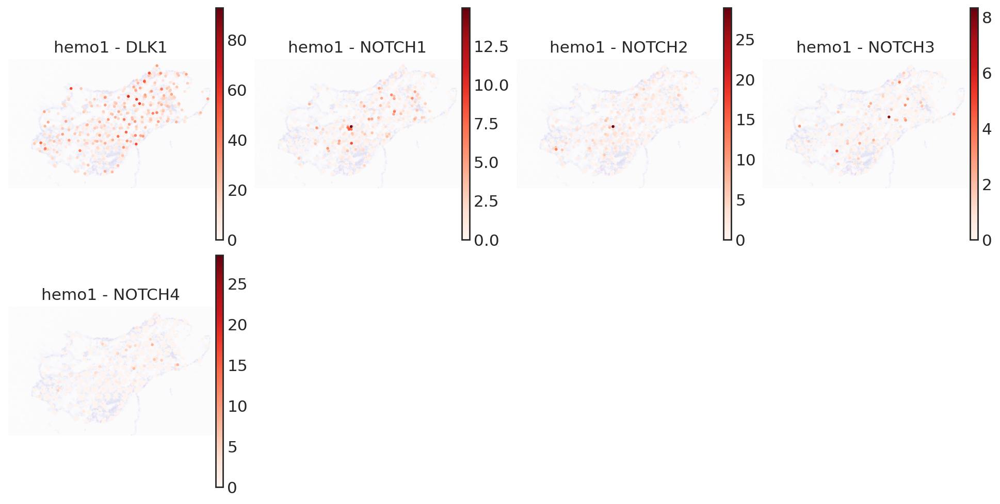

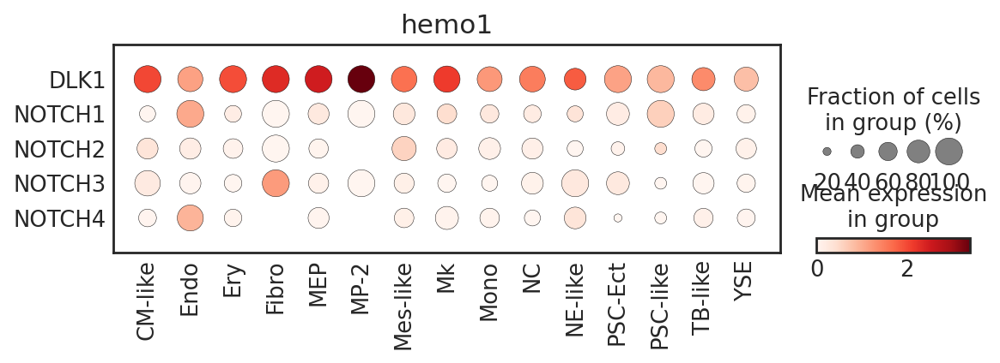

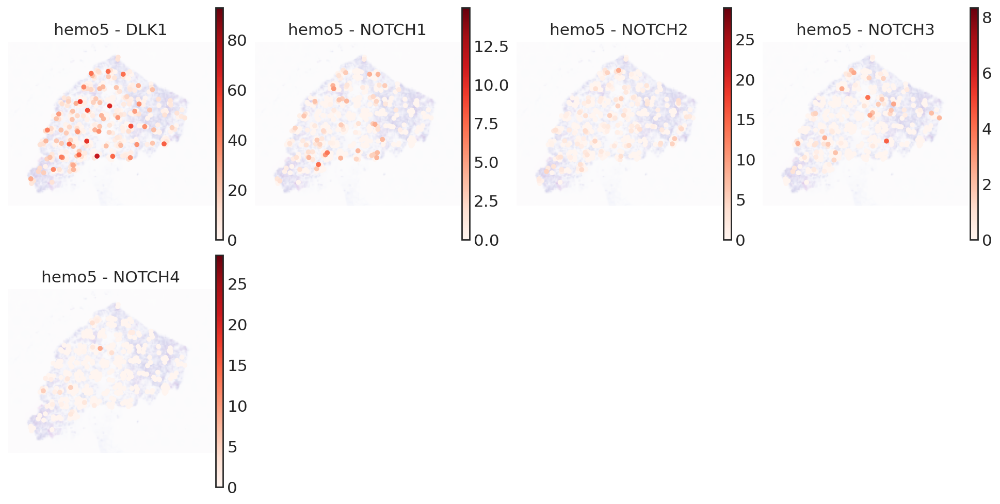

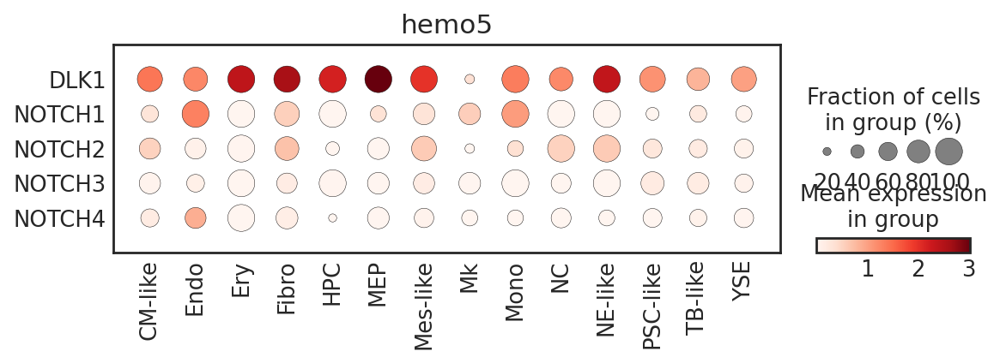

In [247]:
import matplotlib as mpl


import math
_all_part_i = [all_part_i[0], all_part_i[-1]]
for i in range(len(_all_part_i)):
    # tar_l = 'DLK1'

    
    

    a_tar_l = ['DLK1', 'NOTCH1', 'NOTCH2', 'NOTCH3', 'NOTCH4']
    _n = len(a_tar_l)

    ncols = 4
    
    n_l = int(math.ceil(_n/ncols))
    
    nrows = n_l
    figsize = 3
    wspace = 0
    fig, axs = plt.subplots(
        nrows=nrows,
        ncols=ncols,
        figsize=(ncols * figsize + figsize * wspace * (ncols - 1), nrows * figsize),constrained_layout=True
    )
    # print(axs)
    # plt.subplots_adjust(wspace=wspace)
    
    p_s = 1.5
    
    
    # tar_l = '1872T>A'
    # tar_l = 'DLK1'
    axs = axs.flatten()
    
    for _i, tar_l in enumerate(a_tar_l):
    #     print(i, int(i/ncols), i%ncols)
        # _ax = axs[int(i/ncols), i%ncols]
        _ax = axs[_i]
    #     _ax = axs[int(i%ncols)]
        _ax.get_xaxis().set_visible(False)
        _ax.get_yaxis().set_visible(False)
    
    
    # fig, ax = plt.subplots(1,1,figsize=(12, 8),dpi=100)
        ax = _ax
        # merged_df = adata.uns['cell_locations'].copy()
        merged_df = c_adata.obs.copy()
        # merged_df[tar_l] = merged_df[tar_l].astype('int64').astype('str')


        
        # merged_df[tar_l] = sc.get.obs_df(c_adata, keys=(tar_l))
        # merged_df.drop(tar_l)
        
        # merged_df = merged_df[merged_df['discrete_label_ct'].isin(['Ery', 'Mk', 'MEP', 'YSE'])]
        
        # merged_df
        test = sc.AnnData(c_adata.X, obs=merged_df)
        test.obs_names = c_adata.obs_names
        test.var_names = c_adata.var_names
        test.obsm['spatial'] = merged_df[["x", "y"]].to_numpy().copy()
        test.uns = adata.uns
        
        size=0.8
        size=0.5
        alpha_img=0.3
        lw=1
        palette='reds'
        show_circle = False
        legend = True
        # ax=None
        annotation_list = [tar_l]
        # annotation_list = ["clone"]
        crop_coord = None
        _title = ""
        crop_coord = [5500, 8200, 4500, 6200]
        crop_coord = _all_part_i[i][1]
        skip_coord = _all_part_i[i][2]
        _title = "%s - %s" % (_all_part_i[i][0], tar_l)
        
        subset=None
        
        if crop_coord != None:
            # subset = test.obs[['x','y']].query('(%d<x<%d) & (%d<y<%d)' % (crop_coord[0], crop_coord[1], crop_coord[2], crop_coord[3])).index
            subset = get_tar_df(test.obs, 'x', 'y', crop_coord, skip_coord)
        
        # if subset is not None:
        #         #test = test[test.obs[annotation_list].isin(subset)]
        #         # test.obs.loc[~test.obs[annotation_list].isin(subset),annotation_list] = None
        #         test.obs.loc[~test.obs.index.isin(subset),annotation_list] = None
        sc.pl.spatial(
                test,
                color=annotation_list,
                crop_coord = crop_coord,
                size=size,
                frameon=False,
                alpha_img=alpha_img,
                show=False,
                cmap='Reds',
                na_in_legend=False,
                ax=ax,title=_title,sort_order=True
            )
        if show_circle:
                sf = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['tissue_hires_scalef']
                spot_radius = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['spot_diameter_fullres']/2
                for sloc in adata.obsm['spatial']:
                    rect = mpl.patches.Circle(
                        (sloc[0] * sf, sloc[1] * sf),
                        spot_radius * sf,
                        ec="grey",
                        lw=lw,
                        fill=False
                    )
                    ax.add_patch(rect)
        ax.axes.xaxis.label.set_visible(False)
        ax.axes.yaxis.label.set_visible(False)
        
        # ax.legend(bbox_to_anchor=(1.3, 0.85),fontsize=9)
        # ax.get_legend().set_title("%s" % (tar_l))
        if not legend:
            ax.get_legend().remove()
        
        # make frame visible
        for _, spine in ax.spines.items():
            spine.set_visible(True)
            
    [fig.delaxes(ax) for ax in axs.flatten() if not ax.has_data()]
    _sadata = c_adata.copy()
    _tmp_tt = _all_part_i[i][0]
    _sadata = _sadata[(_sadata.obs['hemo_label']==_tmp_tt)]

    a_tar_l = ['DLK1', 'NOTCH1', 'NOTCH2', 'NOTCH3', 'NOTCH4']
    
    
    
    sc.pl.dotplot(_sadata, a_tar_l, groupby='discrete_label_ct', dendrogram=False, swap_axes=True,log=True,title=_tmp_tt,
        figsize=(8, 2),)

In [253]:
_sadata

AnnData object with n_obs × n_vars = 363 × 2235
    obs: 'x', 'y', 'spot_index', 'cell_index', 'cell_nums', 'discrete_label', 'discrete_label_ct', 'cell_w', 'hemo_label', '1872T>A', '1868G>A', '2129G>A', '1906G>A', '843G>A', '842C>A', '9989T>C', '838T>A', '8594T>G', '3219G>A', '2559T>G', '8597T>G', '2266T>G', '3174T>A', '8610T>G', '8618T>G', '2292G>A', '1858G>A', '2562T>G', '2351T>G', '8603T>G', '2507A>T', 'barcode', 'clone'

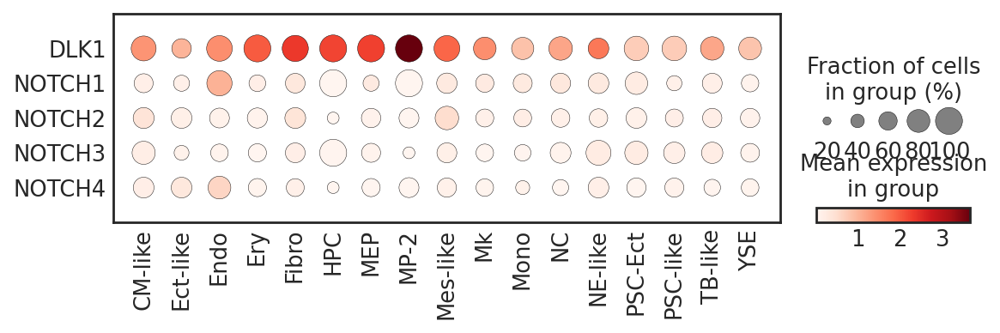

In [256]:
a_tar_l = ['DLK1', 'NOTCH1', 'NOTCH2', 'NOTCH3', 'NOTCH4']



sc.pl.dotplot(test, a_tar_l, groupby='discrete_label_ct', dendrogram=False, swap_axes=True,log=True,
    figsize=(8, 2),)

In [137]:
_sadata = c_adata.copy()
_sadata = _sadata[(_sadata.obs['hemo_label']=='hemo5') & (_sadata.obs['clone']=='clone2')]

# sadata.obs
res = sq.gr.ligrec(
    _sadata,
    cluster_key="discrete_label_ct",
    n_perms=1000,
    copy=True,
    use_raw=False,
    seed = 2025,
    transmitter_params={"categories": "ligand"},
    receiver_params={"categories": "receptor"},
)


df = res['pvalues']
print("Number of CellPhoneDB interactions (human data):", len(df))
df.head()

Fetching interactions from `omnipath`


/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


Fetched `10935` interactions
    Finish (0:00:04)
Running `1000` permutations on `3262` interactions and `144` cluster combinations using `1` core(s)


  0%|          | 0/1000 [00:00<?, ?permutation/s]

Finish (0:00:08)
Number of CellPhoneDB interactions (human data): 3262


cluster_1     CM-like                                                     \
cluster_2     CM-like   Endo    Ery  Fibro    HPC    MEP Mes-like     Mk   
source target                                                              
JAG2   NOTCH1   0.496  0.016   0.54    0.2  0.815  0.385    0.433  0.275   
DLL1   NOTCH1   0.362  0.002  0.317  0.041  0.736  0.307     0.23  0.227   
IGF1   IGF1R    0.765  0.009    NaN    0.1  0.761  0.677    0.027  0.228   
WNT1   NOTCH1   0.342    0.0  0.307  0.013  0.728  0.282     0.21  0.204   
JAG1   NOTCH1   0.614  0.018   0.86  0.433  0.941  0.549    0.746  0.415   

cluster_1                      ...    YSE                                \
cluster_2         NC PSC-like  ...    Ery  Fibro    HPC    MEP Mes-like   
source target                  ...                                        
JAG2   NOTCH1  0.961     0.89  ...  0.286  0.006  0.564  0.179    0.061   
DLL1   NOTCH1  0.934    0.792  ...  0.494  0.018  0.817  0.285    0.272   
IGF1   IGF1R   0.746     0.55  ...    NaN  0.481    1.0  0.993    0.147   
WNT1   NOTCH1   0.94    0.803  ...  0.312  0.013  0.729  0.283     0.21   
JAG1   NOTCH1  0.951    0.942  ...    1.0  0.591    1.0  0.566    0.991   

cluster_1                                            
cluster_2         Mk     NC PSC-like TB-like    YSE  
source target                                        
JAG2   NOTCH1  0.173  0.608    0.562   0.163    0.8  
DLL1   NOTCH1  0.214  0.957    0.858    0.61    1.0  
IGF1   IGF1R   0.322    1.0    0.749   0.183  0.991  
WNT1   NOTCH1  0.205  0.956    0.813   0.552    1.0  
JAG1   NOTCH1  0.353    1.0      1.0   0.999    1.0  

[5 rows x 144 columns]

In [138]:
_res = res
__res = _res.copy()
_p1 = _res['means']
_idx = _p1.copy().reset_index()
__res['means'] = _p1.iloc[_idx['target'][(_idx['target'].str.contains("NOTCH")) | (_idx['source'].str.contains("NOTCH"))].index]
_p1 = _res['pvalues']
__res['pvalues'] = _p1.iloc[_idx['target'][(_idx['target'].str.contains("NOTCH")) | (_idx['source'].str.contains("NOTCH"))].index]

Found `120` significant interactions at level `0.01`


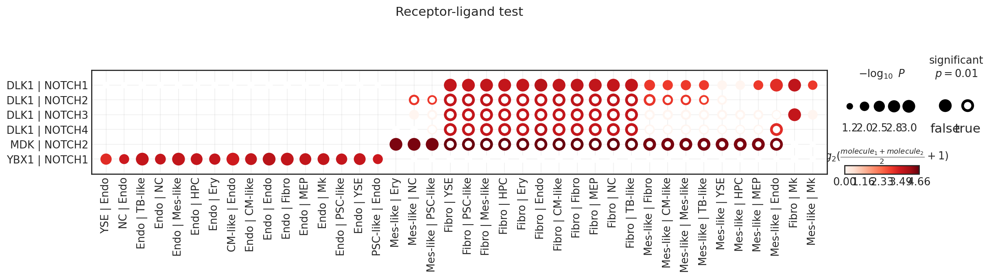

In [139]:


sq.pl.ligrec(__res, cluster_key="discrete_label_ct", 
             means_range=(6.5, np.inf), alpha=0.01, dendrogram='both', cmap='Reds',pvalue_threshold=0.01,
             remove_nonsig_interactions = True, remove_empty_interactions =True,
            swap_axes=False,
            )

Mes-like Ery


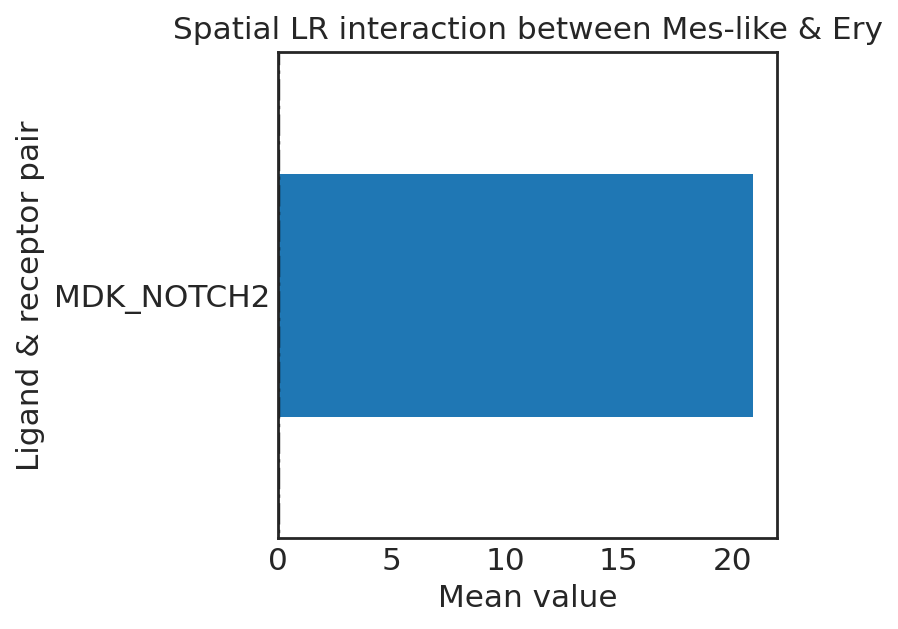

Mes-like MEP


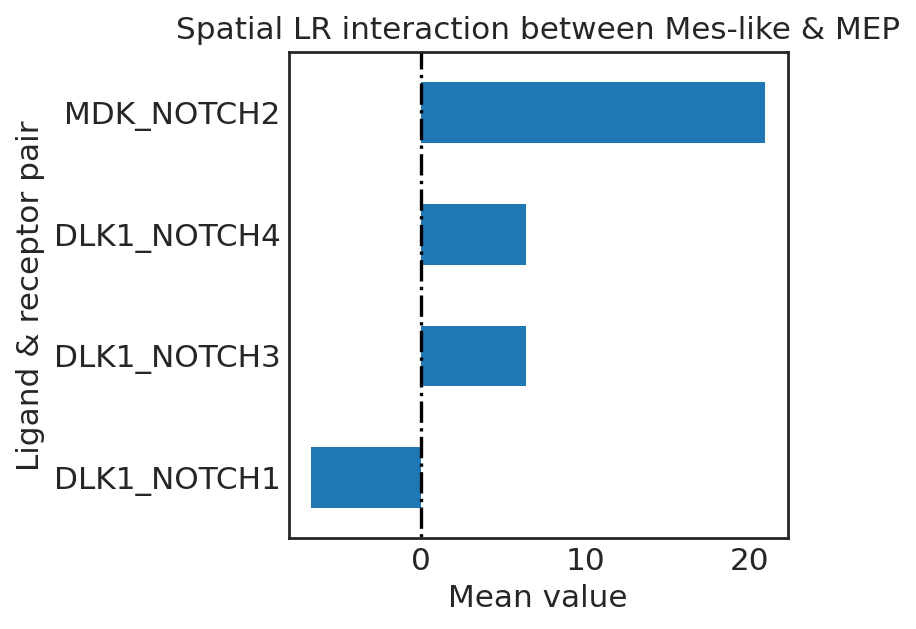

Mes-like YSE


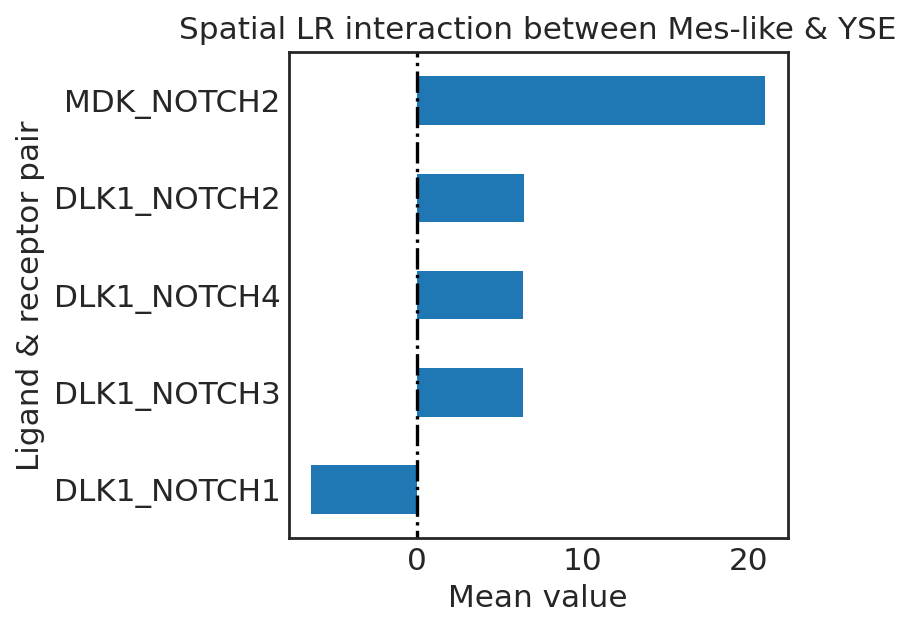

Fibro HPC


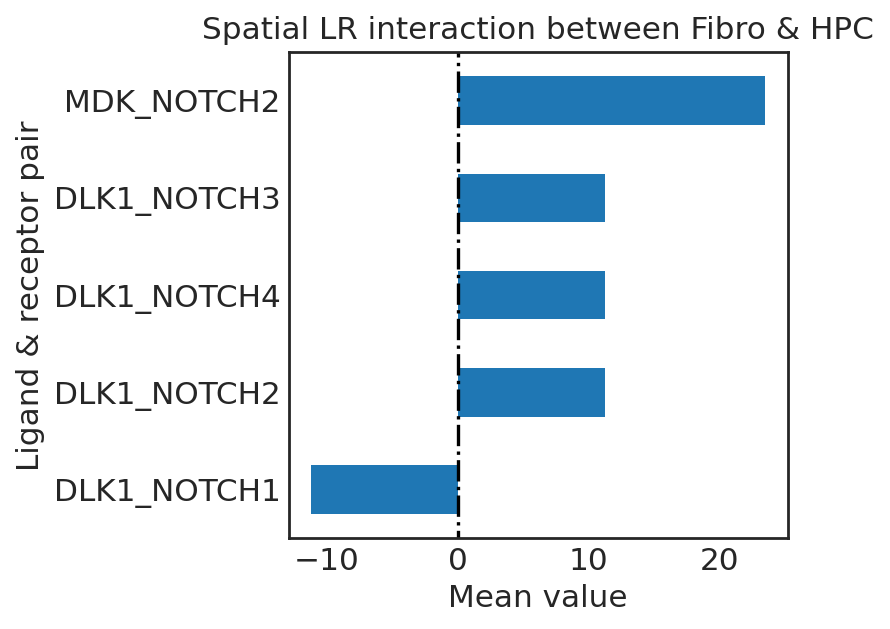

Fibro YSE


/tmp/ipykernel_3329556/2026538648.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_vtn_value.sort_values(_g2, axis=0, ascending=False,inplace=True)


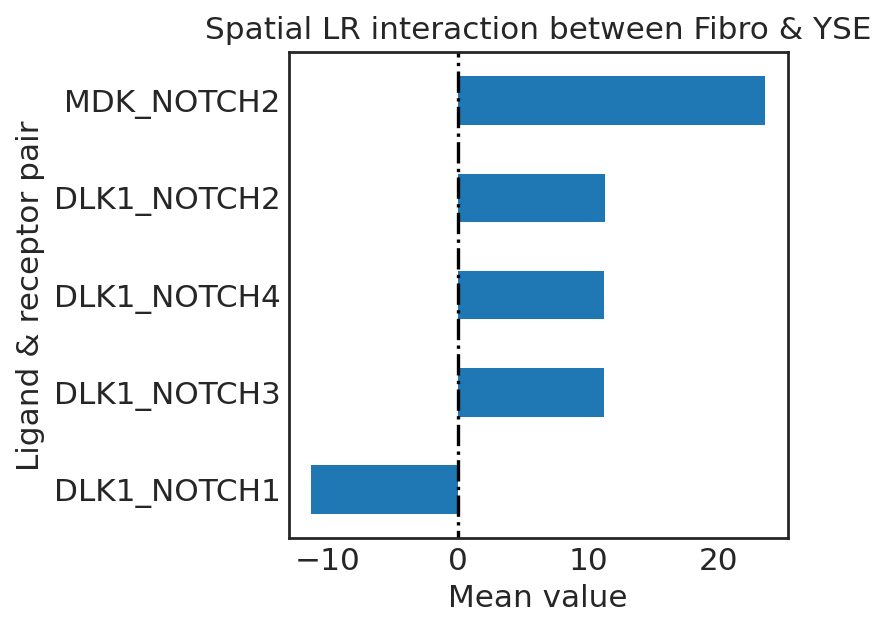

Mes-like Endo


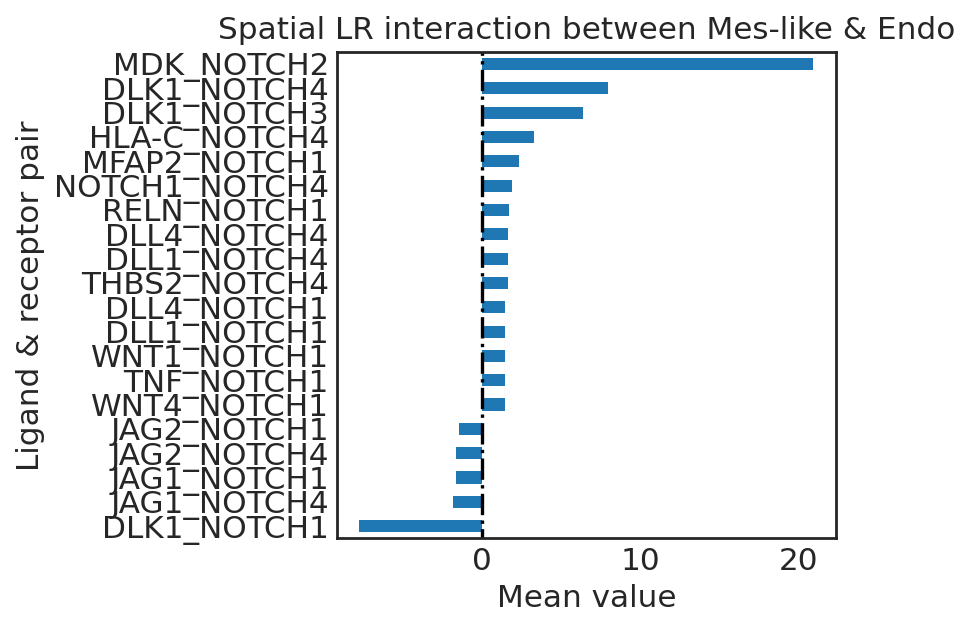

In [140]:
tar_t = [['Mes-like', 'Ery'], ['Mes-like', 'MEP'], ['Mes-like', 'YSE'], 
         ['Fibro', 'HPC'], ['Fibro', 'YSE'], ['Mes-like', 'Endo']]
for t in tar_t:
    _g1 = t[0]
    _g2 = t[1]
    print(_g1, _g2)
    # # extract df
    # _g1 = 'Fibro'
    # _g2 = 'HPC'
    
    # # _g1 = 'HPC'
    # # _g2 = 'Fibro'
    
    # _g1 = 'YSE'
    # _g2 = 'Endo'
    
    # _g1 = 'Mes-like'
    # _g2 = 'Endo'
    
    # _g1 = 'Endo'
    # _g2 = 'MEP'
    
    means_sou_tar = _res['means'][_g1].copy().reset_index()[['source','target',_g2]]
    means_sou_tar_p = _res['pvalues'][_g1].copy().reset_index()[['source','target',_g2]].rename(columns = {_g2: 'pvalues'})
    # df_vtn = means_sou_tar.query("`source` == 'DLK1'")
    
    # df_vtn = means_sou_tar[means_sou_tar['target'].str.contains("NOTCH")]
    
    means_sou_tar_m = pd.merge(means_sou_tar, means_sou_tar_p, how='left')
    df_vtn = means_sou_tar_m[(means_sou_tar_m['target'].str.contains("NOTCH")) & (means_sou_tar_m['pvalues']<0.01)][['source','target',_g2]]
    # df_vtn = means_sou_tar_m[(means_sou_tar_m['pvalues']<0.001)][['source','target',_g2]]

    df_vtn_value = df_vtn.query("`%s` >= 1" % (_g2) )
    df_vtn_value.sort_values(_g2, axis=0, ascending=False,inplace=True)
    
    df_vtn_value = pd.DataFrame(df_vtn_value.values, columns=['source','target',_g2] )
    
    lrdf = _res['metadata'].reset_index(level=[0,1]).copy()
    # df_vtn_pair = lrdf
    df_vtn_pair = lrdf[lrdf['target'].str.contains("NOTCH")]
    
    # df_vtn_pair = lrdf[lrdf['target'].str.contains("NOTCH") & (lrdf['database_intercell_source'].str.contains("CellPhoneDB") )]
    # df_vtn_pair = df_vtn_pair[df_vtn_pair['is_stimulation'] == False ]
    df_vtn_sort = pd.merge(df_vtn_value, df_vtn_pair[['source', 'target', 'is_inhibition']], on=['source', 'target'], how='inner')
    df_vtn_sort['condition_value'] = df_vtn_sort.apply(lambda x: x[_g2] if x['is_inhibition']==False else x[_g2]*-1, axis=1)
    df_vtn_sort['pair'] = df_vtn_sort['source'] + '_' + df_vtn_sort['target']
    df_vtn_result = df_vtn_sort[['pair', 'condition_value']].set_index('pair')
    df_vtn_result = df_vtn_result.sort_values(by='condition_value', ascending=True).copy()
    # df_vtn_result = df_vtn_result.drop_duplicates()
    df_vtn_result.shape
    
    
    
    fig, ax = plt.subplots(
        nrows=1,
        ncols=1,
        figsize=(4, 4),
    )
    df_vtn_result.plot.barh(legend=False, ax=ax)
    # plt.style.use('seaborn-white')
    # plt.rcParams["figure.figsize"] = (3, 3)
    plt.ylabel('Ligand & receptor pair')
    plt.xlabel('Mean value')
    plt.title('Spatial LR interaction between %s & %s' % (_g1, _g2))
    plt.vlines(0, -1, 35, colors='black', linestyles='-.')
    plt.show()

In [141]:
_sadata = c_adata.copy()
_sadata = _sadata[(_sadata.obs['hemo_label']=='hemo1') & (_sadata.obs['clone']=='clone2')]

# sadata.obs
res = sq.gr.ligrec(
    _sadata,
    cluster_key="discrete_label_ct",
    n_perms=1000,
    copy=True,
    use_raw=False,
    seed = 2025,
    transmitter_params={"categories": "ligand"},
    receiver_params={"categories": "receptor"},
)


df = res['pvalues']
print("Number of CellPhoneDB interactions (human data):", len(df))
df.head()

Fetching interactions from `omnipath`


/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


Fetched `10935` interactions
    Finish (0:00:04)
Running `1000` permutations on `3269` interactions and `81` cluster combinations using `1` core(s)


  0%|          | 0/1000 [00:00<?, ?permutation/s]

Finish (0:00:06)
Number of CellPhoneDB interactions (human data): 3269


cluster_1       Endo                                                      \
cluster_2       Endo    Ery    MEP Mes-like     Mk   Mono     NC NE-like   
source target                                                              
JAG2   NOTCH1    0.0  0.738   0.74      NaN  0.031  0.632  0.655     NaN   
DLL1   NOTCH1    0.0  0.799  0.823      NaN  0.043  0.671  0.723     NaN   
IGF1   IGF1R   0.153  0.101  0.223      NaN  0.093  0.333  0.207     NaN   
WNT1   NOTCH1    0.0  0.858  0.893      NaN  0.059  0.733  0.788     NaN   
JAG1   NOTCH1  0.001  0.488  0.422      NaN  0.015  0.429  0.443     NaN   

cluster_1               Ery  ... NE-like    YSE                                \
cluster_2        YSE   Endo  ...     YSE   Endo    Ery    MEP Mes-like     Mk   
source target                ...                                                
JAG2   NOTCH1  0.967  0.001  ...   0.997    0.0  0.835  0.856      NaN  0.048   
DLL1   NOTCH1  0.987    0.0  ...     NaN    0.0   0.86  0.893      NaN  0.058   
IGF1   IGF1R   0.144  0.023  ...   0.574  0.607  0.361  0.844      NaN  0.268   
WNT1   NOTCH1  0.998    0.0  ...   0.997    0.0  0.857  0.892      NaN  0.061   
JAG1   NOTCH1  0.661  0.001  ...   0.999  0.002  0.988   0.99      NaN  0.193   

cluster_1                                   
cluster_2       Mono     NC NE-like    YSE  
source target                               
JAG2   NOTCH1  0.706  0.757     NaN  0.992  
DLL1   NOTCH1  0.735  0.783     NaN  0.998  
IGF1   IGF1R   0.844  0.676     NaN  0.549  
WNT1   NOTCH1  0.731  0.783     NaN  0.999  
JAG1   NOTCH1  0.936  0.963     NaN    1.0  

[5 rows x 81 columns]

In [142]:
_res = res
__res = _res.copy()
_p1 = _res['means']
_idx = _p1.copy().reset_index()
__res['means'] = _p1.iloc[_idx['target'][(_idx['target'].str.contains("NOTCH")) | (_idx['source'].str.contains("NOTCH"))].index]
_p1 = _res['pvalues']
__res['pvalues'] = _p1.iloc[_idx['target'][(_idx['target'].str.contains("NOTCH")) | (_idx['source'].str.contains("NOTCH"))].index]

Found `35` significant interactions at level `0.01`


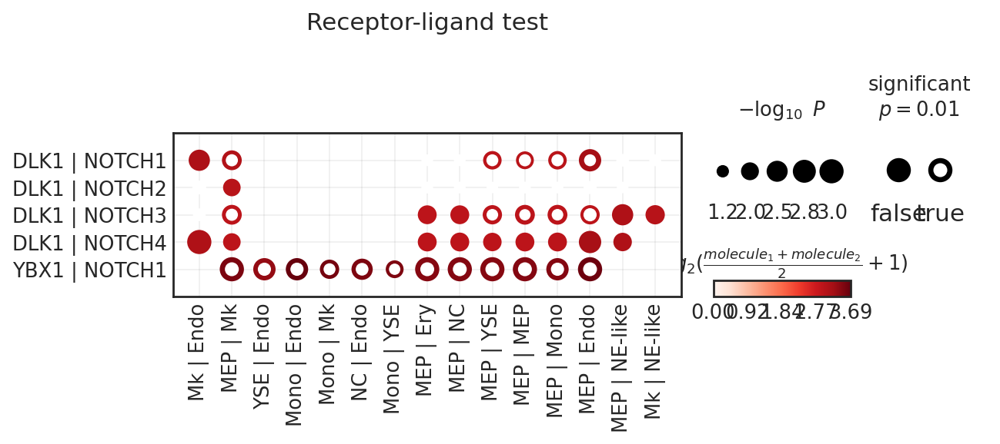

In [143]:


sq.pl.ligrec(__res, cluster_key="discrete_label_ct", 
             means_range=(6.5, np.inf), alpha=0.01, dendrogram='both', cmap='Reds',pvalue_threshold=0.01,
             remove_nonsig_interactions = True, remove_empty_interactions =True,
            swap_axes=False,
            )

Mk Endo


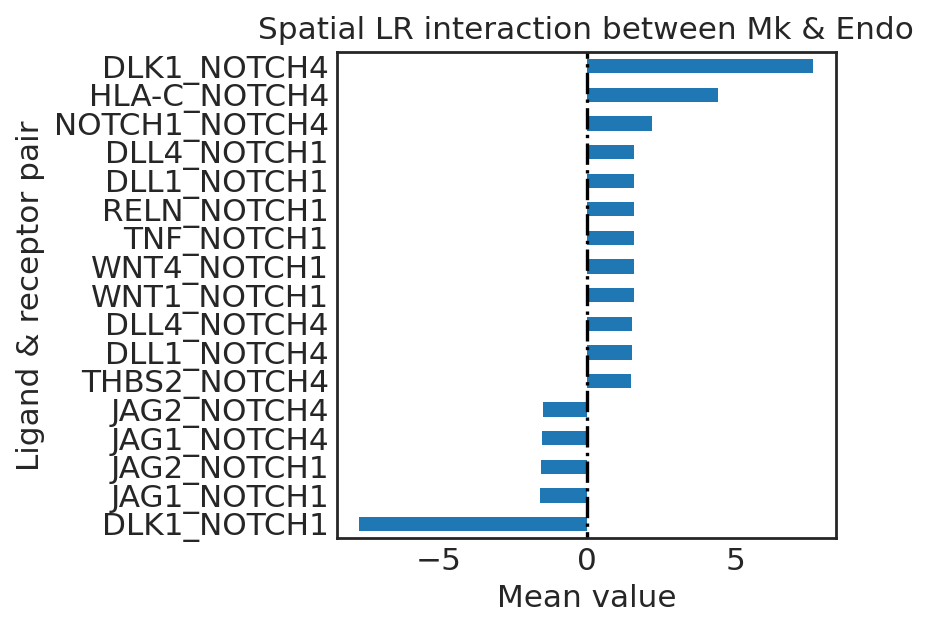

MEP Mk


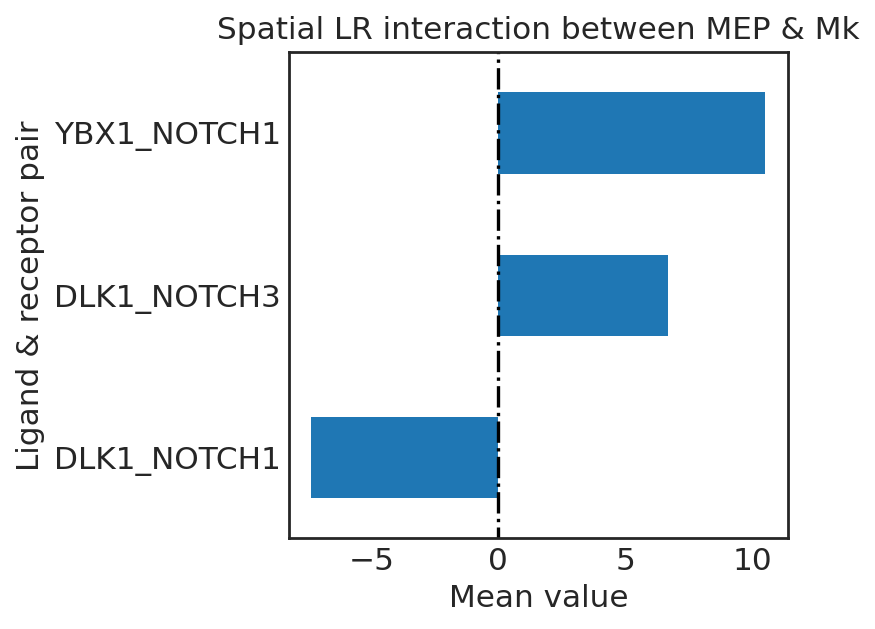

YSE Endo


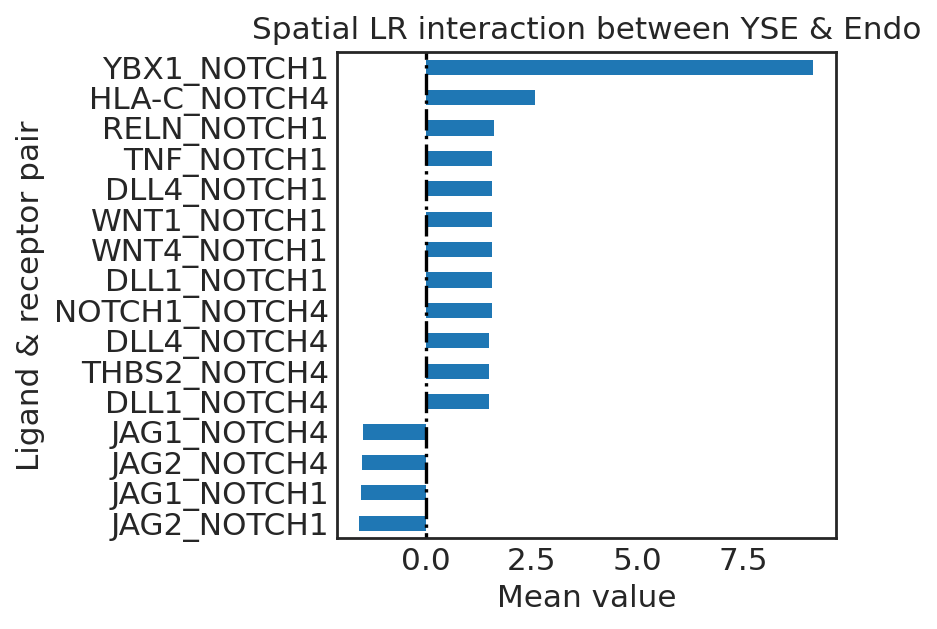

MEP Endo


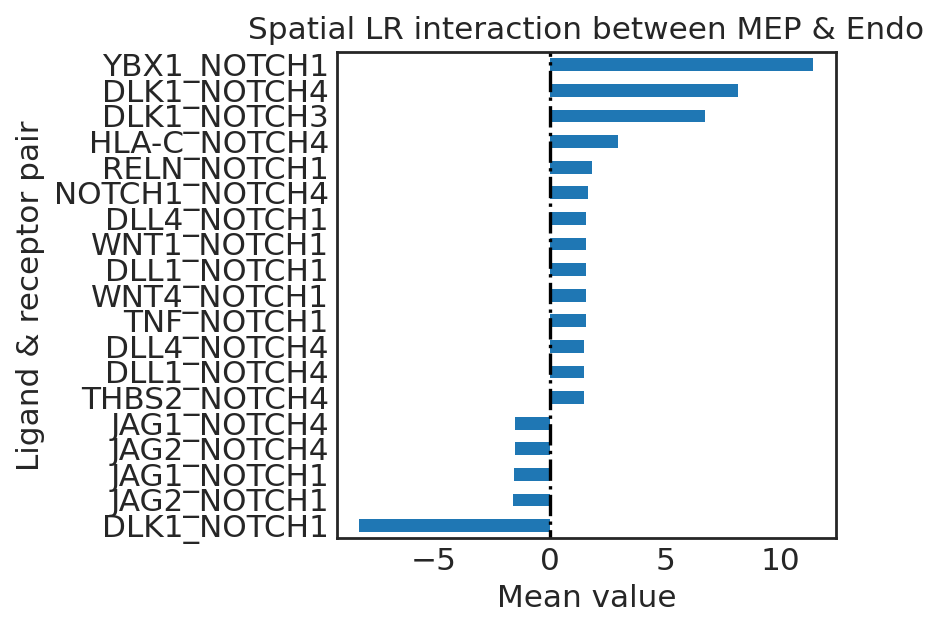

In [144]:
tar_t = [['Mk', 'Endo'], ['MEP', 'Mk'], ['YSE', 'Endo'], ['MEP', 'Endo']]
for t in tar_t:
    _g1 = t[0]
    _g2 = t[1]
    print(_g1, _g2)
    means_sou_tar = _res['means'][_g1].copy().reset_index()[['source','target',_g2]]
    means_sou_tar_p = _res['pvalues'][_g1].copy().reset_index()[['source','target',_g2]].rename(columns = {_g2: 'pvalues'})
    # df_vtn = means_sou_tar.query("`source` == 'DLK1'")
    
    # df_vtn = means_sou_tar[means_sou_tar['target'].str.contains("NOTCH")]
    
    means_sou_tar_m = pd.merge(means_sou_tar, means_sou_tar_p, how='left')
    df_vtn = means_sou_tar_m[(means_sou_tar_m['target'].str.contains("NOTCH")) & (means_sou_tar_m['pvalues']<0.01)][['source','target',_g2]]
    # df_vtn = means_sou_tar_m[(means_sou_tar_m['pvalues']<0.001)][['source','target',_g2]]

    df_vtn_value = df_vtn.query("`%s` >= 1" % (_g2) )
    df_vtn_value.sort_values(_g2, axis=0, ascending=False,inplace=True)
    
    df_vtn_value = pd.DataFrame(df_vtn_value.values, columns=['source','target',_g2] )
    
    lrdf = _res['metadata'].reset_index(level=[0,1]).copy()
    # df_vtn_pair = lrdf
    df_vtn_pair = lrdf[lrdf['target'].str.contains("NOTCH")]
    
    # df_vtn_pair = lrdf[lrdf['target'].str.contains("NOTCH") & (lrdf['database_intercell_source'].str.contains("CellPhoneDB") )]
    # df_vtn_pair = df_vtn_pair[df_vtn_pair['is_stimulation'] == False ]
    df_vtn_sort = pd.merge(df_vtn_value, df_vtn_pair[['source', 'target', 'is_inhibition']], on=['source', 'target'], how='inner')
    df_vtn_sort['condition_value'] = df_vtn_sort.apply(lambda x: x[_g2] if x['is_inhibition']==False else x[_g2]*-1, axis=1)
    df_vtn_sort['pair'] = df_vtn_sort['source'] + '_' + df_vtn_sort['target']
    df_vtn_result = df_vtn_sort[['pair', 'condition_value']].set_index('pair')
    df_vtn_result = df_vtn_result.sort_values(by='condition_value', ascending=True).copy()
    # df_vtn_result = df_vtn_result.drop_duplicates()
    df_vtn_result.shape
    
    
    
    fig, ax = plt.subplots(
        nrows=1,
        ncols=1,
        figsize=(4, 4),
    )
    df_vtn_result.plot.barh(legend=False, ax=ax)
    # plt.style.use('seaborn-white')
    # plt.rcParams["figure.figsize"] = (3, 3)
    plt.ylabel('Ligand & receptor pair')
    plt.xlabel('Mean value')
    plt.title('Spatial LR interaction between %s & %s' % (_g1, _g2))
    plt.vlines(0, -1, 35, colors='black', linestyles='-.')
    plt.show()

In [284]:
_tar_cell = 'hemo5'
_tar_clone = 'clone1'

In [285]:
_sadata = c_adata.copy()
_sadata = _sadata[(_sadata.obs['hemo_label']==_tar_cell) & (_sadata.obs['clone']==_tar_clone)]

# sadata.obs
res = sq.gr.ligrec(
    _sadata,
    cluster_key="discrete_label_ct",
    n_perms=1000,
    copy=True,
    use_raw=False,
    seed = 2025,
    transmitter_params={"categories": "ligand"},
    receiver_params={"categories": "receptor"},
)


df = res['pvalues']
print("Number of CellPhoneDB interactions (human data):", len(df))
df.head()




Fetching interactions from `omnipath`
Fetched `10935` interactions
    Finish (0:00:05)
Running `1000` permutations on `3268` interactions and `81` cluster combinations using `1` core(s)


  0%|          | 0/1000 [00:00<?, ?permutation/s]

Finish (0:00:05)
Number of CellPhoneDB interactions (human data): 3268


cluster_1     CM-like                                                        \
cluster_2     CM-like   Endo  Fibro Mes-like     Mk   Mono PSC-like TB-like   
source target                                                                 
JAG2   NOTCH1   0.182  0.121  0.015    0.208  0.575  0.223    0.948   0.336   
DLL1   NOTCH1   0.229  0.128   0.02    0.219  0.762  0.255      1.0   0.393   
IGF1   IGF1R    0.177  0.477  0.144    0.862  0.125    NaN    0.359    0.66   
WNT1   NOTCH1   0.203  0.126  0.013    0.216  0.612  0.236      1.0   0.366   
JAG1   NOTCH1   0.273  0.124  0.043    0.228  0.685  0.234    0.933    0.38   

cluster_1               Endo  ... TB-like     YSE                         \
cluster_2        YSE CM-like  ...     YSE CM-like   Endo  Fibro Mes-like   
source target                 ...                                          
JAG2   NOTCH1  0.998   0.036  ...     1.0   0.237  0.126  0.029    0.229   
DLL1   NOTCH1    1.0     NaN  ...   0.998   0.219  0.124  0.017    0.225   
IGF1   IGF1R   0.941     NaN  ...   0.738   0.421  0.663  0.468    0.996   
WNT1   NOTCH1    1.0     NaN  ...     1.0   0.203  0.125  0.013    0.216   
JAG1   NOTCH1  0.987    0.22  ...    0.96   0.678    0.2  0.352    0.407   

cluster_1                                            
cluster_2         Mk   Mono PSC-like TB-like    YSE  
source target                                        
JAG2   NOTCH1  0.792  0.245    0.985   0.401  0.999  
DLL1   NOTCH1  0.773  0.241    0.999   0.386    1.0  
IGF1   IGF1R   0.184    NaN    0.654   0.945  0.999  
WNT1   NOTCH1  0.604   0.24    0.999   0.366    1.0  
JAG1   NOTCH1    1.0   0.31      1.0   0.811    1.0  

[5 rows x 81 columns]

Found `58` significant interactions at level `0.01`


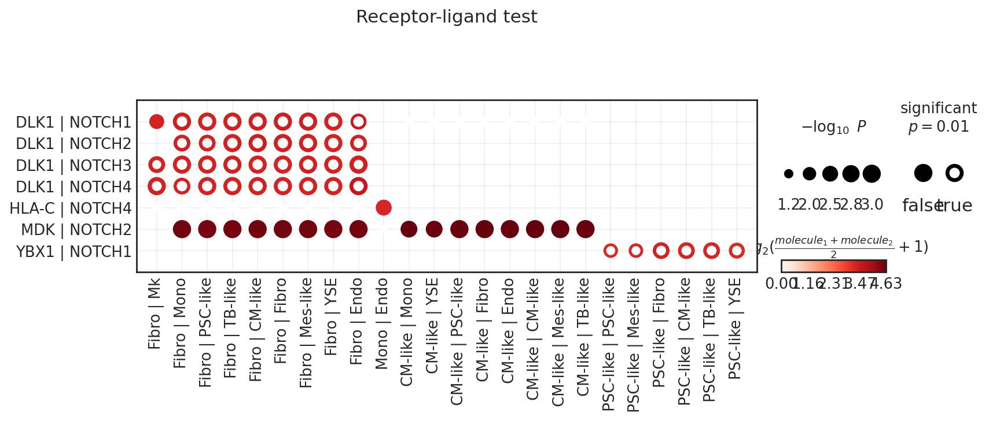

In [288]:
_res = res
__res = _res.copy()
_p1 = _res['means']
_idx = _p1.copy().reset_index()
__res['means'] = _p1.iloc[_idx['target'][(_idx['target'].str.contains("NOTCH")) | (_idx['source'].str.contains("NOTCH"))].index]
_p1 = _res['pvalues']
__res['pvalues'] = _p1.iloc[_idx['target'][(_idx['target'].str.contains("NOTCH")) | (_idx['source'].str.contains("NOTCH"))].index]

# sq.pl.ligrec(_res, cluster_key="discrete_label_ct", 
#              means_range=(6.5, np.inf), alpha=0.001, dendrogram='both', cmap='Reds',pvalue_threshold=0.001,
#              remove_nonsig_interactions = True, remove_empty_interactions =True,
#             swap_axes=False,
#             )


sq.pl.ligrec(__res, cluster_key="discrete_label_ct", 
             means_range=(6.5, np.inf), alpha=0.01, dendrogram='both', cmap='Reds',pvalue_threshold=0.01,
             remove_nonsig_interactions = True, remove_empty_interactions =True,
            swap_axes=False,
            )

Fibro PSC-like


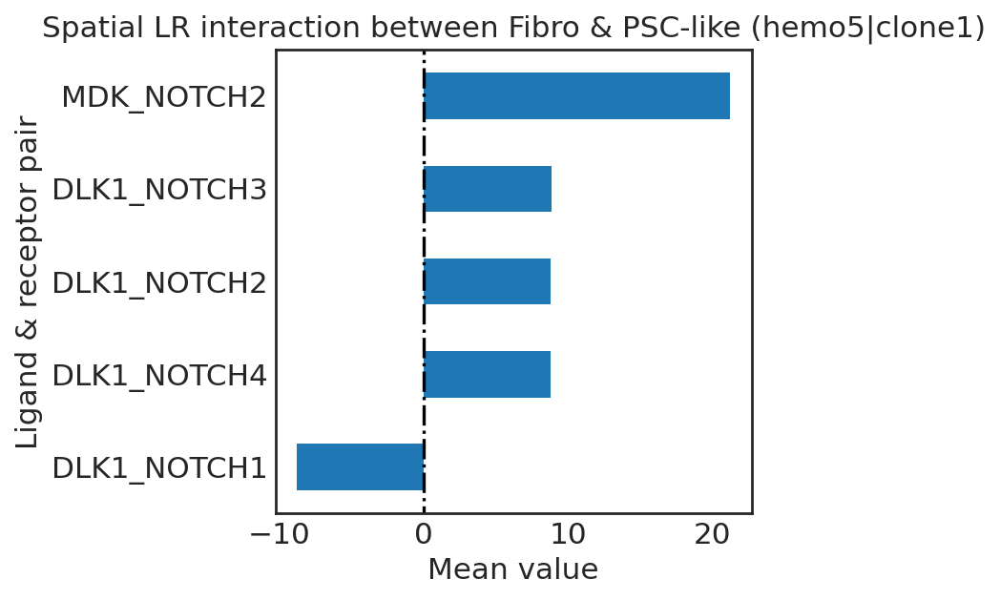

Fibro YSE


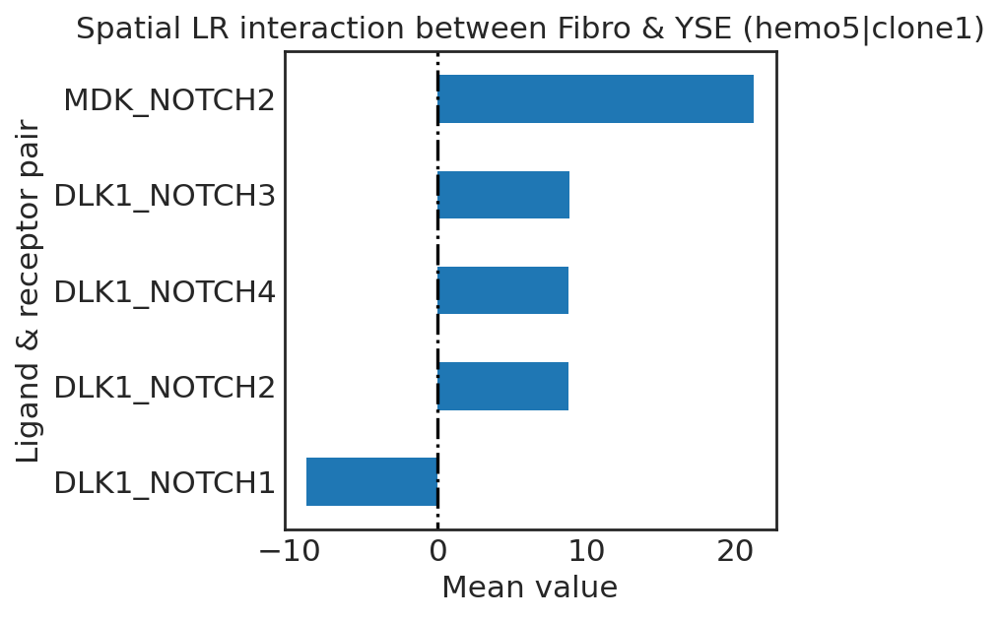

PSC-like Fibro


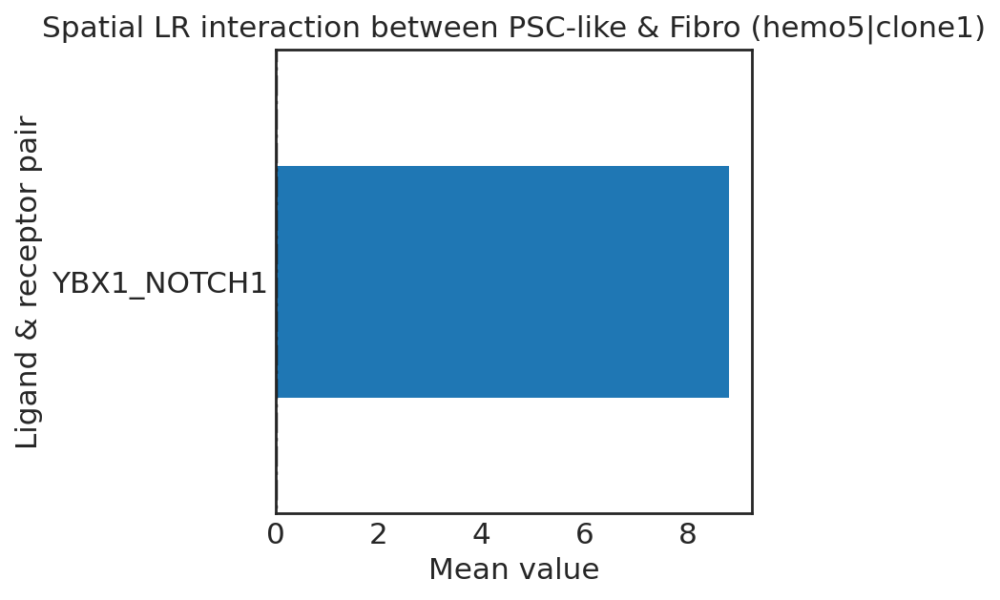

In [289]:
tar_t = [['Fibro', 'PSC-like'], ['Fibro', 'YSE'], ['PSC-like', 'Fibro']]
for t in tar_t:
    _g1 = t[0]
    _g2 = t[1]
    print(_g1, _g2)
    means_sou_tar = _res['means'][_g1].copy().reset_index()[['source','target',_g2]]
    means_sou_tar_p = _res['pvalues'][_g1].copy().reset_index()[['source','target',_g2]].rename(columns = {_g2: 'pvalues'})
    # df_vtn = means_sou_tar.query("`source` == 'DLK1'")
    
    # df_vtn = means_sou_tar[means_sou_tar['target'].str.contains("NOTCH")]
    
    means_sou_tar_m = pd.merge(means_sou_tar, means_sou_tar_p, how='left')
    df_vtn = means_sou_tar_m[(means_sou_tar_m['target'].str.contains("NOTCH")) & (means_sou_tar_m['pvalues']<0.01)][['source','target',_g2]]
    # df_vtn = means_sou_tar_m[(means_sou_tar_m['pvalues']<0.001)][['source','target',_g2]]

    df_vtn_value = df_vtn.query("`%s` >= 1" % (_g2) )
    df_vtn_value.sort_values(_g2, axis=0, ascending=False,inplace=True)
    
    df_vtn_value = pd.DataFrame(df_vtn_value.values, columns=['source','target',_g2] )
    
    lrdf = _res['metadata'].reset_index(level=[0,1]).copy()
    # df_vtn_pair = lrdf
    df_vtn_pair = lrdf[lrdf['target'].str.contains("NOTCH")]
    
    # df_vtn_pair = lrdf[lrdf['target'].str.contains("NOTCH") & (lrdf['database_intercell_source'].str.contains("CellPhoneDB") )]
    # df_vtn_pair = df_vtn_pair[df_vtn_pair['is_stimulation'] == False ]
    df_vtn_sort = pd.merge(df_vtn_value, df_vtn_pair[['source', 'target', 'is_inhibition']], on=['source', 'target'], how='inner')
    df_vtn_sort['condition_value'] = df_vtn_sort.apply(lambda x: x[_g2] if x['is_inhibition']==False else x[_g2]*-1, axis=1)
    df_vtn_sort['pair'] = df_vtn_sort['source'] + '_' + df_vtn_sort['target']
    df_vtn_result = df_vtn_sort[['pair', 'condition_value']].set_index('pair')
    df_vtn_result = df_vtn_result.sort_values(by='condition_value', ascending=True).copy()
    # df_vtn_result = df_vtn_result.drop_duplicates()
    df_vtn_result.shape
    
    
    
    fig, ax = plt.subplots(
        nrows=1,
        ncols=1,
        figsize=(4, 4),
    )
    df_vtn_result.plot.barh(legend=False, ax=ax)
    # plt.style.use('seaborn-white')
    # plt.rcParams["figure.figsize"] = (3, 3)
    plt.ylabel('Ligand & receptor pair')
    plt.xlabel('Mean value')
    plt.title('Spatial LR interaction between %s & %s (%s|%s)' % (_g1, _g2, _tar_cell, _tar_clone))
    plt.vlines(0, -1, 35, colors='black', linestyles='-.')
    plt.show()

YSE PSC-like


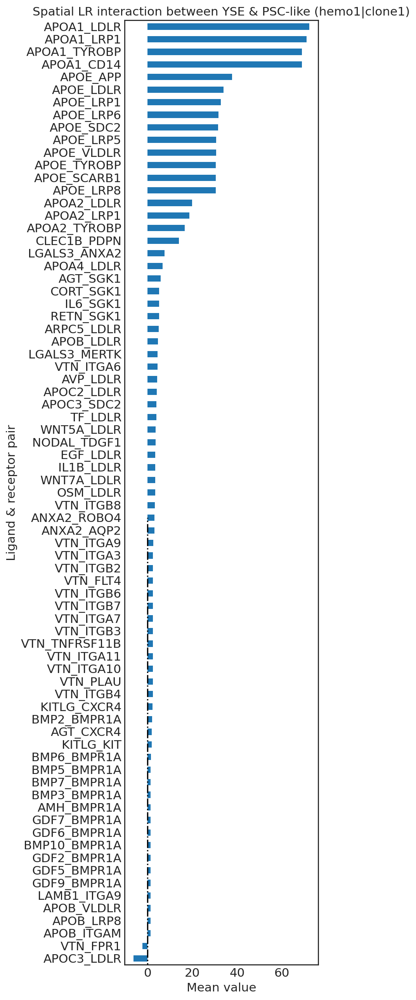

In [283]:
tar_t = [['YSE', 'PSC-like']]
for t in tar_t:
    _g1 = t[0]
    _g2 = t[1]
    print(_g1, _g2)
    means_sou_tar = _res['means'][_g1].copy().reset_index()[['source','target',_g2]]
    means_sou_tar_p = _res['pvalues'][_g1].copy().reset_index()[['source','target',_g2]].rename(columns = {_g2: 'pvalues'})
    # df_vtn = means_sou_tar.query("`source` == 'DLK1'")
    
    # df_vtn = means_sou_tar[means_sou_tar['target'].str.contains("NOTCH")]
    
    means_sou_tar_m = pd.merge(means_sou_tar, means_sou_tar_p, how='left')
    # df_vtn = means_sou_tar_m[(means_sou_tar_m['target'].str.contains("NOTCH")) & (means_sou_tar_m['pvalues']<0.01)][['source','target',_g2]]
    df_vtn = means_sou_tar_m[(means_sou_tar_m['pvalues']<0.001)][['source','target',_g2]]

    df_vtn_value = df_vtn.query("`%s` >= 1" % (_g2) )
    df_vtn_value.sort_values(_g2, axis=0, ascending=False,inplace=True)
    
    df_vtn_value = pd.DataFrame(df_vtn_value.values, columns=['source','target',_g2] )
    
    lrdf = _res['metadata'].reset_index(level=[0,1]).copy()
    df_vtn_pair = lrdf
    # df_vtn_pair = lrdf[lrdf['target'].str.contains("NOTCH")]
    
    # df_vtn_pair = lrdf[lrdf['target'].str.contains("NOTCH") & (lrdf['database_intercell_source'].str.contains("CellPhoneDB") )]
    # df_vtn_pair = df_vtn_pair[df_vtn_pair['is_stimulation'] == False ]
    df_vtn_sort = pd.merge(df_vtn_value, df_vtn_pair[['source', 'target', 'is_inhibition']], on=['source', 'target'], how='inner')
    df_vtn_sort['condition_value'] = df_vtn_sort.apply(lambda x: x[_g2] if x['is_inhibition']==False else x[_g2]*-1, axis=1)
    df_vtn_sort['pair'] = df_vtn_sort['source'] + '_' + df_vtn_sort['target']
    df_vtn_result = df_vtn_sort[['pair', 'condition_value']].set_index('pair')
    df_vtn_result = df_vtn_result.sort_values(by='condition_value', ascending=True).copy()
    # df_vtn_result = df_vtn_result.drop_duplicates()
    df_vtn_result.shape
    
    
    
    fig, ax = plt.subplots(
        nrows=1,
        ncols=1,
        figsize=(4, 20),
    )
    df_vtn_result.plot.barh(legend=False, ax=ax)
    # plt.style.use('seaborn-white')
    # plt.rcParams["figure.figsize"] = (3, 3)
    plt.ylabel('Ligand & receptor pair')
    plt.xlabel('Mean value')
    plt.title('Spatial LR interaction between %s & %s (%s|%s)' % (_g1, _g2, _tar_cell, _tar_clone))
    plt.vlines(0, -1, 35, colors='black', linestyles='-.')
    plt.show()

In [ ]:
# extract df
_g1 = 'Fibro'
_g2 = 'HPC'

# _g1 = 'HPC'
# _g2 = 'Fibro'

_g1 = 'YSE'
_g2 = 'Endo'

# _g1 = 'Mes-like'
# _g2 = 'Endo'

# _g1 = 'Endo'
# _g2 = 'MEP'

means_sou_tar = __res['means'][_g1].copy().reset_index()[['source','target',_g2]]
means_sou_tar_p = __res['pvalues'][_g1].copy().reset_index()[['source','target',_g2]].rename(columns = {_g2: 'pvalues'})
# df_vtn = means_sou_tar.query("`source` == 'DLK1'")

# df_vtn = means_sou_tar[means_sou_tar['target'].str.contains("NOTCH")]

means_sou_tar_m = pd.merge(means_sou_tar, means_sou_tar_p, how='left')
df_vtn = means_sou_tar_m[(means_sou_tar_m['target'].str.contains("NOTCH")) & (means_sou_tar_m['pvalues']<0.001)][['source','target',_g2]]
# df_vtn = means_sou_tar_m[(means_sou_tar_m['target'].str.contains("NOTCH")) ][['source','target',_g2]]
# df_vtn = means_sou_tar[means_sou_tar['target'].str.contains("NOTCH")]
df_vtn_value = df_vtn.query("`%s` >= 1" % (_g2) )
df_vtn_value.sort_values(_g2, axis=0, ascending=False,inplace=True)

df_vtn_value = pd.DataFrame(df_vtn_value.values, columns=['source','target',_g2] )

lrdf = _res['metadata'].reset_index(level=[0,1]).copy()
# df_vtn_pair = lrdf.query("`source` == 'DLK1'")
df_vtn_pair = lrdf[lrdf['target'].str.contains("NOTCH")]
# df_vtn_pair = lrdf[lrdf['target'].str.contains("NOTCH") & (lrdf['database_intercell_source'].str.contains("CellPhoneDB") )]
# df_vtn_pair = df_vtn_pair[df_vtn_pair['is_stimulation'] == False ]
df_vtn_sort = pd.merge(df_vtn_value, df_vtn_pair[['source', 'target', 'is_inhibition']], on=['source', 'target'], how='inner')
df_vtn_sort['condition_value'] = df_vtn_sort.apply(lambda x: x[_g2] if x['is_inhibition']==False else x[_g2]*-1, axis=1)
df_vtn_sort['pair'] = df_vtn_sort['source'] + '_' + df_vtn_sort['target']
df_vtn_result = df_vtn_sort[['pair', 'condition_value']].set_index('pair')
df_vtn_result = df_vtn_result.sort_values(by='condition_value', ascending=True).copy()
# df_vtn_result = df_vtn_result.drop_duplicates()
df_vtn_result.shape



fig, ax = plt.subplots(
    nrows=1,
    ncols=1,
    figsize=(4, 4),
)
df_vtn_result.plot.barh(legend=False, ax=ax)
# plt.style.use('seaborn-white')
# plt.rcParams["figure.figsize"] = (3, 3)
plt.ylabel('Ligand & receptor pair')
plt.xlabel('Mean value')
plt.title('Spatial LR interaction between %s & %s' % (_g1, _g2))
plt.vlines(0, -1, 35, colors='black', linestyles='-.')
plt.show()

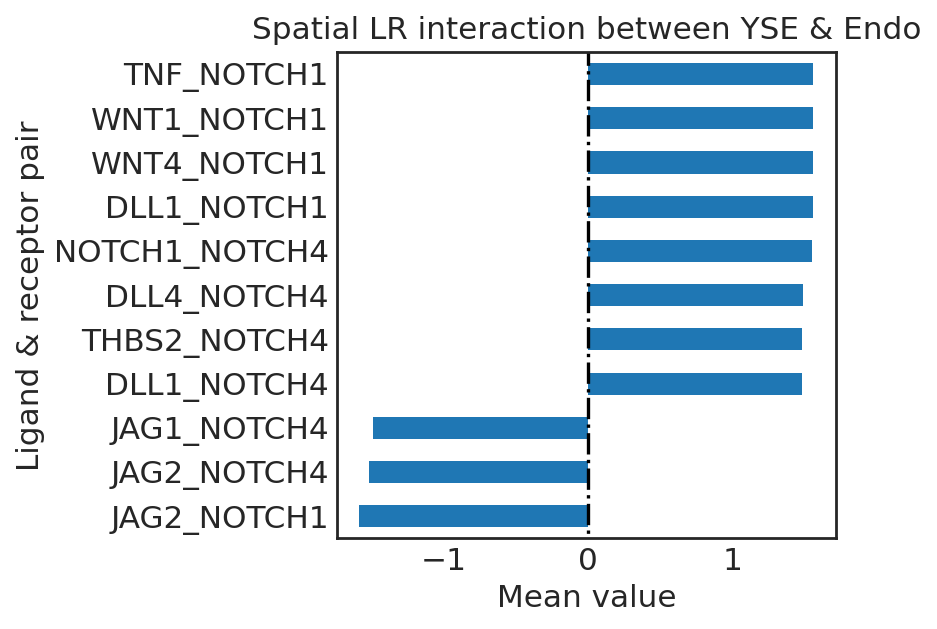

In [83]:
# extract df
_g1 = 'Fibro'
_g2 = 'HPC'

# _g1 = 'HPC'
# _g2 = 'Fibro'

_g1 = 'YSE'
_g2 = 'Endo'

# _g1 = 'Mes-like'
# _g2 = 'Endo'

# _g1 = 'Endo'
# _g2 = 'MEP'

means_sou_tar = __res['means'][_g1].copy().reset_index()[['source','target',_g2]]
means_sou_tar_p = __res['pvalues'][_g1].copy().reset_index()[['source','target',_g2]].rename(columns = {_g2: 'pvalues'})
# df_vtn = means_sou_tar.query("`source` == 'DLK1'")

# df_vtn = means_sou_tar[means_sou_tar['target'].str.contains("NOTCH")]

means_sou_tar_m = pd.merge(means_sou_tar, means_sou_tar_p, how='left')
df_vtn = means_sou_tar_m[(means_sou_tar_m['target'].str.contains("NOTCH")) & (means_sou_tar_m['pvalues']<0.001)][['source','target',_g2]]
# df_vtn = means_sou_tar_m[(means_sou_tar_m['target'].str.contains("NOTCH")) ][['source','target',_g2]]
# df_vtn = means_sou_tar[means_sou_tar['target'].str.contains("NOTCH")]
df_vtn_value = df_vtn.query("`%s` >= 1" % (_g2) )
df_vtn_value.sort_values(_g2, axis=0, ascending=False,inplace=True)

df_vtn_value = pd.DataFrame(df_vtn_value.values, columns=['source','target',_g2] )

lrdf = _res['metadata'].reset_index(level=[0,1]).copy()
# df_vtn_pair = lrdf.query("`source` == 'DLK1'")
df_vtn_pair = lrdf[lrdf['target'].str.contains("NOTCH")]
# df_vtn_pair = lrdf[lrdf['target'].str.contains("NOTCH") & (lrdf['database_intercell_source'].str.contains("CellPhoneDB") )]
# df_vtn_pair = df_vtn_pair[df_vtn_pair['is_stimulation'] == False ]
df_vtn_sort = pd.merge(df_vtn_value, df_vtn_pair[['source', 'target', 'is_inhibition']], on=['source', 'target'], how='inner')
df_vtn_sort['condition_value'] = df_vtn_sort.apply(lambda x: x[_g2] if x['is_inhibition']==False else x[_g2]*-1, axis=1)
df_vtn_sort['pair'] = df_vtn_sort['source'] + '_' + df_vtn_sort['target']
df_vtn_result = df_vtn_sort[['pair', 'condition_value']].set_index('pair')
df_vtn_result = df_vtn_result.sort_values(by='condition_value', ascending=True).copy()
# df_vtn_result = df_vtn_result.drop_duplicates()
df_vtn_result.shape



fig, ax = plt.subplots(
    nrows=1,
    ncols=1,
    figsize=(4, 4),
)
df_vtn_result.plot.barh(legend=False, ax=ax)
# plt.style.use('seaborn-white')
# plt.rcParams["figure.figsize"] = (3, 3)
plt.ylabel('Ligand & receptor pair')
plt.xlabel('Mean value')
plt.title('Spatial LR interaction between %s & %s' % (_g1, _g2))
plt.vlines(0, -1, 35, colors='black', linestyles='-.')
plt.show()

In [ ]:
# sq.pl.ligrec(res, cluster_key="discrete_label_ct", source_groups=['HPC'], 
# sq.pl.ligrec(_res, cluster_key="discrete_label_ct", source_groups=['Fibro'], target_groups=['HPC'],
sq.pl.ligrec(_res, cluster_key="discrete_label_ct", source_groups=['Fibro'], target_groups=['HPC'],
# sq.pl.ligrec(_res, cluster_key="discrete_label_ct", source_groups=['NC'], target_groups=['YSE'],
             means_range=(6.5, np.inf), alpha=0.001, dendrogram='both', cmap='Reds',
             remove_nonsig_interactions = True, 
            swap_axes=True,
            )

In [147]:
_sadata = c_adata.copy()
_sadata = _sadata[(_sadata.obs['hemo_label']=='hemo1') & (_sadata.obs['clone']=='clone2')]
# _sadata = _sadata[(_sadata.obs['hemo_label']=='hemo5') & (_sadata.obs['clone']=='clone2')]
# _sadata = _sadata[(_sadata.obs['hemo_label']=='hemo1')]
# _sadata = _sadata[_sadata.obs['discrete_label_ct'].isin(['Ery', 'Mk', 'MEP', 'MP-1', 'MP-2', 'Mono', 'Endo', 'YSE'])]
# _sadata.obs.index = range(len(_sadata.obs.index))
# # print(c_adata.obs.shape, sadata.obs.shape)
# _sadata.obs['discrete_label_ct'].isin(['Ery', 'Mk', 'MEP', 'MP-1', 'MP-2', 'Mono', 'Endo', 'YSE'])
# sadata.obs
res = sq.gr.ligrec(
    _sadata,
    cluster_key="discrete_label_ct",
    n_perms=1000,
    copy=True,
    use_raw=False,
    seed = 42,
    transmitter_params={"categories": "ligand"},
    receiver_params={"categories": "receptor"},
)

# res = sp.gr.ligrec(c_adata, "discrete_label_ct",
#  fdr_method=None, copy=True,
#  interactions_params={"resources": "CellPhoneDB"},
#  threshold=0.1, seed=0, n_perms=10000, n_jobs=1)
df = res['pvalues']
print("Number of CellPhoneDB interactions (human data):", len(df))
df.head()

Fetching interactions from `omnipath`


/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


Fetched `10935` interactions
    Finish (0:00:03)
Running `1000` permutations on `3269` interactions and `81` cluster combinations using `1` core(s)


  0%|          | 0/1000 [00:00<?, ?permutation/s]

Finish (0:00:05)
Number of CellPhoneDB interactions (human data): 3269


cluster_1       Endo                                                      \
cluster_2       Endo    Ery    MEP Mes-like     Mk   Mono     NC NE-like   
source target                                                              
JAG2   NOTCH1    0.0  0.738  0.735      NaN  0.035  0.637  0.647     NaN   
DLL1   NOTCH1    0.0  0.795  0.814      NaN  0.046  0.685   0.71     NaN   
IGF1   IGF1R   0.182  0.112  0.247      NaN  0.084  0.326    0.2     NaN   
WNT1   NOTCH1    0.0  0.852  0.896      NaN   0.06  0.746  0.778     NaN   
JAG1   NOTCH1    0.0  0.466  0.438      NaN  0.012  0.419  0.418     NaN   

cluster_1               Ery  ... NE-like    YSE                                \
cluster_2        YSE   Endo  ...     YSE   Endo    Ery    MEP Mes-like     Mk   
source target                ...                                                
JAG2   NOTCH1  0.976    0.0  ...   0.997    0.0  0.828  0.872      NaN  0.054   
DLL1   NOTCH1  0.991    0.0  ...     NaN    0.0  0.858  0.893      NaN  0.059   
IGF1   IGF1R   0.149  0.016  ...   0.597  0.596  0.338  0.818      NaN  0.278   
WNT1   NOTCH1  0.997    0.0  ...   0.997    0.0  0.853  0.892      NaN  0.059   
JAG1   NOTCH1  0.656  0.001  ...   0.998    0.0  0.991   0.99      NaN  0.178   

cluster_1                                   
cluster_2       Mono     NC NE-like    YSE  
source target                               
JAG2   NOTCH1  0.719  0.744     NaN  0.993  
DLL1   NOTCH1  0.745  0.778     NaN  0.997  
IGF1   IGF1R   0.828  0.672     NaN  0.553  
WNT1   NOTCH1  0.747  0.776     NaN  0.997  
JAG1   NOTCH1  0.951  0.964     NaN    1.0  

[5 rows x 81 columns]

In [148]:
res_h1 = res
_res = res_h1

In [58]:
_res = res

In [50]:
_res = {}
_res['means'] = pd.read_csv('adata_frag5_clone1-means.csv', index_col = [0, 1], header=[0,1])
_res['pvalues'] = pd.read_csv('adata_frag5_clone1-pvalues.csv', index_col = [0, 1], header=[0,1])
_res['metadata'] = pd.read_csv('adata_frag5_clone1-metadata.csv', index_col = [0, 1], header=[0])

In [51]:
# pd.read_csv('adata_frag5_clone1-metadata.csv', index_col = [0, 1], header=[0])

In [70]:
# sq.pl.ligrec(res, cluster_key="discrete_label_ct", source_groups=['HPC'], 
# sq.pl.ligrec(_res, cluster_key="discrete_label_ct", source_groups=['Fibro'], target_groups=['HPC'],
sq.pl.ligrec(_res, cluster_key="discrete_label_ct", source_groups=['Fibro'], target_groups=['HPC'],
# sq.pl.ligrec(_res, cluster_key="discrete_label_ct", source_groups=['NC'], target_groups=['YSE'],
             means_range=(6.5, np.inf), alpha=0.001, dendrogram='both', cmap='Reds',
             remove_nonsig_interactions = True, 
            swap_axes=True,
            )

In [598]:
p1_['source']

0         JAG2
1         DLL1
2         IGF1
3         WNT1
4         JAG1
         ...  
3257     ANXA1
3258       HGF
3259    ANGPT1
3260       AGT
3261       TNF
Name: source, Length: 3262, dtype: object

In [149]:
p1_ = _res['means'].copy().reset_index()
p2_ = _res['pvalues'].copy().reset_index()
all_p = p1_[(p1_[p1_.columns[2:]] > 1) & (p2_[p2_.columns[2:]] < 0.001)]
all_p['source'] = p1_['source']
all_p['target'] = p1_['target']
all_p = all_p.dropna(how= "all", axis=1).dropna(how= "all", axis=0)
all_p = all_p[(all_p['target'].str.contains("NOTCH")) | (all_p['source'].str.contains("NOTCH"))].dropna(how= "all", axis=1)
all_p


cluster_1  source     target      Endo                                \
cluster_2                         Endo       Ery       MEP        Mk   
0            JAG2     NOTCH1  1.635311       NaN       NaN       NaN   
1            DLL1     NOTCH1  1.593323       NaN       NaN       NaN   
3            WNT1     NOTCH1  1.557306       NaN       NaN       NaN   
4            JAG1     NOTCH1  1.907498       NaN       NaN       NaN   
54           JAG1     NOTCH2       NaN       NaN       NaN       NaN   
55           JAG1     NOTCH3       NaN       NaN       NaN       NaN   
61           JAG2     NOTCH2       NaN       NaN       NaN       NaN   
62           JAG2     NOTCH3       NaN       NaN       NaN       NaN   
99           DLL1     NOTCH2       NaN       NaN       NaN       NaN   
100          DLL1     NOTCH3       NaN       NaN       NaN       NaN   
101          DLL4     NOTCH4  1.939154       NaN       NaN       NaN   
123          DLL4     NOTCH1  2.009096       NaN       NaN       NaN   
208           MDK     NOTCH2       NaN       NaN       NaN       NaN   
209         MFAP2     NOTCH1       NaN       NaN       NaN       NaN   
545          DLK1     NOTCH1       NaN       NaN       NaN       NaN   
703          DLL4     NOTCH2       NaN       NaN       NaN       NaN   
704          DLL4     NOTCH3       NaN       NaN       NaN       NaN   
938          JAG1     NOTCH4  1.837557       NaN       NaN       NaN   
1080         JAG2     NOTCH4   1.56537       NaN       NaN       NaN   
1107         DLL1     NOTCH4  1.523382       NaN       NaN       NaN   
1111        THBS2     NOTCH4  1.487798       NaN       NaN       NaN   
1228         DLK1     NOTCH2       NaN       NaN       NaN       NaN   
1244         DLK1     NOTCH3       NaN       NaN       NaN       NaN   
1245        THBS2     NOTCH3       NaN       NaN       NaN       NaN   
1308          TNF     NOTCH1  1.558067       NaN       NaN       NaN   
1309         WNT4     NOTCH1  1.557313       NaN       NaN       NaN   
1461        HLA-C     NOTCH4       NaN       NaN       NaN       NaN   
1536         DLK1     NOTCH4       NaN       NaN       NaN       NaN   
1608         YBX1     NOTCH1       NaN       NaN       NaN       NaN   
1806       NOTCH1        APP       NaN       NaN       NaN       NaN   
2199          IL6     NOTCH3       NaN       NaN       NaN       NaN   
2312       NOTCH1       EGFR  1.558748  1.557703  1.558508  1.558668   
2439       NOTCH1     NOTCH4   3.04261       NaN       NaN       NaN   
2472       NOTCH1  TNFRSF10B  1.849053       NaN  1.731082       NaN   
2835       NOTCH1       FLT4  2.436769    1.5596  1.558385  1.558484   
2858         RELN     NOTCH1  1.557984       NaN       NaN       NaN   

cluster_1                                          ...        MEP            \
cluster_2      Mono        NC   NE-like       YSE  ...         Mk      Mono   
0               NaN       NaN       NaN       NaN  ...        NaN       NaN   
1               NaN       NaN       NaN       NaN  ...        NaN       NaN   
3               NaN       NaN       NaN       NaN  ...        NaN       NaN   
4               NaN       NaN       NaN       NaN  ...        NaN       NaN   
54              NaN       NaN       NaN       NaN  ...        NaN       NaN   
55              NaN       NaN       NaN       NaN  ...        NaN       NaN   
61              NaN       NaN       NaN       NaN  ...        NaN       NaN   
62              NaN       NaN       NaN       NaN  ...        NaN       NaN   
99              NaN       NaN       NaN       NaN  ...        NaN       NaN   
100             NaN       NaN       NaN       NaN  ...        NaN       NaN   
101             NaN       NaN       NaN       NaN  ...        NaN       NaN   
123             NaN       NaN       NaN       NaN  ...        NaN       NaN   
208             NaN       NaN       NaN       NaN  ...        NaN       NaN   
209             NaN       NaN       NaN       NaN  ...        NaN       NaN   

In [150]:
__res = _res.copy()
_p1 = _res['means']
_idx = _p1.copy().reset_index()
__res['means'] = _p1.iloc[_idx['target'][(_idx['target'].str.contains("NOTCH")) | (_idx['source'].str.contains("NOTCH"))].index]
_p1 = _res['pvalues']
__res['pvalues'] = _p1.iloc[_idx['target'][(_idx['target'].str.contains("NOTCH")) | (_idx['source'].str.contains("NOTCH"))].index]

Found `10` significant interactions at level `0.001`


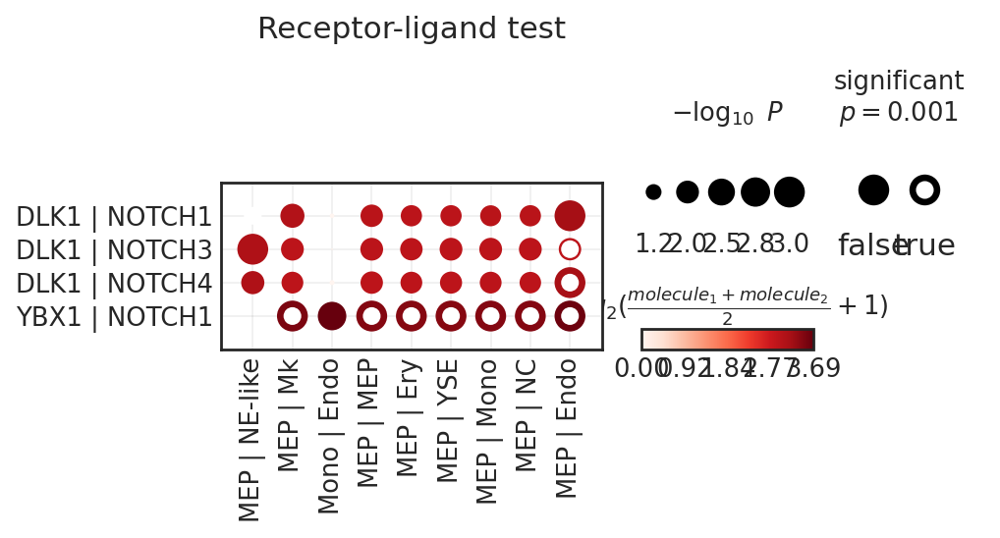

In [151]:
sq.pl.ligrec(__res, cluster_key="discrete_label_ct", 
# sq.pl.ligrec(_res, cluster_key="discrete_label_ct", source_groups=['NC'], target_groups=['YSE'],
             means_range=(6.5, np.inf), alpha=0.001, dendrogram='both', cmap='Reds',
             remove_nonsig_interactions = True, remove_empty_interactions =True,
            swap_axes=False,
            )

In [154]:
# extract df
_g1 = 'Fibro'
_g2 = 'HPC'

# _g1 = 'HPC'
# _g2 = 'Fibro'

_g1 = 'YSE'
_g2 = 'Endo'

# _g1 = 'Mes-like'
# _g2 = 'Endo'

# _g1 = 'Endo'
# _g2 = 'MEP'

means_sou_tar = __res['means'][_g1].copy().reset_index()[['source','target',_g2]]
means_sou_tar_p = __res['pvalues'][_g1].copy().reset_index()[['source','target',_g2]].rename(columns = {_g2: 'pvalues'})
# df_vtn = means_sou_tar.query("`source` == 'DLK1'")

# df_vtn = means_sou_tar[means_sou_tar['target'].str.contains("NOTCH")]

means_sou_tar_m = pd.merge(means_sou_tar, means_sou_tar_p, how='left')
df_vtn = means_sou_tar_m[(means_sou_tar_m['target'].str.contains("NOTCH")) & (means_sou_tar_m['pvalues']<0.001)][['source','target',_g2]]
# df_vtn = means_sou_tar_m[(means_sou_tar_m['target'].str.contains("NOTCH")) ][['source','target',_g2]]
# df_vtn = means_sou_tar[means_sou_tar['target'].str.contains("NOTCH")]
df_vtn_value = df_vtn.query("`%s` >= 1" % (_g2) )
df_vtn_value.sort_values(_g2, axis=0, ascending=False,inplace=True)

df_vtn_value = pd.DataFrame(df_vtn_value.values, columns=['source','target',_g2] )

lrdf = _res['metadata'].reset_index(level=[0,1]).copy()
# df_vtn_pair = lrdf.query("`source` == 'DLK1'")
df_vtn_pair = lrdf[lrdf['target'].str.contains("NOTCH")]
# df_vtn_pair = lrdf[lrdf['target'].str.contains("NOTCH") & (lrdf['database_intercell_source'].str.contains("CellPhoneDB") )]
# df_vtn_pair = df_vtn_pair[df_vtn_pair['is_stimulation'] == False ]
df_vtn_sort = pd.merge(df_vtn_value, df_vtn_pair[['source', 'target', 'is_inhibition']], on=['source', 'target'], how='inner')
df_vtn_sort['condition_value'] = df_vtn_sort.apply(lambda x: x[_g2] if x['is_inhibition']==False else x[_g2]*-1, axis=1)
df_vtn_sort['pair'] = df_vtn_sort['source'] + '_' + df_vtn_sort['target']
df_vtn_result = df_vtn_sort[['pair', 'condition_value']].set_index('pair')
df_vtn_result = df_vtn_result.sort_values(by='condition_value', ascending=True).copy()
# df_vtn_result = df_vtn_result.drop_duplicates()
df_vtn_result.shape


(13, 1)

In [155]:
# means_sou_tar_m[(means_sou_tar_m['target'].str.contains("NOTCH")) & (means_sou_tar_m['pvalues']<0.005)][['source','target',_g2, 'pvalues']]

In [156]:
# means_sou_tar_m

In [157]:
# df_vtn_pair[['source', 'target', 'database_intercell_source', 'is_inhibition', 'is_stimulation']]

In [196]:
_sadata = c_adata.copy()
_sadata = _sadata[(_sadata.obs['hemo_label']=='hemo1') & (_sadata.obs['clone']=='clone2')]

_sadata.raw = _sadata.copy()
sc.pp.log1p(_sadata)

/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [199]:
_sadata.X.max(0).max()

7.594605

In [200]:
_sadata

AnnData object with n_obs × n_vars = 276 × 2235
    obs: 'x', 'y', 'spot_index', 'cell_index', 'cell_nums', 'discrete_label', 'discrete_label_ct', 'cell_w', 'hemo_label', '1872T>A', '1868G>A', '2129G>A', '1906G>A', '843G>A', '842C>A', '9989T>C', '838T>A', '8594T>G', '3219G>A', '2559T>G', '8597T>G', '2266T>G', '3174T>A', '8610T>G', '8618T>G', '2292G>A', '1858G>A', '2562T>G', '2351T>G', '8603T>G', '2507A>T', 'barcode', 'clone'
    uns: 'cell_locations', 'clusters_colors', 'hvg', 'id_colors', 'leiden', 'log1p', 'neighbors', 'pca', 'spatial', 'umap', 'discrete_label_ct_colors'
    obsm: 'spatial'

In [ ]:
sdm.weight_matrix(_sadata, l=1.2, cutoff=0.2, single_cell=False) # weight_matrix by rbf kernel
sdm.extract_lr(_sadata, 'human', min_cell=3)      # find overlapping LRs from CellChatDB
sdm.spatialdm_global(_sadata, 1000, specified_ind=None, method='both', nproc=1)     # global Moran selection
sdm.sig_pairs(_sadata, method='permutation', fdr=True, threshold=0.1)     # select significant pairs
sdm.spatialdm_local(_sadata, n_perm=1000, method='both', specified_ind=None, nproc=1)     # local spot selection
sdm.sig_spots(_sadata, method='permutation', fdr=False, threshold=0.1)     # significant local spots

In [709]:
df_vtn

cluster_2,source,target,Endo
0,JAG2,NOTCH1,1.584156
1,DLL1,NOTCH1,1.556899
2,WNT1,NOTCH1,1.556991
10,DLL4,NOTCH4,1.487632
11,DLL4,NOTCH1,1.557573
17,JAG1,NOTCH4,1.487157
18,JAG2,NOTCH4,1.514214
19,DLL1,NOTCH4,1.486958
20,THBS2,NOTCH4,1.487109
24,TNF,NOTCH1,1.561383


In [986]:
import numpy as np
import matplotlib.pyplot as pl
import scanpy as sc

In [1644]:
_sadata = c_adata.copy()
# _tar_cell_n = ''
_tar_cell_n = 'hemo5'
_sadata = _sadata[(_sadata.obs['hemo_label']==_tar_cell_n)]

# _tar_cell_n = ''
# _sadata = _sadata

# _sadata = _sadata[(_sadata.obs['hemo_label']=='hemo1')]
_sadata

/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


View of AnnData object with n_obs × n_vars = 363 × 2235
    obs: 'x', 'y', 'spot_index', 'cell_index', 'cell_nums', 'discrete_label', 'discrete_label_ct', 'cell_w', 'hemo_label', '1872T>A', '1868G>A', '2129G>A', '1906G>A', '843G>A', '842C>A', '9989T>C', '838T>A', '8594T>G', '3219G>A', '2559T>G', '8597T>G', '2266T>G', '3174T>A', '8610T>G', '8618T>G', '2292G>A', '1858G>A', '2562T>G', '2351T>G', '8603T>G', '2507A>T', 'barcode', 'clone'
    uns: 'cell_locations', 'clusters_colors', 'hvg', 'id_colors', 'leiden', 'log1p', 'neighbors', 'pca', 'spatial', 'umap', 'discrete_label_ct_colors', 'clone_colors'
    obsm: 'spatial'

In [1645]:
_sadata.raw = _sadata.copy()  

In [1646]:
sc.pp.normalize_total(_sadata, inplace=True)
sc.pp.log1p(_sadata)
sc.pp.highly_variable_genes(_sadata, flavor="seurat", n_top_genes=2160)

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [1647]:
# sc.pp.normalize_per_cell(_sadata)
# palantir.preprocess.log_transform(_sadata)
# sc.pp.highly_variable_genes(_sadata, flavor="seurat", n_top_genes=2160)

In [1648]:
pca_projections, _ = palantir.utils.run_pca(_sadata, use_hvg=False)


computing PCA
    with n_comps=300
    finished (0:00:02)


In [1649]:
dm_res = palantir.utils.run_diffusion_maps(_sadata, n_components=6)
ms_data = palantir.utils.determine_multiscale_space(_sadata)


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [1693]:
sc.pp.pca(_sadata)
sc.pp.neighbors(_sadata, n_neighbors=15, )
sc.tl.umap(_sadata)
sc.tl.leiden(_sadata, key_added="clusters")

computing PCA
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:03)
running Leiden clustering
    finished: found 13 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:00)


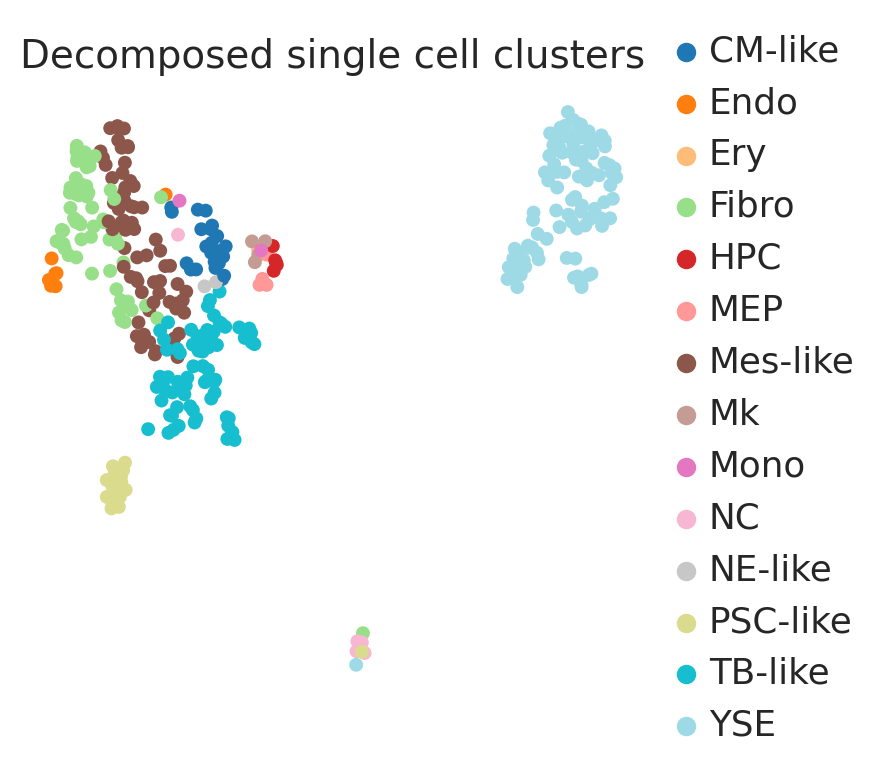

In [1694]:
fig, ax = plt.subplots(figsize=(4, 4))
sc.pl.umap(
    _sadata,
    color=['discrete_label_ct'],
    frameon=False,s=100, title='Decomposed single cell clusters', ax=ax
)

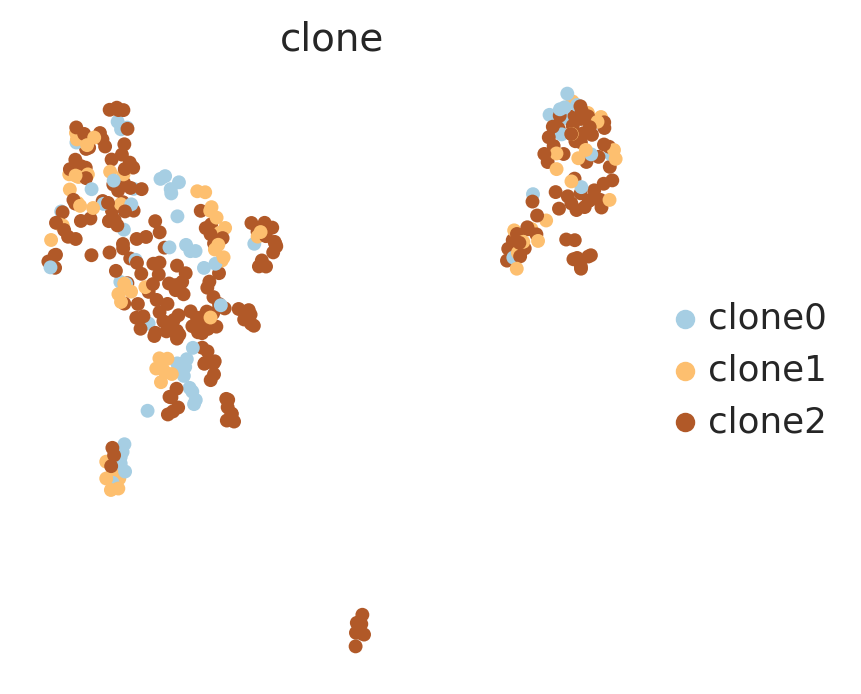

In [1695]:
# Use scanpy functions to visualize umaps or FDL
fig, ax = plt.subplots(figsize=(4, 4))

sc.pl.embedding(
    _sadata,
    basis='umap',
    cmap=None, palette=None, 
    color="clone",
    frameon=False,s=100, ax=ax
)

In [1442]:
#cell cell distance

import multiprocessing as mp
from datetime import datetime


def get_cell_dis_dev(mat, v_prior, i, j):
    if i < j:
        # return (abs(mat[i, :] - mat[j, :]) * v_prior).sum()
        return (abs(mat[i, :] - mat[j, :]) * 1).sum()
    else:
        return 0

def get_distance(mat, n_core=64):
    cell_n, _v_n = mat.shape

    v_mean_af = mat.mean(0)
    v_prior = 1 - v_mean_af

    p = mp.Pool(n_core)
    results = p.starmap(get_cell_dis_dev, ((mat, v_prior, i, j) for i in range(cell_n) for j in range(cell_n) ))
    results = np.array(results).reshape(cell_n, cell_n)
#     # assign all element
    i_lower = np.tril_indices(cell_n, -1)
    results[i_lower] = results.T[i_lower]

    p.close()
    p.join()
    return results

# get cell-cell distance
start_time = datetime.now()
# cell * variants

# _tar_df = tmp_merge_o.merge(_adata.obs[['barcode', 'cell_type']], how='left').dropna().reset_index()
# _tar_col = af_columns_o
# _af_df = _tar_df[_tar_col]

_tmp = _sadata.var['highly_variable']
_tmp_tar_df = _tmp[_tmp].index
_tar_df = pd.DataFrame( _sadata.X[:, _tmp], columns=_tmp_tar_df)
_tar_df['discrete_label_ct'] = _sadata.obs[['discrete_label_ct', 'cell_index']].reset_index()['discrete_label_ct']
_tar_df['cell_index'] = _sadata.obs[['discrete_label_ct', 'cell_index']].reset_index()['cell_index']
print(_tar_df.head())

_tar_col = _tmp_tar_df
_af_df = _tar_df[_tar_col]


tar_m = np.array(_af_df)
ps_map = get_distance(tar_m)
end_time = datetime.now()

print('Computed cell-cell distance. (in {}s)'.format(end_time - start_time))



       HES4     ISG15      AGRN  TNFRSF18   TNFRSF4      HES5  AL139246.5  \
0  0.379171  0.948531  0.003044  0.003026  0.000000  0.000883    0.000000   
1  1.009349  3.460926  0.000000  0.003859  0.003181  0.000153    0.001225   
2  0.323935  0.914131  0.000874  0.000000  0.001324  0.000314    0.000000   
3  0.000000  0.005842  0.000000  0.004254  0.001988  0.001968    0.000000   
4  0.000000  1.265502  0.004002  0.002618  0.001149  0.003279    0.001602   

   TNFRSF14     SMIM1  TNFRSF25  ...   IL12RB1       LHB     SSTR3  LINC02154  \
0  0.004238  0.003248  0.010838  ...  0.000000  0.002662  0.000000   0.004711   
1  0.781855  1.958078  0.009012  ...  0.001136  0.002653  0.004455   0.000000   
2  0.015114  0.002509  0.015526  ...  0.003403  0.006724  0.002677   0.000000   
3  0.006659  0.580785  0.008816  ...  0.002054  0.002137  0.000000   0.000000   
4  0.000000  0.000000  0.005698  ...  0.008743  0.006556  0.001961   0.003462   

     CD40LG     FASLG     CCL13  AC007922.4  discr

363


[Text(1, 0.5, 'HPC'),
 Text(1, 1.5, 'MEP'),
 Text(1, 2.5, 'Ery'),
 Text(1, 3.5, 'Mk'),
 Text(1, 4.5, 'Fibro'),
 Text(1, 5.5, 'Mes-like'),
 Text(1, 6.5, 'Endo'),
 Text(1, 7.5, 'YSE'),
 Text(1, 8.5, 'CM-like'),
 Text(1, 9.5, 'Mono'),
 Text(1, 10.5, 'NC'),
 Text(1, 11.5, 'TB-like'),
 Text(1, 12.5, 'NE-like'),
 Text(1, 13.5, 'PSC-like')]

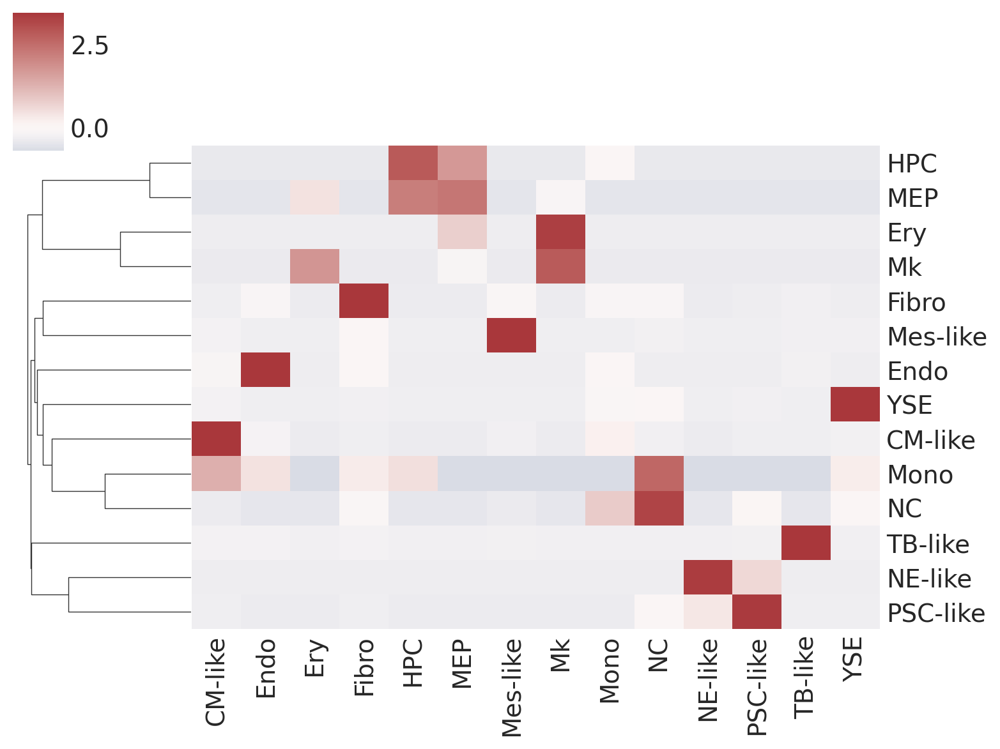

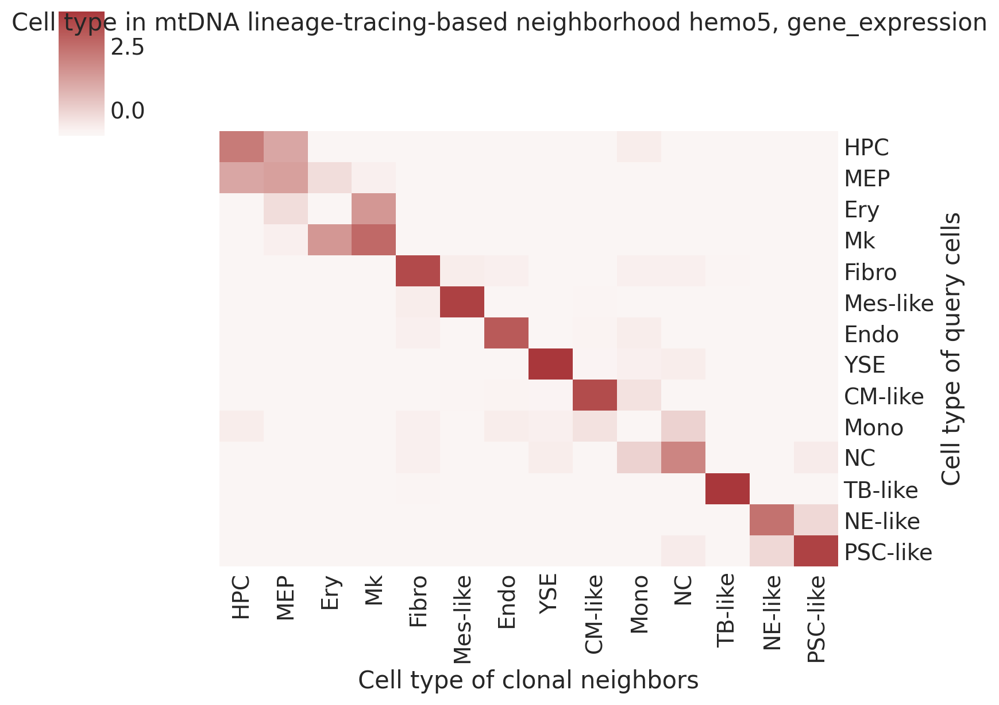

In [1443]:
import seaborn as sns
# connectness
import networkx as nx


def from_dist_to_graph(d, k_param=30, return_nx_graph=True):
    if not isinstance(d, np.ndarray):
        d = d.values

    n_cells = d.shape[0]
    knn_mat = np.zeros((n_cells, k_param), dtype=int)
    knd_mat = np.zeros((n_cells, k_param))
    print(n_cells)
    # Find k nearest neighbors for each cell
    for i in range(n_cells):
        knn_indices = np.argsort(d[i, :])[:k_param]
        knn_mat[i, :] = knn_indices
        knd_mat[i, :] = d[i, knn_indices]

    nn_dist = knn_mat[:, :k_param]
    knn = nn_dist
    
    # Compute mutual k-nearest neighbors (MNN)
    knn2 = []
    for i in range(knn.shape[0]):
        xx = np.apply_along_axis(lambda x: i in x, 1, knn[knn[i, 1:], :])
        if np.sum(xx) > 0:
            temp_knn = np.concatenate(([knn[i, 0]], knn[i, 1:][xx]))
            temp_el = [[temp_knn[0], neighbor] for neighbor in temp_knn[1:]]
        # else:
        #     temp_el = [[knn[i, 0], knn[i, 1]]]
            knn2.extend(temp_el)

    el = np.array(knn2)
    graph = nx.Graph()
    graph.add_nodes_from(range(n_cells))

    graph.add_edges_from(el)

    mutual_knn = nx.to_numpy_array(graph, nodelist=range(n_cells))
    
    # mutual_knn = nx.to_numpy_array(graph, nodelist=sorted(graph.nodes()))

    # mutual_knn = nx.to_numpy_array(graph)
    if return_nx_graph:
        return mutual_knn, graph
    else:
        return mutual_knn, _

def aggregate_distance_matrix_by_class(X, class_df, cls_n="clone"):
    # Get unique classes
    classes = class_df.iloc[:, 0].unique()
    # Initialize a dictionary to store the results
    results = {}
    # Iterate over each class as the target class
    for target_class in classes:
        # Get the nodes that belong to the target class
        # print(target_class)
        target_nodes = class_df[class_df[cls_n] == target_class].index
        # print(target_nodes)
        # Initialize a dictionary to count connections to each class
        connection_counts = {cls: 0 for cls in classes}
        total_connections = 0
        # Iterate over each node in the target class
        for node in target_nodes:
            # Get the connections of the current node
            connections = X[node, :]
            # Count connections to each class
            for connected_node in np.where(connections == 1)[0]:
                connected_class = class_df.loc[connected_node, cls_n]
                # print(target_class, connected_node, connected_class)
                connection_counts[connected_class] += 1
                total_connections += 1
        # Calculate the proportion of connections to each class
        proportions = {cls: (count / total_connections * 100 if total_connections > 0 else 0) for cls, count in connection_counts.items()}
        # Store the result for the target class
        results[target_class] = proportions
    # Convert the result dictionary to a DataFrame for a better presentation
    results_df = pd.DataFrame(results).T
    return results_df, sorted(classes)


def get_connectness(ps_map, cls_df, af_df, k_param=30, cls_n = 'cell_type'):
    knn_mat, knn_graph = from_dist_to_graph(ps_map, k_param, return_nx_graph=True)
    X = knn_mat

    class_df = cls_df[["barcode", cls_n]].set_index('barcode')
    results_df, no = aggregate_distance_matrix_by_class(X, class_df, cls_n)

    tmp_df = results_df.loc[no, no]
    tmp_df = (tmp_df + tmp_df.T ) / 2
    g = sns.clustermap(tmp_df, annot=False, xticklabels=True, yticklabels=True, row_cluster=True, col_cluster=False, figsize=(8,6), z_score=0, cmap="vlag", center=0)
    plt.close()
    row_order = g.dendrogram_row.reordered_ind
    tmp_df_reordered = tmp_df.iloc[row_order, row_order]
    g = sns.clustermap(tmp_df_reordered, annot=False, xticklabels=True, yticklabels=True, row_cluster=False, col_cluster=False, figsize=(8,6), z_score=0, cmap="vlag", center=0)
    g.fig.suptitle("Cell type in mtDNA lineage-tracing-based neighborhood", fontsize=15)
    g.ax_heatmap.set_xlabel("Cell type of clonal neighbors", fontsize=15)
    g.ax_heatmap.set_ylabel("Cell type of query cells", fontsize=15)
    g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), fontsize=14)  # Set x-axis label size
    g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(), fontsize=14) 
    # _out_png_f = "%s/2_clone_connectness.png" % (out_dir)
    # plt.savefig(_out_png_f, bbox_inches='tight')



k_param=10
o_af_df = _af_df
cls_df = _tar_df[['cell_index', 'discrete_label_ct']].copy()
cls_n = 'discrete_label_ct'

knn_mat, knn_graph = from_dist_to_graph(ps_map, k_param, return_nx_graph=True)
# nx.draw(knn_graph)
X = knn_mat

class_df = cls_df[["cell_index", cls_n]].set_index('cell_index').reset_index()[[cls_n]]
results_df, no = aggregate_distance_matrix_by_class(X, class_df, cls_n)

tmp_df = results_df.loc[no, no]
tmp_df = (tmp_df + tmp_df.T ) / 2
g = sns.clustermap(tmp_df, annot=False, xticklabels=True, yticklabels=True, row_cluster=True, col_cluster=False, figsize=(8,6), z_score=0, cmap="vlag", center=0)
# plt.close()
row_order = g.dendrogram_row.reordered_ind
tmp_df_reordered = tmp_df.iloc[row_order, row_order]
tmp_df_reordered = (tmp_df_reordered - tmp_df_reordered.stack().std()) /  tmp_df_reordered.stack().std()
g = sns.clustermap(tmp_df_reordered, annot=False, xticklabels=True, yticklabels=True, row_cluster=False, col_cluster=False, figsize=(8,6),  cmap="vlag", center=-1)
g.fig.suptitle("Cell type in mtDNA lineage-tracing-based neighborhood%s, gene_expression" % (" " + _tar_cell_n) , fontsize=15)
g.ax_heatmap.set_xlabel("Cell type of clonal neighbors", fontsize=15)
g.ax_heatmap.set_ylabel("Cell type of query cells", fontsize=15)
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), fontsize=14)  # Set x-axis label size
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(), fontsize=14) 



# get_connectness(ps_map, cls_df, o_af_df, k_param)

In [1446]:
#cell cell distance

import multiprocessing as mp
from datetime import datetime


def get_cell_dis_dev(mat, v_prior, i, j):
    if i < j:
        # return (abs(mat[i, :] - mat[j, :]) * v_prior).sum()
        return (abs(mat[i, :] - mat[j, :]) * 1).sum()
    else:
        return 0

def get_distance(mat, n_core=64):
    cell_n, _v_n = mat.shape

    v_mean_af = mat.mean(0)
    v_prior = 1 - v_mean_af

    p = mp.Pool(n_core)
    results = p.starmap(get_cell_dis_dev, ((mat, v_prior, i, j) for i in range(cell_n) for j in range(cell_n) ))
    results = np.array(results).reshape(cell_n, cell_n)
#     # assign all element
    i_lower = np.tril_indices(cell_n, -1)
    results[i_lower] = results.T[i_lower]

    p.close()
    p.join()
    return results

# get cell-cell distance
start_time = datetime.now()
# cell * variants

_tar_df = _sadata.obs[['cell_index', 'barcode', 'discrete_label_ct']].merge(tmp_merge_o, how='left').dropna().reset_index()
_tar_col = af_columns_o
_af_df = _tar_df[_tar_col]

# _tmp = _sadata.var['highly_variable']
# _tmp_tar_df = _tmp[_tmp].index
# _tar_df = pd.DataFrame( _sadata.X[:, _tmp], columns=_tmp_tar_df)
# _tar_df['discrete_label_ct'] = _sadata.obs[['discrete_label_ct', 'cell_index']].reset_index()['discrete_label_ct']
# _tar_df['cell_index'] = _sadata.obs[['discrete_label_ct', 'cell_index']].reset_index()['cell_index']
print(_tar_df.head())

# _tar_col = _tmp_tar_df
# _af_df = _tar_df[_tar_col]


tar_m = np.array(_af_df)
ps_map = get_distance(tar_m)
end_time = datetime.now()

print('Computed cell-cell distance. (in {}s)'.format(end_time - start_time))



   index            cell_index             barcode discrete_label_ct  \
0      0  AAATTTACCGAAATCC-1_0  AAATTTACCGAAATCC-1             Fibro   
1      1  AAATTTACCGAAATCC-1_1  AAATTTACCGAAATCC-1               YSE   
2      2  AAATTTACCGAAATCC-1_2  AAATTTACCGAAATCC-1             Fibro   
3      3  AAATTTACCGAAATCC-1_3  AAATTTACCGAAATCC-1               YSE   
4      4  AAATTTACCGAAATCC-1_4  AAATTTACCGAAATCC-1               YSE   

    1872T>A   1868G>A   2129G>A   1906G>A    843G>A    842C>A  ...   3174T>A  \
0  0.013765  0.012882  0.001037  0.001257  0.008427  0.016807  ...  0.005714   
1  0.013765  0.012882  0.001037  0.001257  0.008427  0.016807  ...  0.005714   
2  0.013765  0.012882  0.001037  0.001257  0.008427  0.016807  ...  0.005714   
3  0.013765  0.012882  0.001037  0.001257  0.008427  0.016807  ...  0.005714   
4  0.013765  0.012882  0.001037  0.001257  0.008427  0.016807  ...  0.005714   

    8610T>G   8618T>G   2292G>A   1858G>A   2562T>G  2351T>G   8603T>G  \
0  0.069832 

In [1447]:
_tar_df.head()

,index,cell_index,barcode,discrete_label_ct,1872T>A,1868G>A,2129G>A,1906G>A,843G>A,842C>A,...,3174T>A,8610T>G,8618T>G,2292G>A,1858G>A,2562T>G,2351T>G,8603T>G,2507A>T,clone
0,0,AAATTTACCGAAATCC-1_0,AAATTTACCGAAATCC-1,Fibro,0.013765,0.012882,0.001037,0.001257,0.008427,0.016807,...,0.005714,0.069832,0.101928,0.016949,0.005632,0.038251,0.03163,0.063536,0.025424,clone2
1,1,AAATTTACCGAAATCC-1_1,AAATTTACCGAAATCC-1,YSE,0.013765,0.012882,0.001037,0.001257,0.008427,0.016807,...,0.005714,0.069832,0.101928,0.016949,0.005632,0.038251,0.03163,0.063536,0.025424,clone2
2,2,AAATTTACCGAAATCC-1_2,AAATTTACCGAAATCC-1,Fibro,0.013765,0.012882,0.001037,0.001257,0.008427,0.016807,...,0.005714,0.069832,0.101928,0.016949,0.005632,0.038251,0.03163,0.063536,0.025424,clone2
3,3,AAATTTACCGAAATCC-1_3,AAATTTACCGAAATCC-1,YSE,0.013765,0.012882,0.001037,0.001257,0.008427,0.016807,...,0.005714,0.069832,0.101928,0.016949,0.005632,0.038251,0.03163,0.063536,0.025424,clone2
4,4,AAATTTACCGAAATCC-1_4,AAATTTACCGAAATCC-1,YSE,0.013765,0.012882,0.001037,0.001257,0.008427,0.016807,...,0.005714,0.069832,0.101928,0.016949,0.005632,0.038251,0.03163,0.063536,0.025424,clone2


363


[Text(1, 0.5, 'HPC'),
 Text(1, 1.5, 'Mk'),
 Text(1, 2.5, 'NC'),
 Text(1, 3.5, 'MEP'),
 Text(1, 4.5, 'Fibro'),
 Text(1, 5.5, 'Endo'),
 Text(1, 6.5, 'Mono'),
 Text(1, 7.5, 'PSC-like'),
 Text(1, 8.5, 'CM-like'),
 Text(1, 9.5, 'Ery'),
 Text(1, 10.5, 'YSE'),
 Text(1, 11.5, 'TB-like'),
 Text(1, 12.5, 'Mes-like'),
 Text(1, 13.5, 'NE-like')]

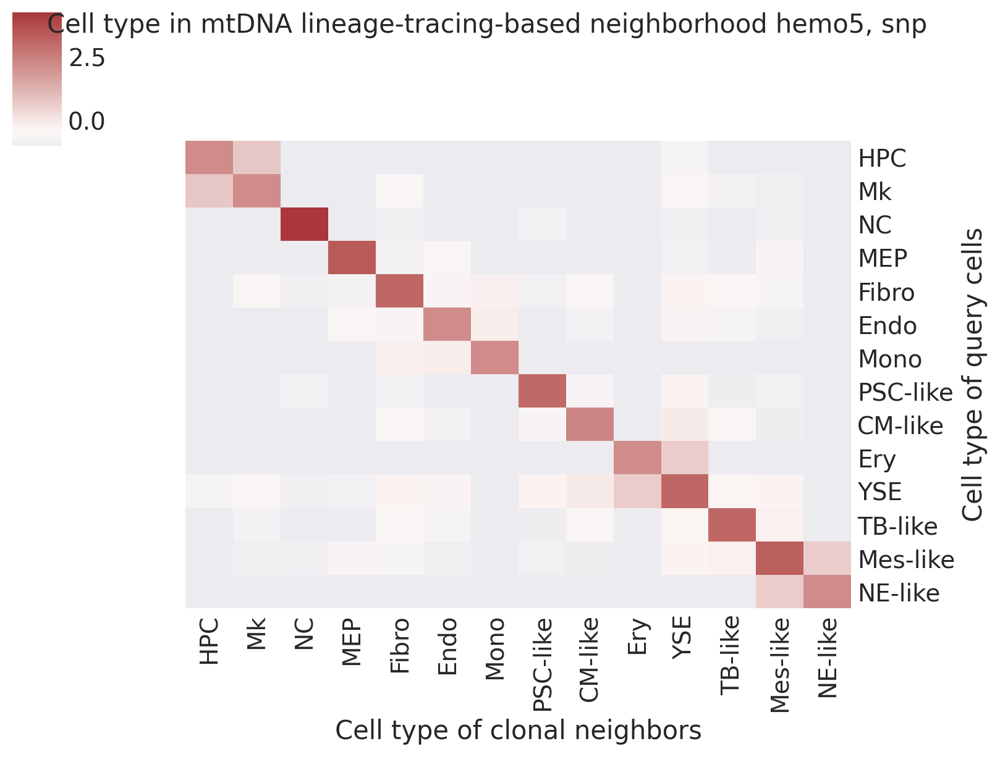

In [1451]:
import seaborn as sns
# connectness
import networkx as nx


def from_dist_to_graph(d, k_param=30, return_nx_graph=True):
    if not isinstance(d, np.ndarray):
        d = d.values

    n_cells = d.shape[0]
    knn_mat = np.zeros((n_cells, k_param), dtype=int)
    knd_mat = np.zeros((n_cells, k_param))
    print(n_cells)
    # Find k nearest neighbors for each cell
    for i in range(n_cells):
        knn_indices = np.argsort(d[i, :])[:k_param]
        knn_mat[i, :] = knn_indices
        knd_mat[i, :] = d[i, knn_indices]

    nn_dist = knn_mat[:, :k_param]
    knn = nn_dist
    
    # Compute mutual k-nearest neighbors (MNN)
    knn2 = []
    for i in range(knn.shape[0]):
        xx = np.apply_along_axis(lambda x: i in x, 1, knn[knn[i, 1:], :])
        if np.sum(xx) > 0:
            temp_knn = np.concatenate(([knn[i, 0]], knn[i, 1:][xx]))
            temp_el = [[temp_knn[0], neighbor] for neighbor in temp_knn[1:]]
        # else:
        #     temp_el = [[knn[i, 0], knn[i, 1]]]
            knn2.extend(temp_el)

    el = np.array(knn2)
    graph = nx.Graph()
    graph.add_nodes_from(range(n_cells))

    graph.add_edges_from(el)

    mutual_knn = nx.to_numpy_array(graph, nodelist=range(n_cells))
    
    # mutual_knn = nx.to_numpy_array(graph, nodelist=sorted(graph.nodes()))

    # mutual_knn = nx.to_numpy_array(graph)
    if return_nx_graph:
        return mutual_knn, graph
    else:
        return mutual_knn, _

def aggregate_distance_matrix_by_class(X, class_df, cls_n="clone"):
    # Get unique classes
    classes = class_df.iloc[:, 0].unique()
    # Initialize a dictionary to store the results
    results = {}
    # Iterate over each class as the target class
    for target_class in classes:
        # Get the nodes that belong to the target class
        # print(target_class)
        target_nodes = class_df[class_df[cls_n] == target_class].index
        # print(target_nodes)
        # Initialize a dictionary to count connections to each class
        connection_counts = {cls: 0 for cls in classes}
        total_connections = 0
        # Iterate over each node in the target class
        for node in target_nodes:
            # Get the connections of the current node
            connections = X[node, :]
            # Count connections to each class
            for connected_node in np.where(connections == 1)[0]:
                connected_class = class_df.loc[connected_node, cls_n]
                # print(target_class, connected_node, connected_class)
                connection_counts[connected_class] += 1
                total_connections += 1
                connection_counts[target_class] += 1
                total_connections += 1
        # Calculate the proportion of connections to each class
        proportions = {cls: (count / total_connections * 100 if total_connections > 0 else 0) for cls, count in connection_counts.items()}
        # Store the result for the target class
        results[target_class] = proportions
    # Convert the result dictionary to a DataFrame for a better presentation
    results_df = pd.DataFrame(results).T
    return results_df, sorted(classes)


def get_connectness(ps_map, cls_df, af_df, k_param=30, cls_n = 'cell_type'):
    knn_mat, knn_graph = from_dist_to_graph(ps_map, k_param, return_nx_graph=True)
    X = knn_mat

    class_df = cls_df[["barcode", cls_n]].set_index('barcode')
    results_df, no = aggregate_distance_matrix_by_class(X, class_df, cls_n)

    tmp_df = results_df.loc[no, no]
    tmp_df = (tmp_df + tmp_df.T ) / 2
    g = sns.clustermap(tmp_df, annot=False, xticklabels=True, yticklabels=True, row_cluster=True, col_cluster=False, figsize=(8,6), z_score=0, cmap="vlag", center=0)
    plt.close()
    row_order = g.dendrogram_row.reordered_ind
    tmp_df_reordered = tmp_df.iloc[row_order, row_order]
    g = sns.clustermap(tmp_df_reordered, annot=False, xticklabels=True, yticklabels=True, row_cluster=False, col_cluster=False, figsize=(8,6), z_score=0, cmap="vlag", center=0)
    g.fig.suptitle("Cell type in mtDNA lineage-tracing-based neighborhood", fontsize=15)
    g.ax_heatmap.set_xlabel("Cell type of clonal neighbors", fontsize=15)
    g.ax_heatmap.set_ylabel("Cell type of query cells", fontsize=15)
    g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), fontsize=14)  # Set x-axis label size
    g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(), fontsize=14) 
    # _out_png_f = "%s/2_clone_connectness.png" % (out_dir)
    # plt.savefig(_out_png_f, bbox_inches='tight')



k_param=20
o_af_df = _af_df
cls_df = _tar_df[['cell_index', 'discrete_label_ct']].copy()
cls_n = 'discrete_label_ct'

knn_mat, knn_graph = from_dist_to_graph(ps_map, k_param, return_nx_graph=True)
# nx.draw(knn_graph)
X = knn_mat

class_df = cls_df[["cell_index", cls_n]].set_index('cell_index').reset_index()[[cls_n]]
results_df, no = aggregate_distance_matrix_by_class(X, class_df, cls_n)

tmp_df = results_df.loc[no, no]
tmp_df = (tmp_df + tmp_df.T ) / 2
g = sns.clustermap(tmp_df, annot=False, xticklabels=True, yticklabels=True, row_cluster=True, col_cluster=False, figsize=(8,6), z_score=0, cmap="vlag", center=0)
plt.close()
row_order = g.dendrogram_row.reordered_ind
tmp_df_reordered = tmp_df.iloc[row_order, row_order]
tmp_df_reordered = (tmp_df_reordered - tmp_df_reordered.stack().std()) /  tmp_df_reordered.stack().std()
g = sns.clustermap(tmp_df_reordered, annot=False, xticklabels=True, yticklabels=True, row_cluster=False, col_cluster=False, figsize=(8,6),  cmap="vlag", center=-0.5)
g.fig.suptitle("Cell type in mtDNA lineage-tracing-based neighborhood%s, snp" % (" " + _tar_cell_n) , fontsize=15)
g.ax_heatmap.set_xlabel("Cell type of clonal neighbors", fontsize=15)
g.ax_heatmap.set_ylabel("Cell type of query cells", fontsize=15)
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), fontsize=14)  # Set x-axis label size
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(), fontsize=14) 



# get_connectness(ps_map, cls_df, o_af_df, k_param)

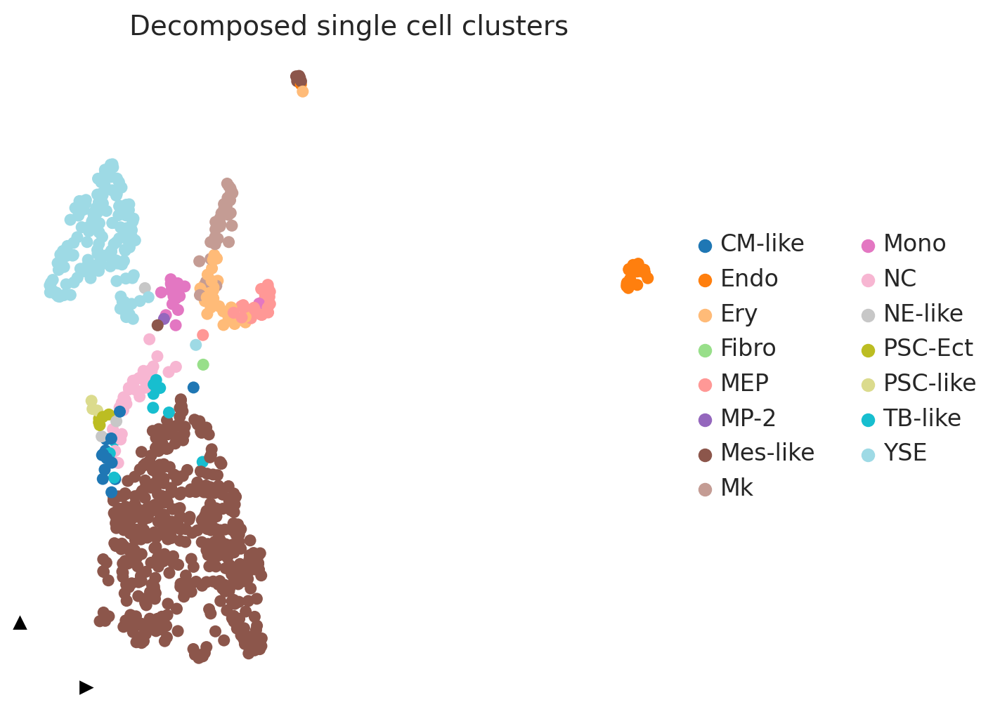

In [1345]:
fig, ax = plt.subplots(figsize=(6, 6))
sc.pl.umap(_sadata, color=['discrete_label_ct'], show=False, ax=ax, legend_fontsize=12, title='Decomposed single cell clusters')

shrink_by = 0.1
xlim = ax.get_xlim()
ylim = ax.get_ylim()

xbound = xlim[0] + (xlim[1] - xlim[0]) * shrink_by
ybound = ylim[0] + (ylim[1] - ylim[0]) * shrink_by

b = ax.spines["bottom"]
b.set_bounds(xlim[0], xbound)
ax.set_xlabel(ax.get_xlabel(), x=0, ha="left")
ax.plot(xbound, 0, ">k", transform=ax.get_xaxis_transform(), clip_on=False)

b = ax.spines["left"]
b.set_bounds(ylim[0], ybound)
ax.set_ylabel(ax.get_ylabel(), y=0, ha="left")
ax.plot(0, ybound, "^k", transform=ax.get_yaxis_transform(), clip_on=False)

ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

In [1346]:
# dm_res = palantir.utils.run_diffusion_maps(_sadata, n_components=6)
# ms_data = palantir.utils.determine_multiscale_space(_sadata)


In [1347]:
# sc.pp.neighbors(_sadata)
# sc.tl.umap(_sadata)

In [1348]:
# # Use scanpy functions to visualize umaps or FDL
# __tar_l = 'umap'
# # __tar_l = 'spatial'
# sc.pl.embedding(
#     _sadata,
#     basis=__tar_l,
#     color="discrete_label_ct"
# )

In [1349]:
_sadata

AnnData object with n_obs × n_vars = 796 × 2235
    obs: 'x', 'y', 'spot_index', 'cell_index', 'cell_nums', 'discrete_label', 'discrete_label_ct', 'cell_w', 'hemo_label', '1872T>A', '1868G>A', '2129G>A', '1906G>A', '843G>A', '842C>A', '9989T>C', '838T>A', '8594T>G', '3219G>A', '2559T>G', '8597T>G', '2266T>G', '3174T>A', '8610T>G', '8618T>G', '2292G>A', '1858G>A', '2562T>G', '2351T>G', '8603T>G', '2507A>T', 'barcode', 'clone', 'clusters'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'cell_locations', 'clusters_colors', 'hvg', 'id_colors', 'leiden', 'log1p', 'neighbors', 'pca', 'spatial', 'umap', 'discrete_label_ct_colors', 'clusters', 'clone_colors', 'diffmap_evals', 'DM_EigenValues', 'palantir_waypoints', 'draw_graph', 'paga', 'discrete_label_ct_sizes', 'leiden_colors', 'iroot', '1872T>A_colors'
    obsm: 'spatial', 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

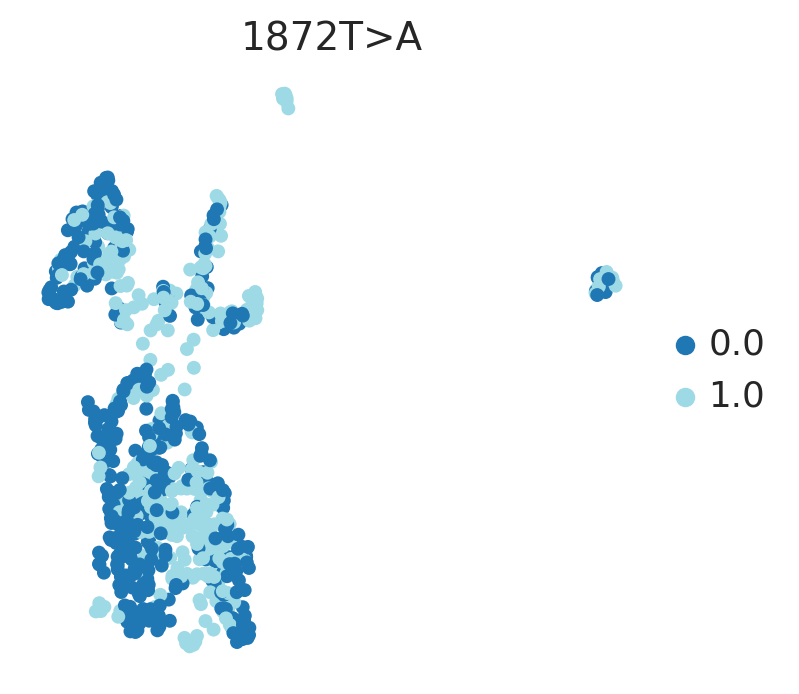

In [1350]:
# Use scanpy functions to visualize umaps or FDL
_sadata.obs["1872T>A"] = _sadata.obs["1872T>A"].astype('str')

sc.pl.embedding(
    _sadata,
    basis=__tar_l,
    color="1872T>A",
    frameon=False,s=100
)

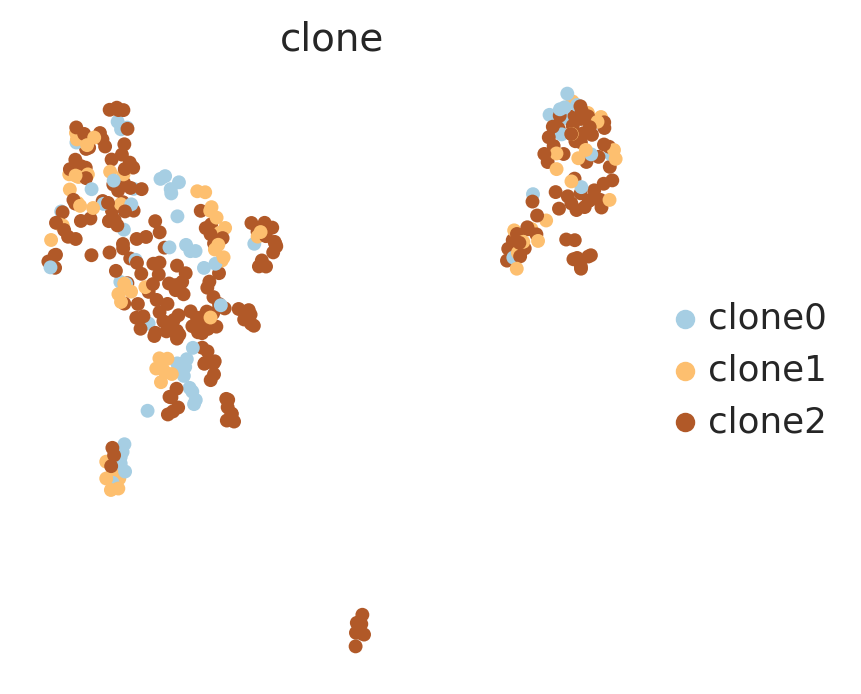

In [1151]:
# Use scanpy functions to visualize umaps or FDL
sc.pl.embedding(
    _sadata,
    basis=__tar_l,
    color="clone",
    frameon=False,s=100
)

In [1697]:
imputed_X = palantir.utils.run_magic_imputation(_sadata)


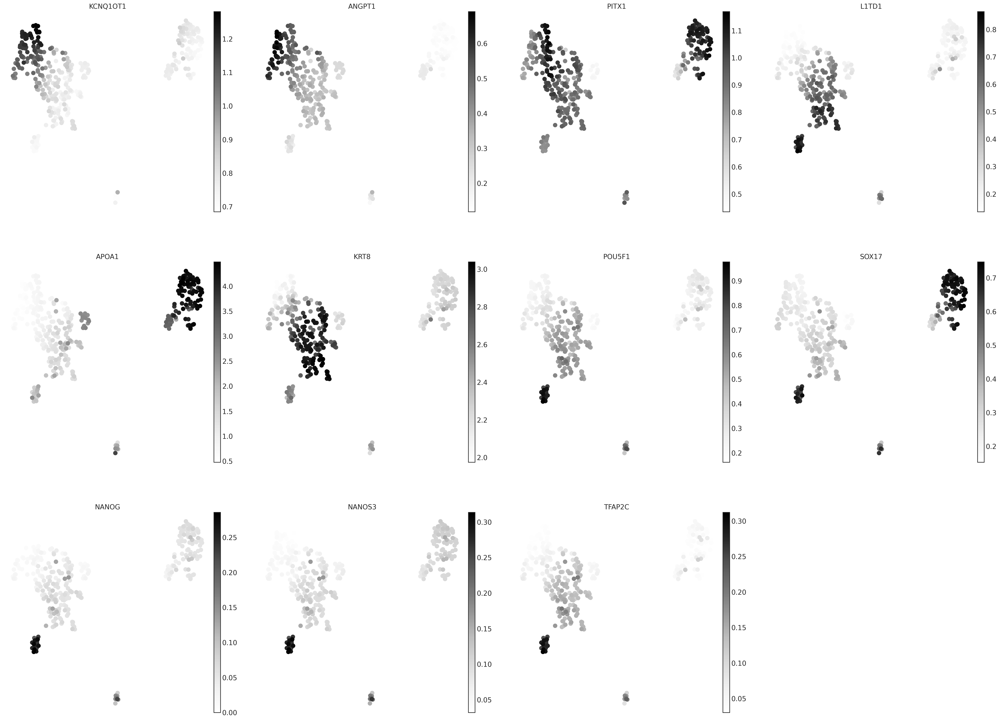

In [1698]:
sc.pl.embedding(
    _sadata,
    basis=__tar_l,
    layer="MAGIC_imputed_data",
    color=["KCNQ1OT1", "ANGPT1", "PITX1", "L1TD1", 'APOA1', 'KRT8', 'POU5F1', 'SOX17', 'NANOG', 'NANOS3', 'TFAP2C'],
    frameon=False,
)
plt.show()

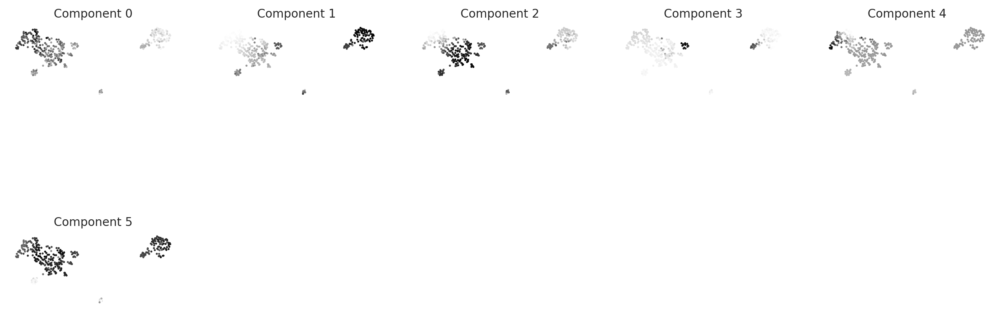

In [1699]:
palantir.plot.plot_diffusion_components(_sadata)
plt.show()

In [1053]:
np.flatnonzero(_sadata.obs['discrete_label_ct']  == 'PSC-like')[1]

287

In [ ]:
np.flatnonzero(_sadata.obs['discrete_label_ct']  == "Fibro")

42 422 Fibro


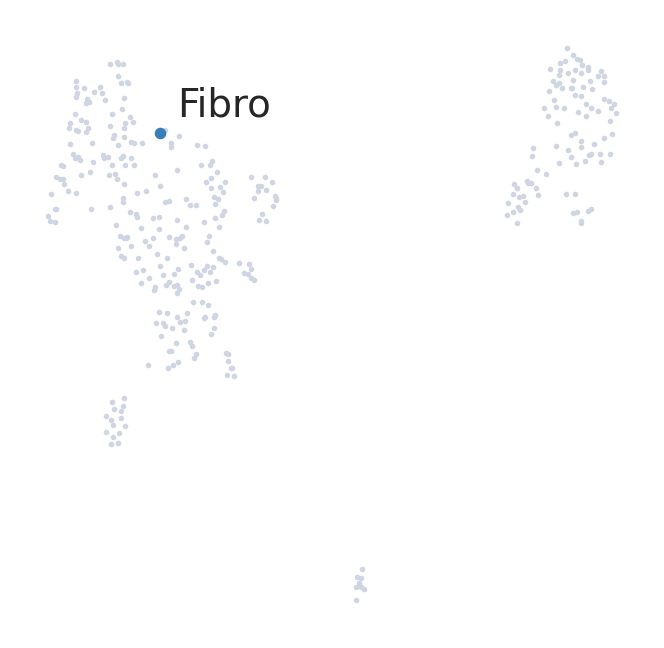

111 1050 Fibro


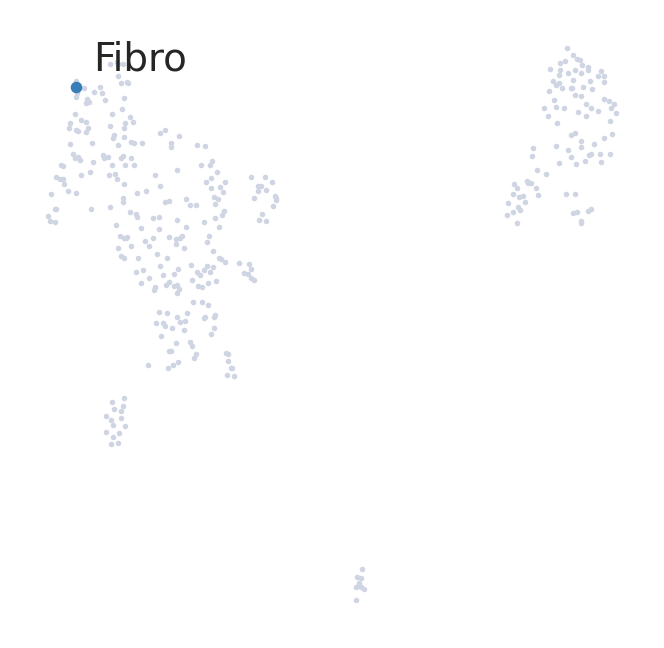

350 3868 Fibro


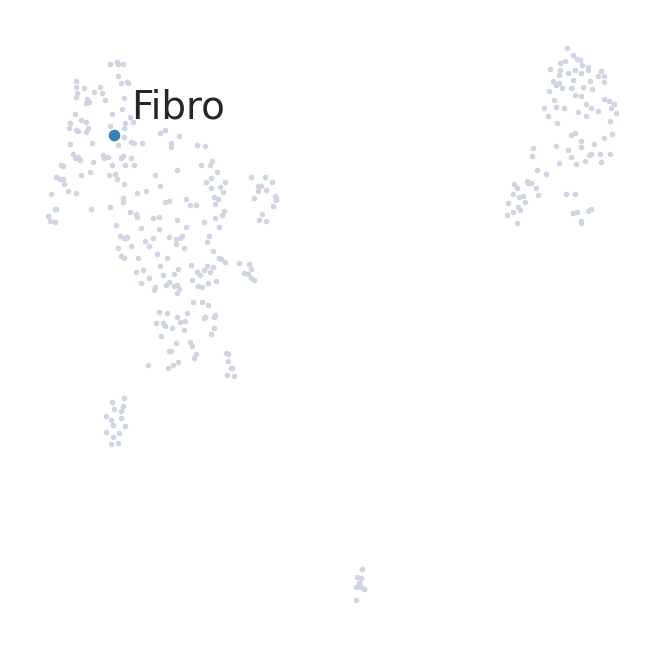

125 1087 Fibro


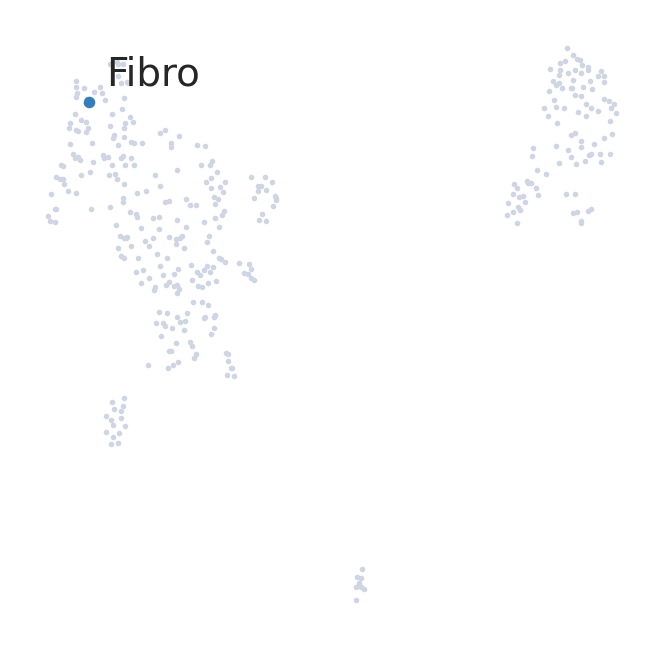

96 1001 Fibro


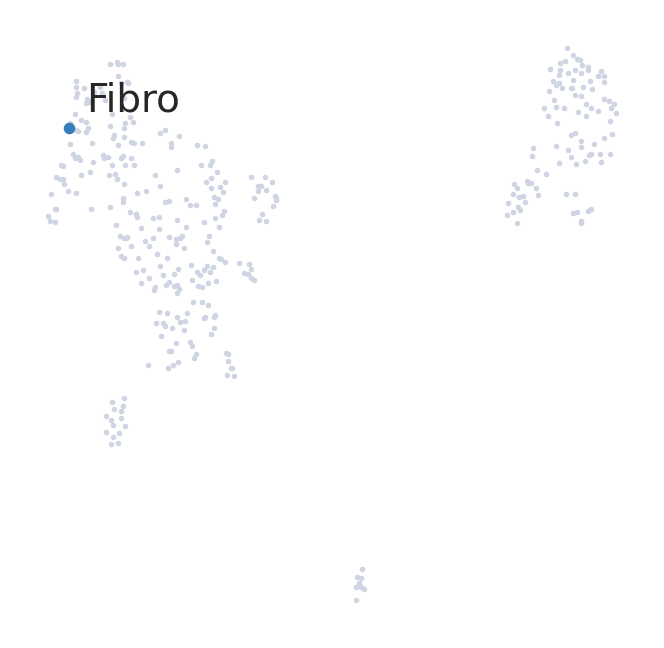

273 2841 YSE


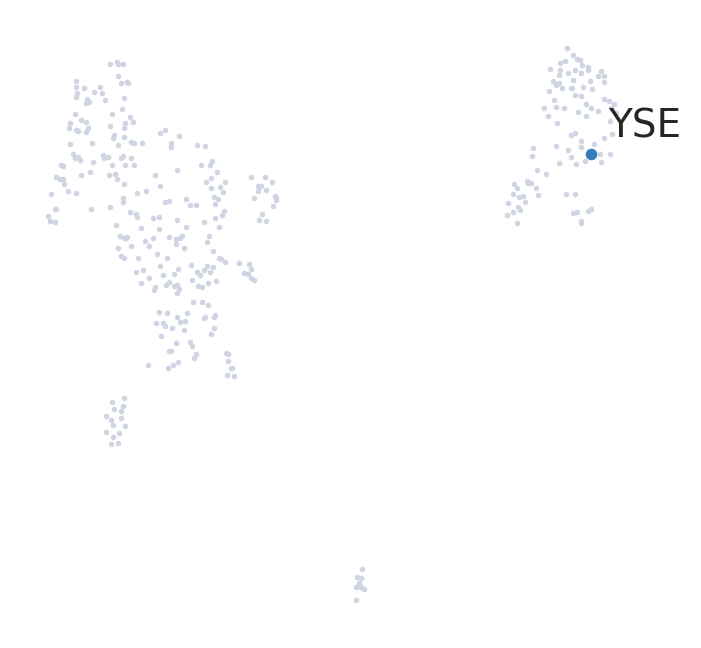

3 31 YSE


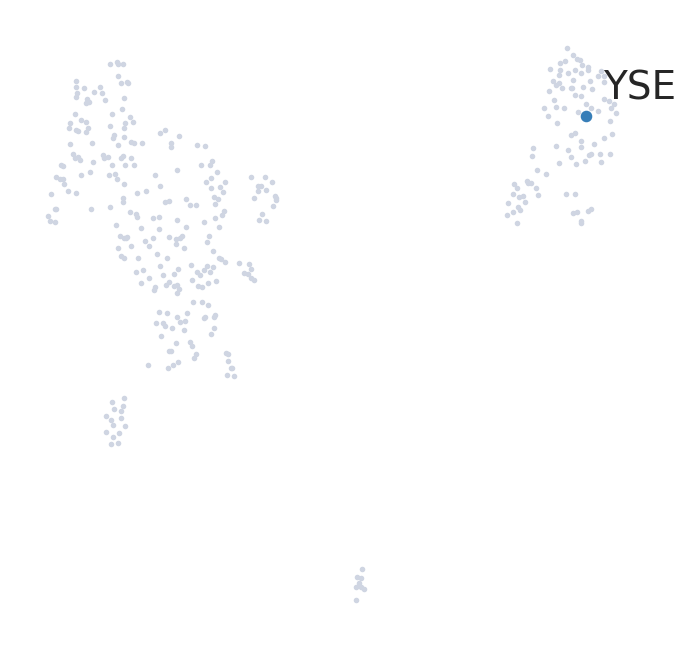

280 2848 YSE


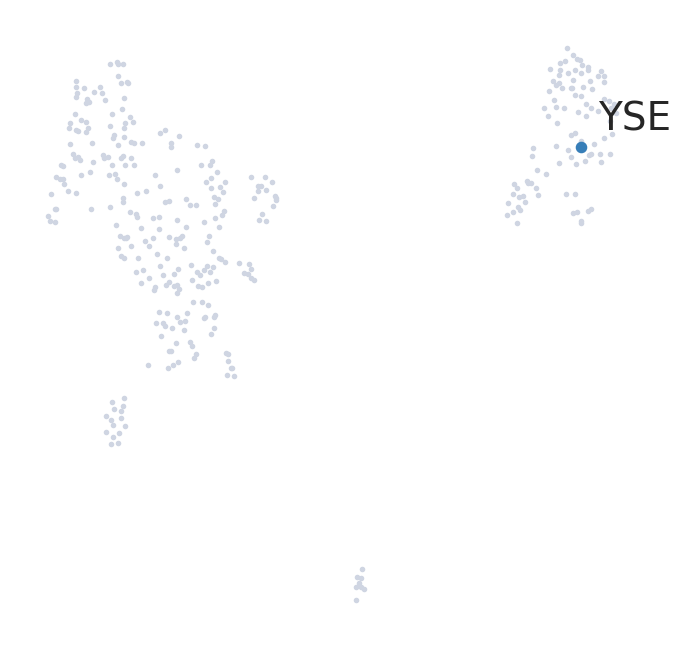

137 1214 YSE


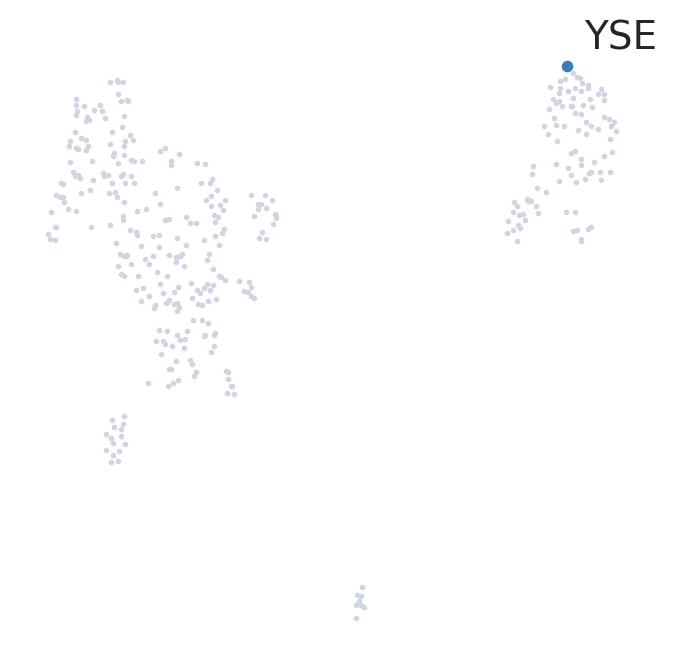

225 2218 YSE


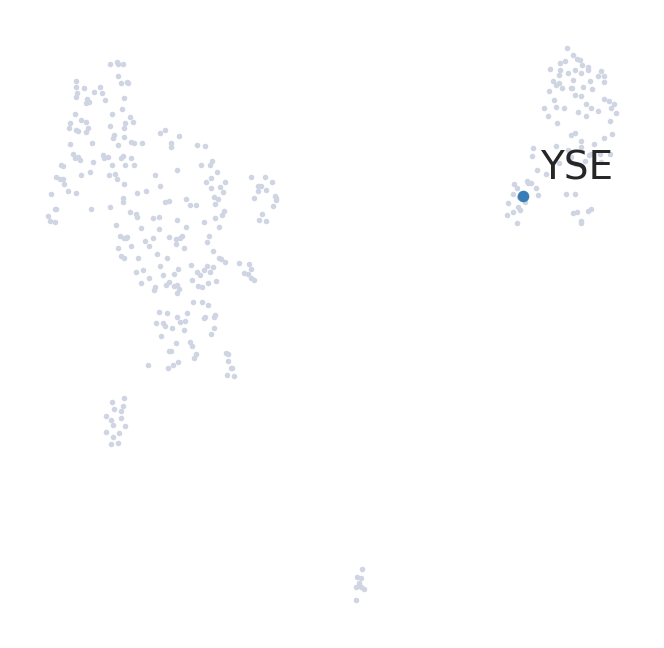

21 185 Endo


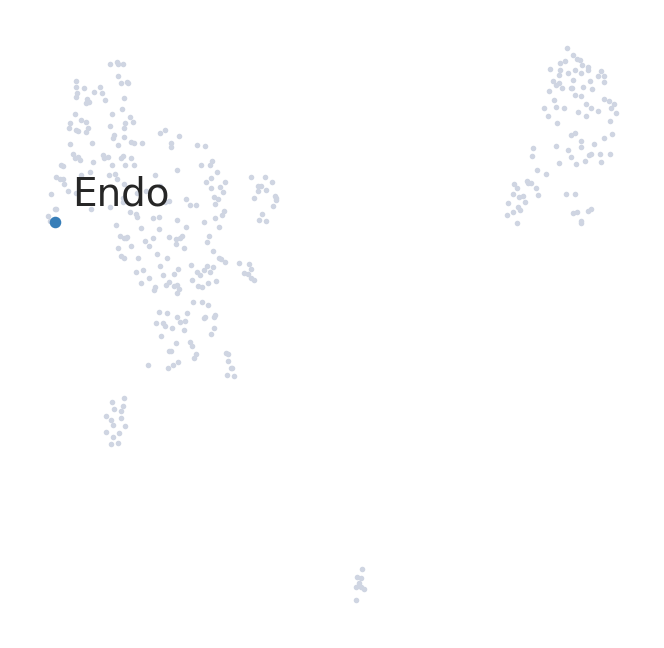

348 3866 Endo


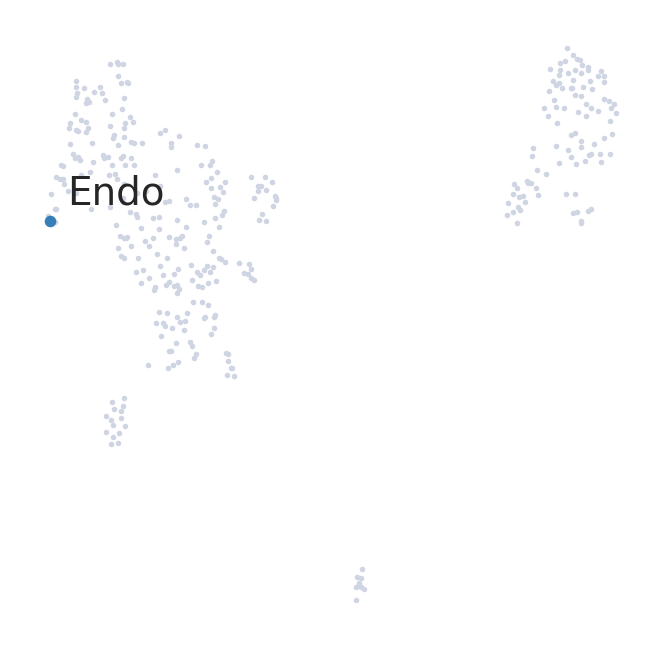

256 2659 Endo


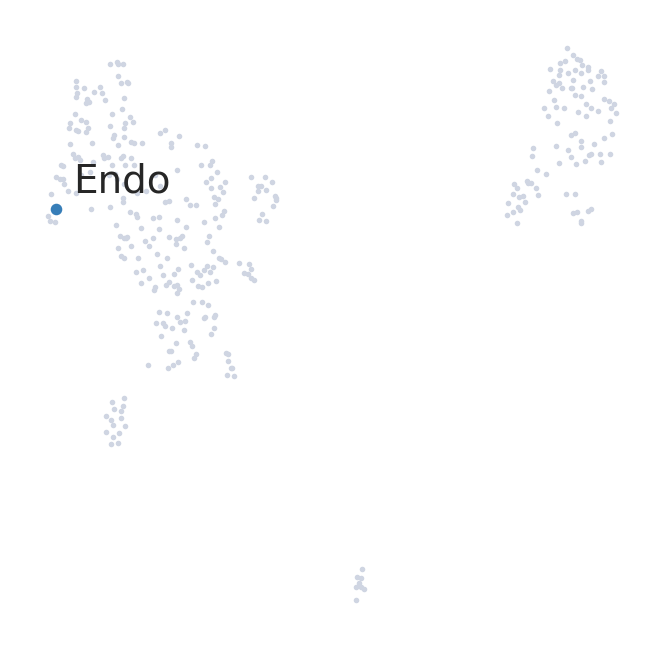

23 187 Endo


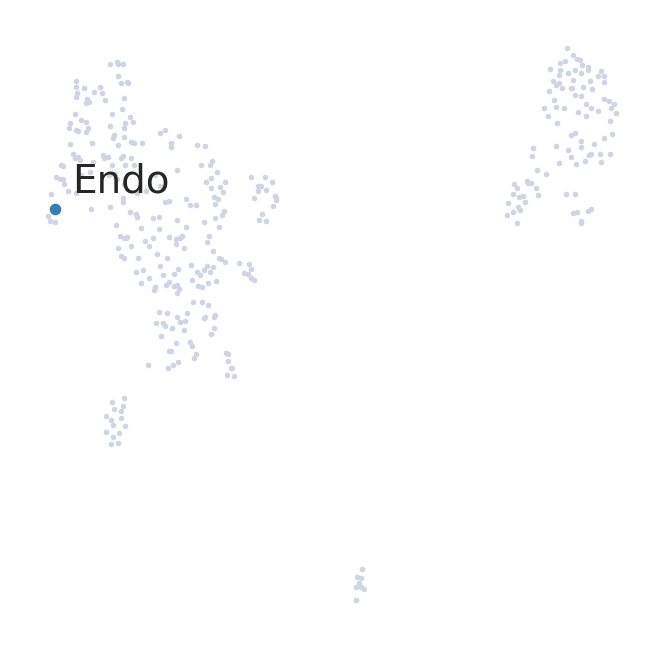

256 2659 Endo


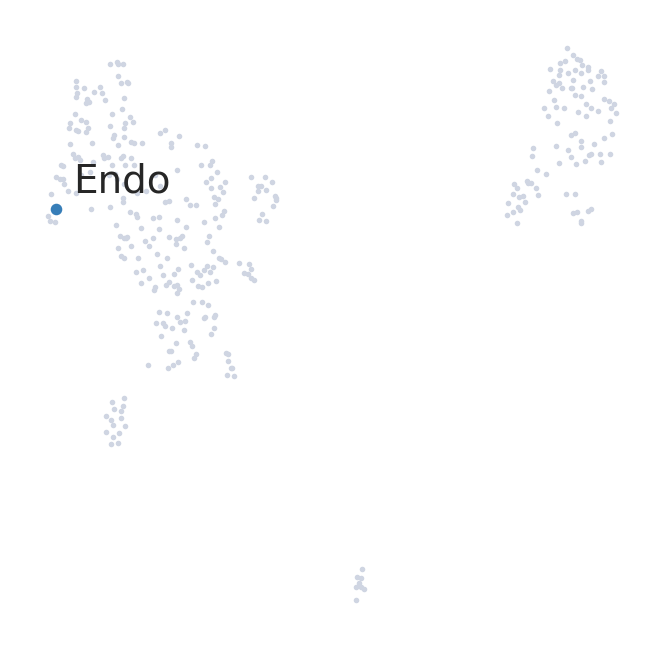

187 1811 Mes-like


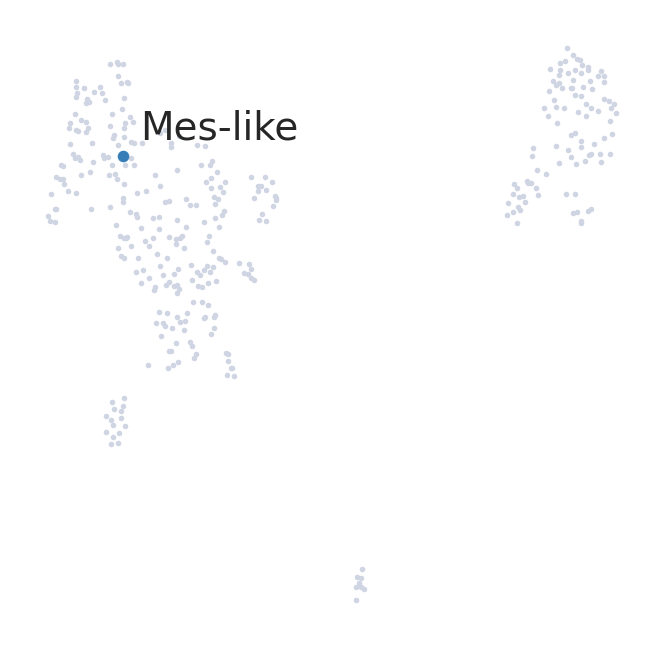

75 707 Mes-like


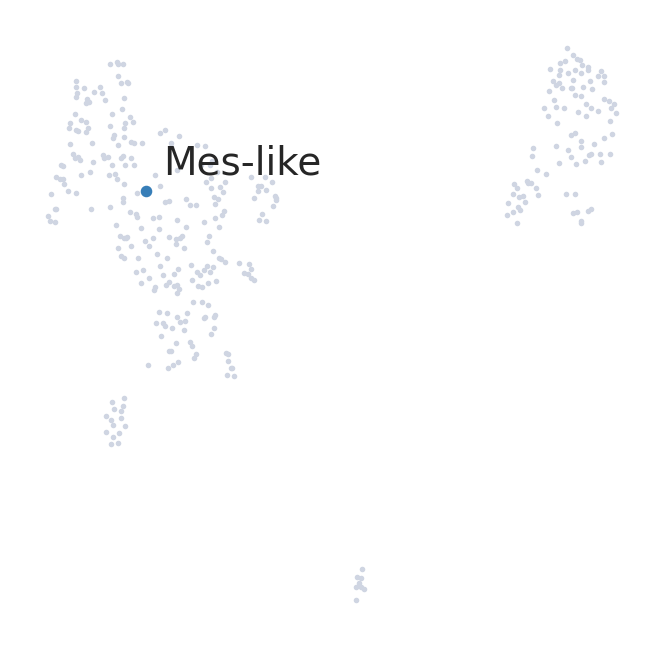

206 2036 Mes-like


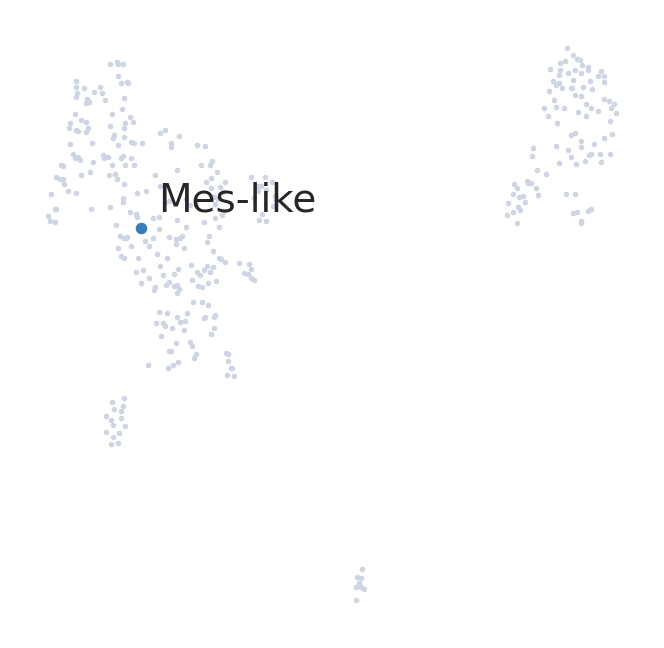

316 3471 Mes-like


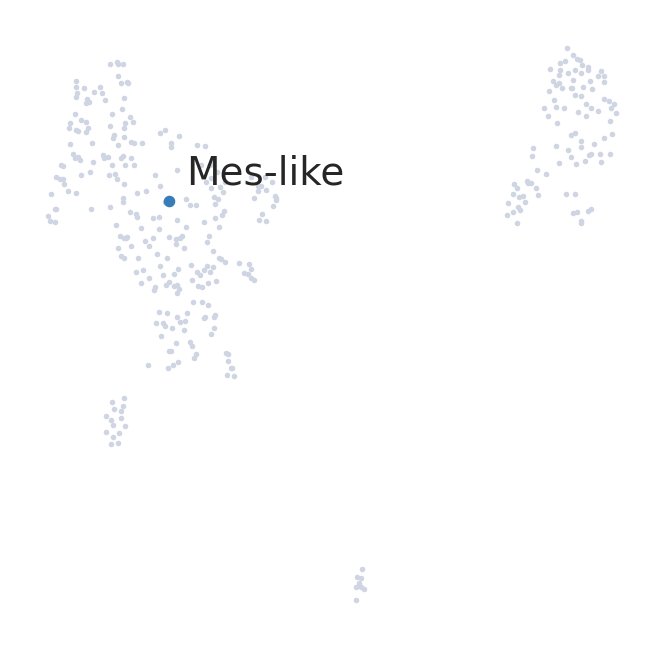

264 2667 Mes-like


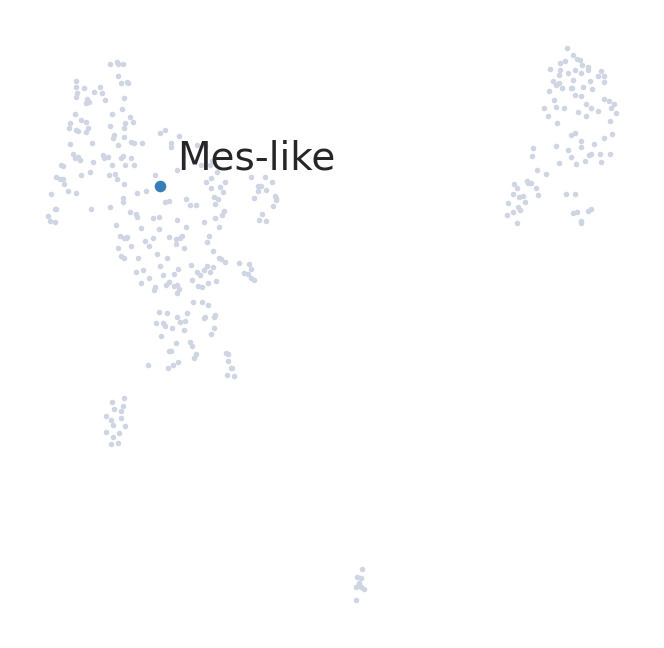

188 1862 PSC-like


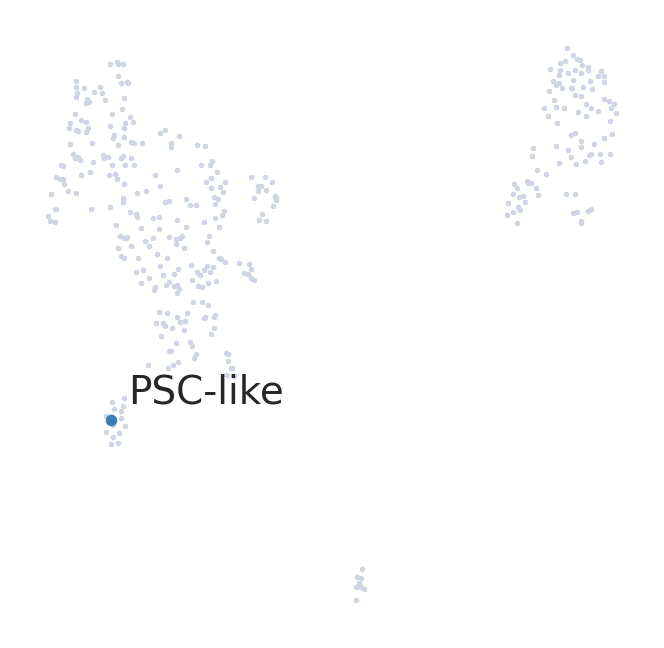

190 1864 PSC-like


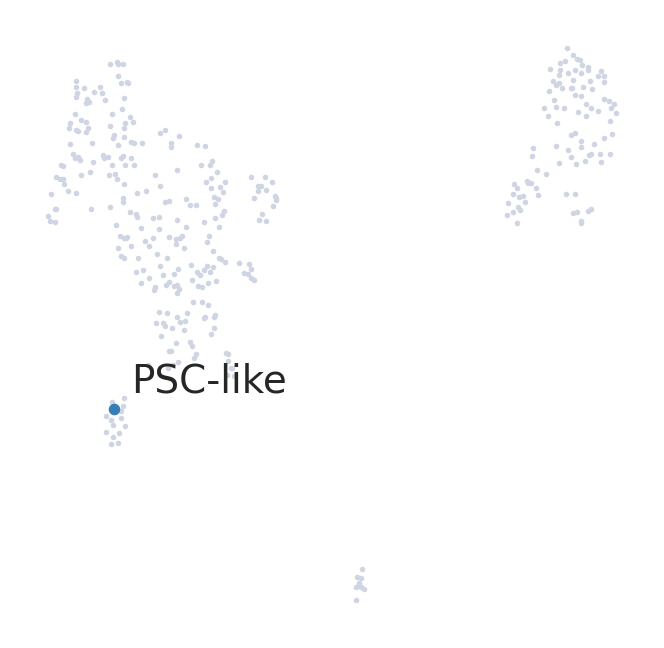

188 1862 PSC-like


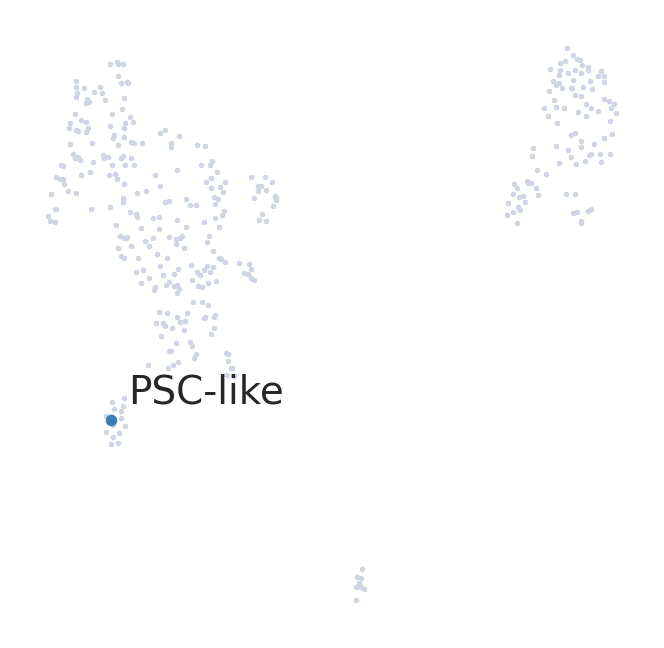

194 1949 PSC-like


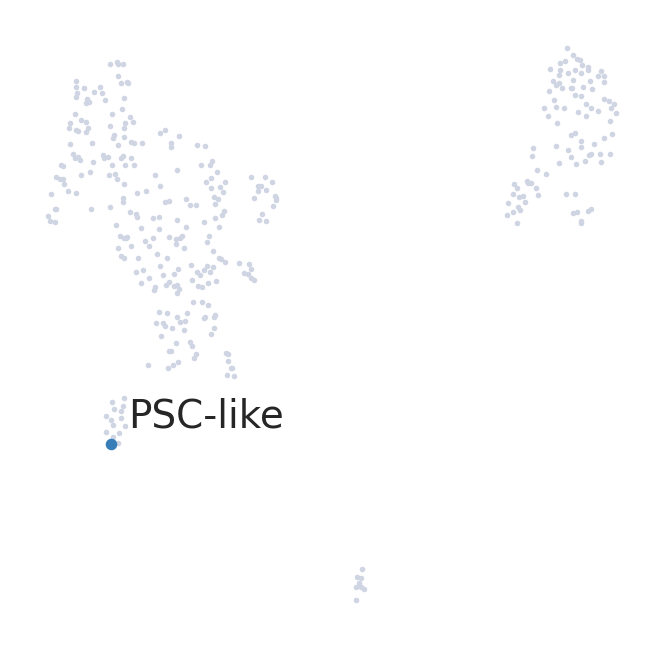

84 818 PSC-like


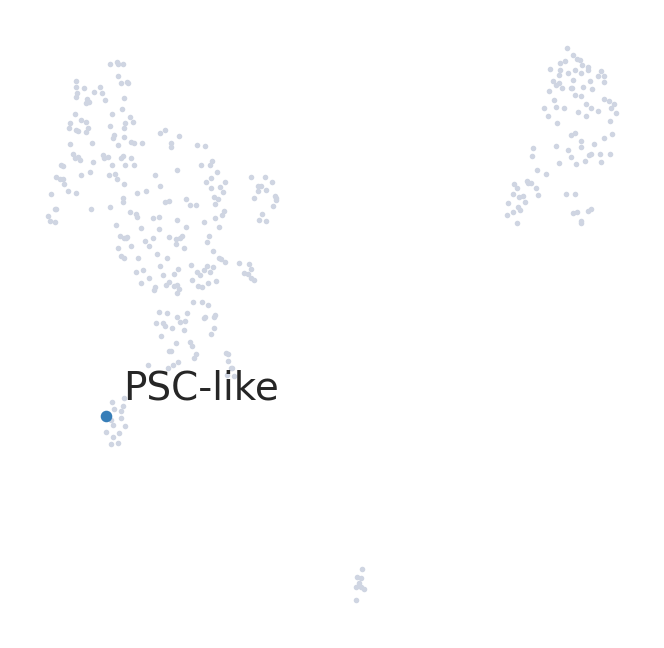

284 2864 TB-like


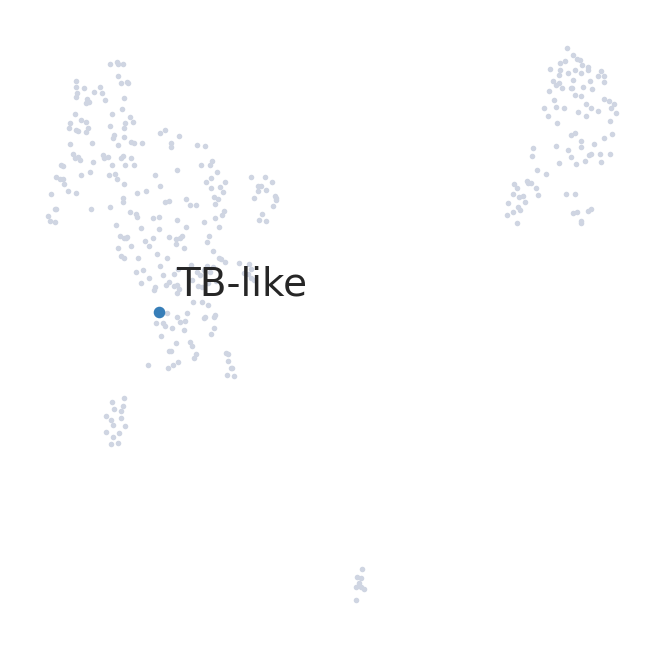

186 1810 TB-like


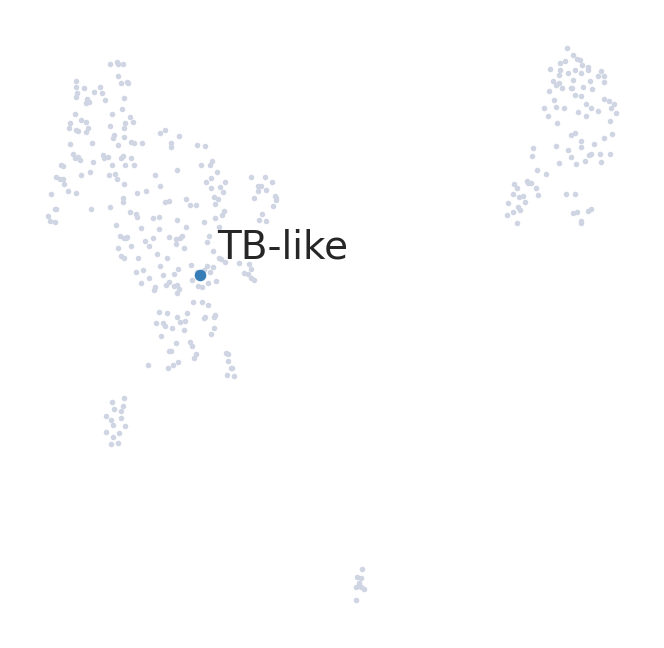

341 3710 TB-like


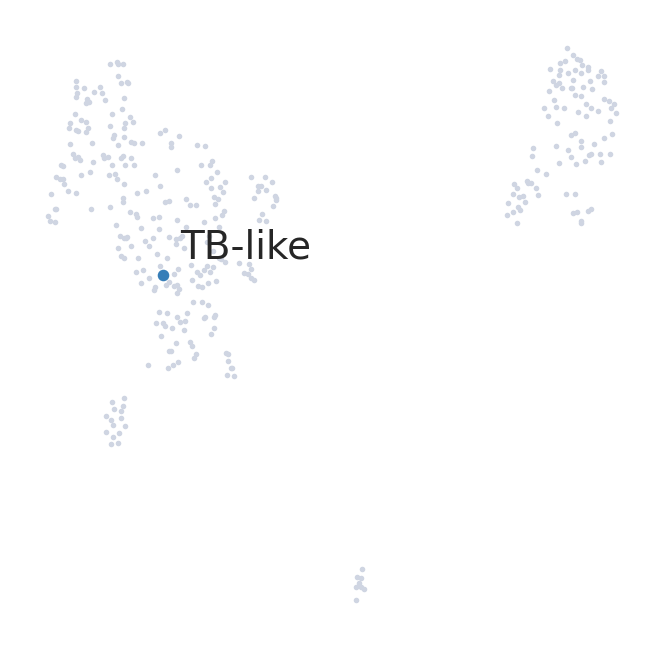

157 1458 TB-like


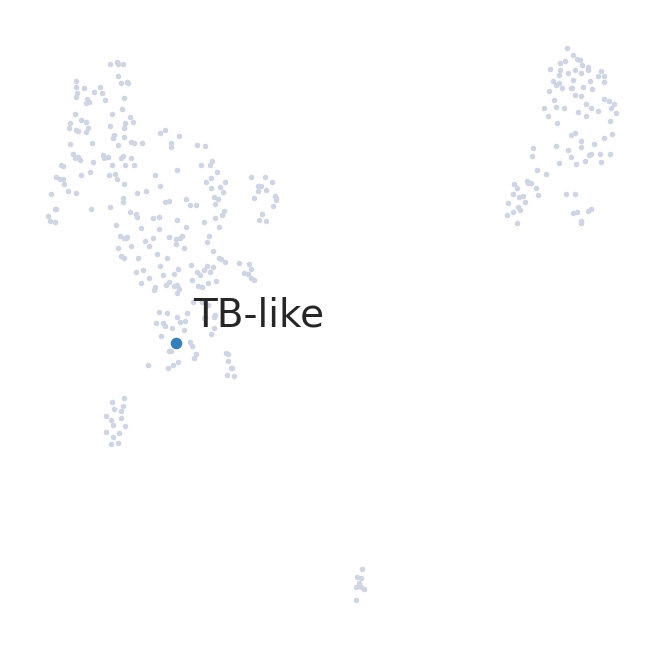

127 1089 TB-like


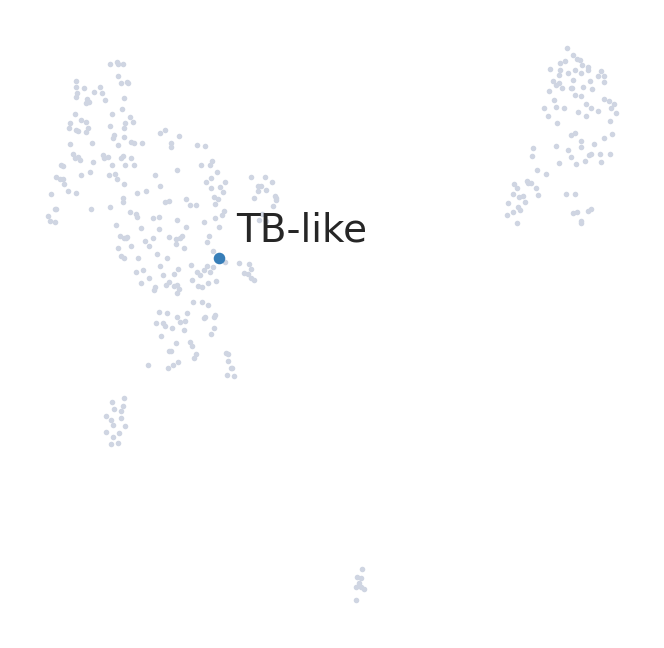

174 1607 CM-like


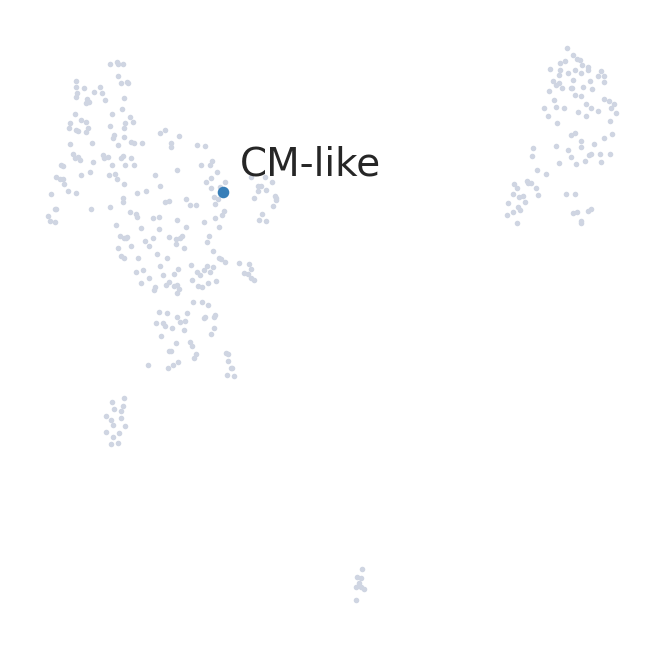

181 1682 CM-like


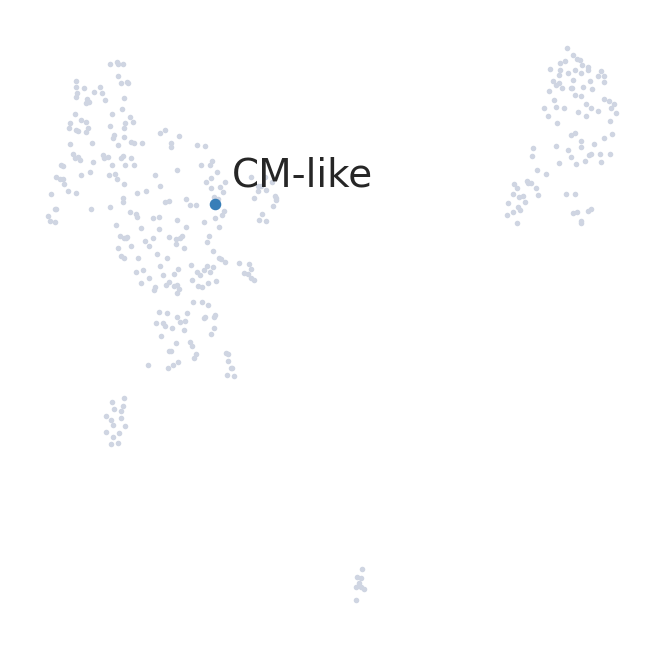

312 3467 CM-like


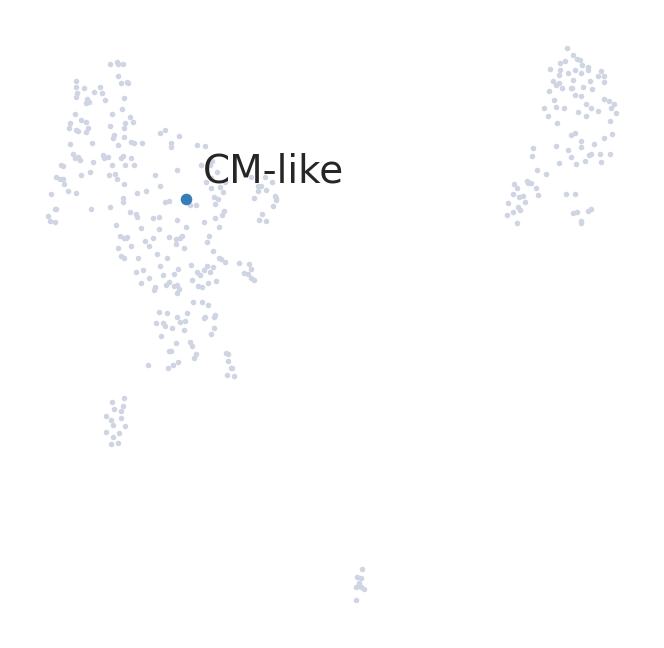

39 419 CM-like


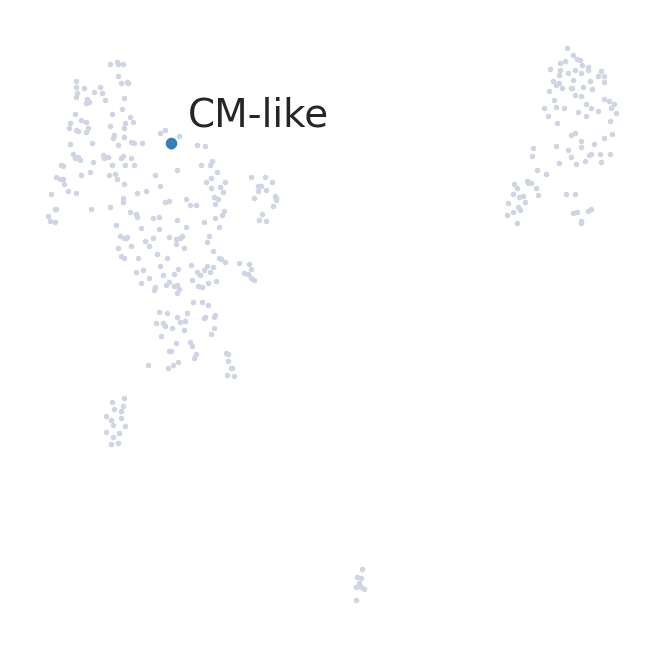

174 1607 CM-like


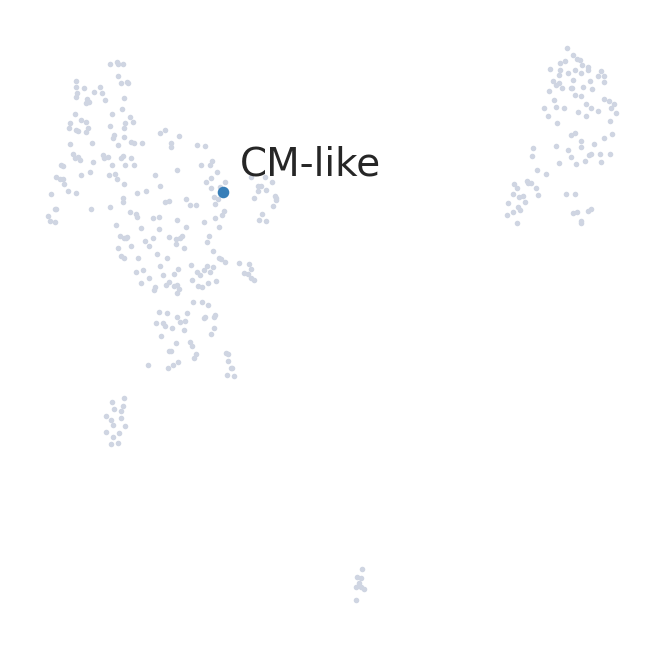

249 2601 HPC


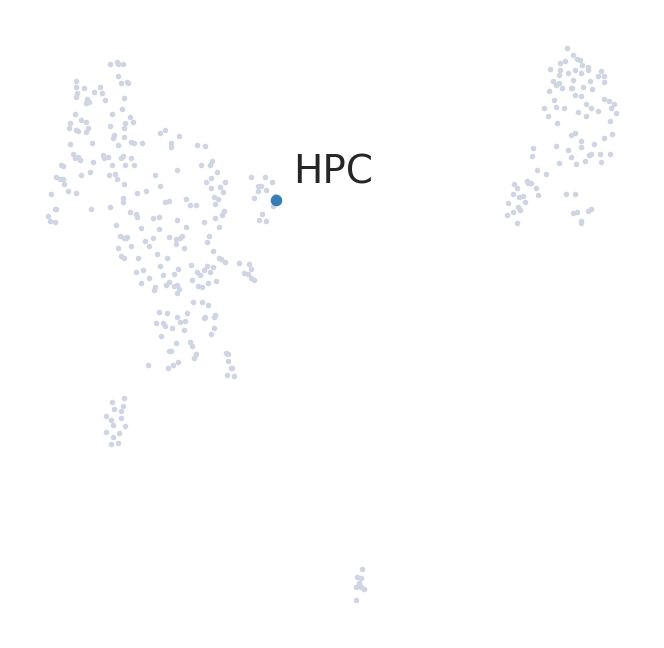

249 2601 HPC


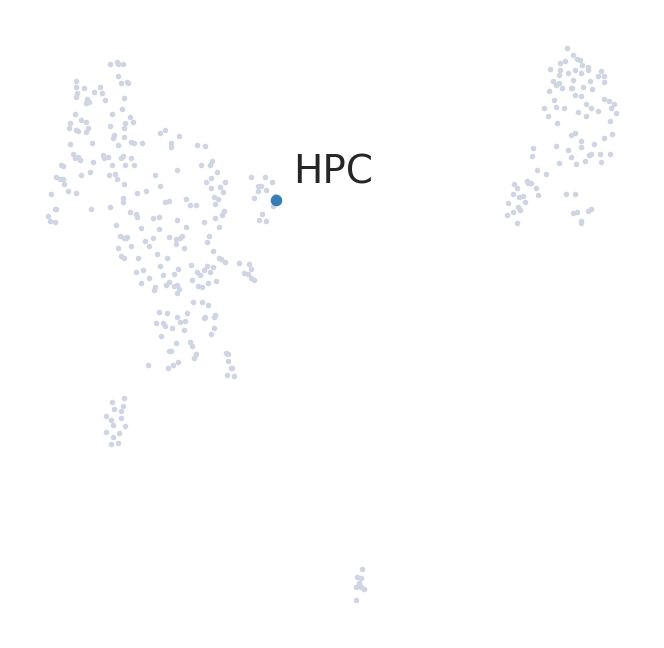

252 2604 HPC


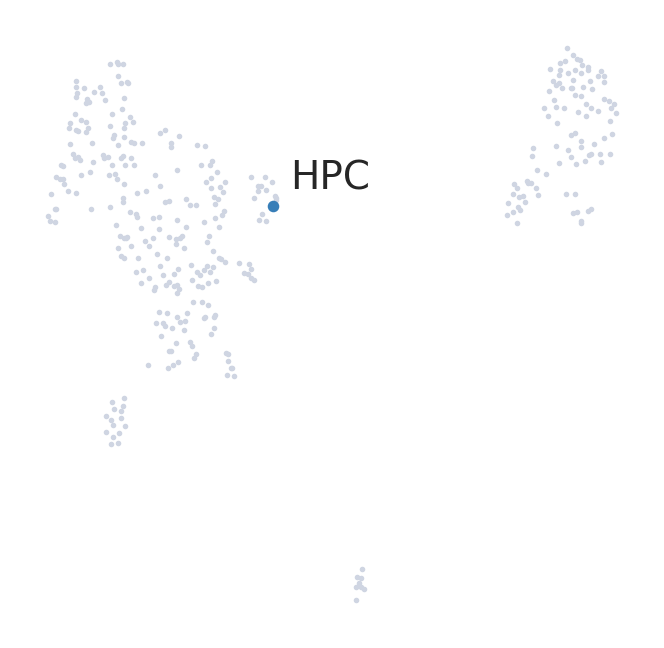

252 2604 HPC


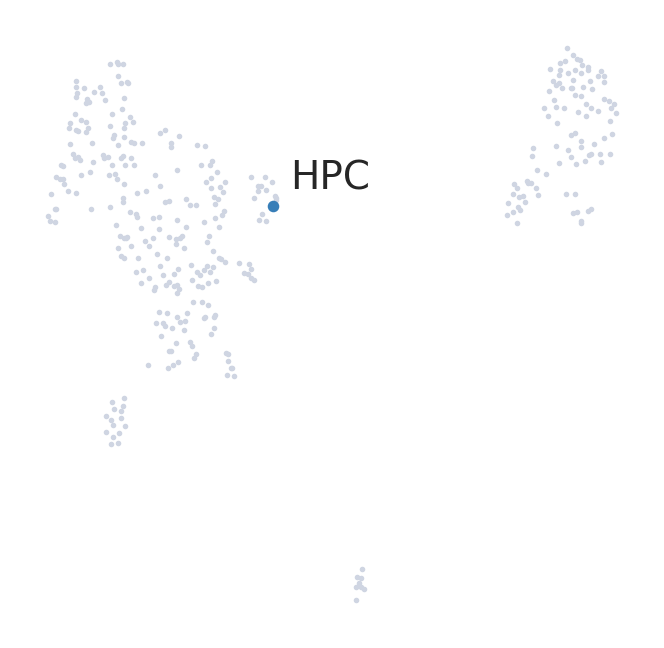

248 2600 HPC


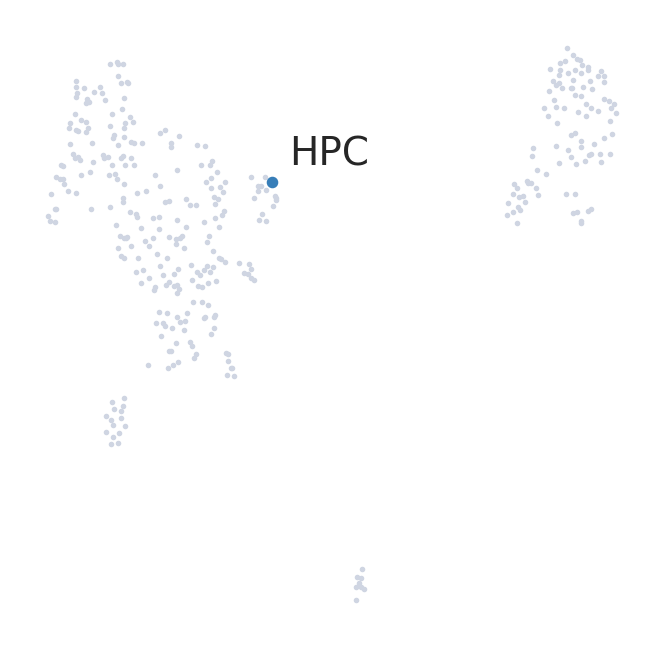

17 181 MEP


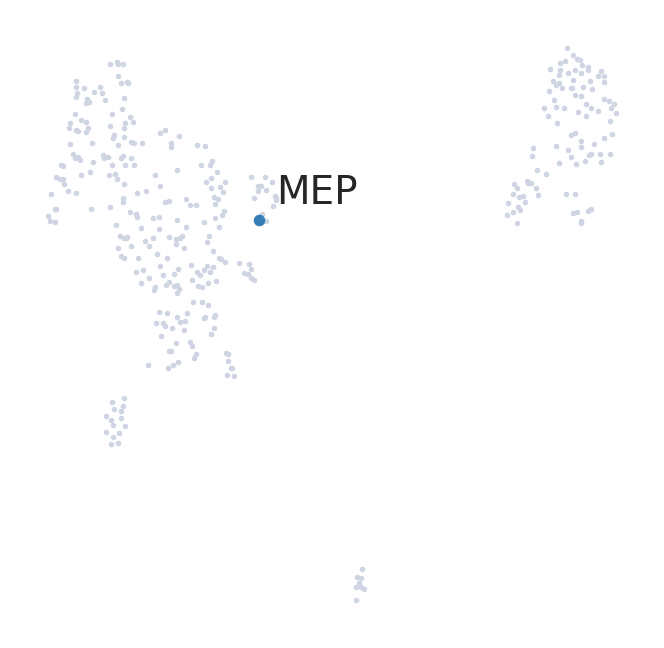

17 181 MEP


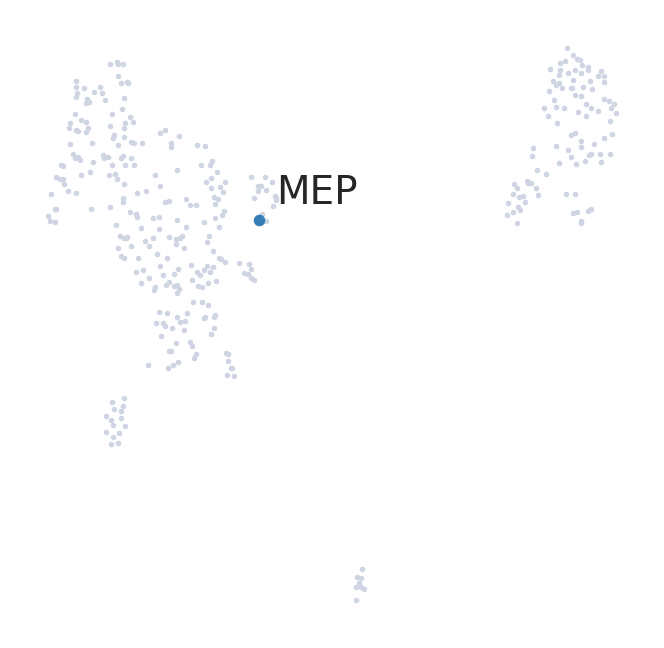

17 181 MEP


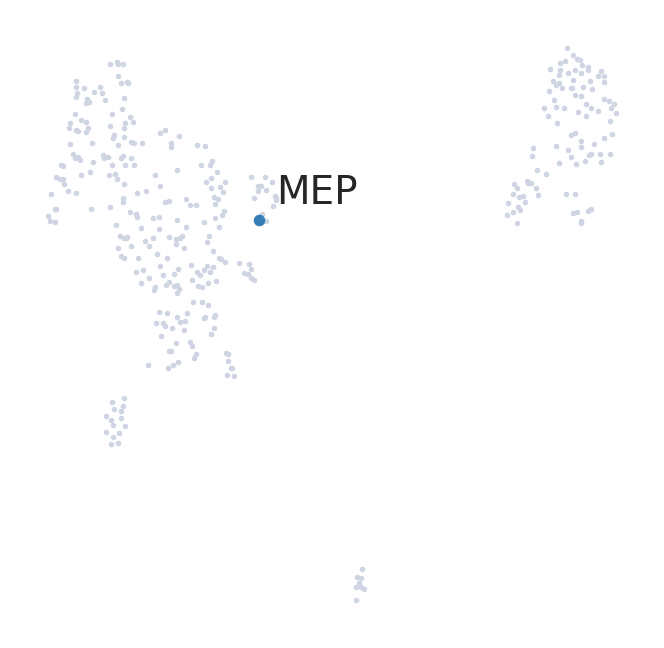

22 186 MEP


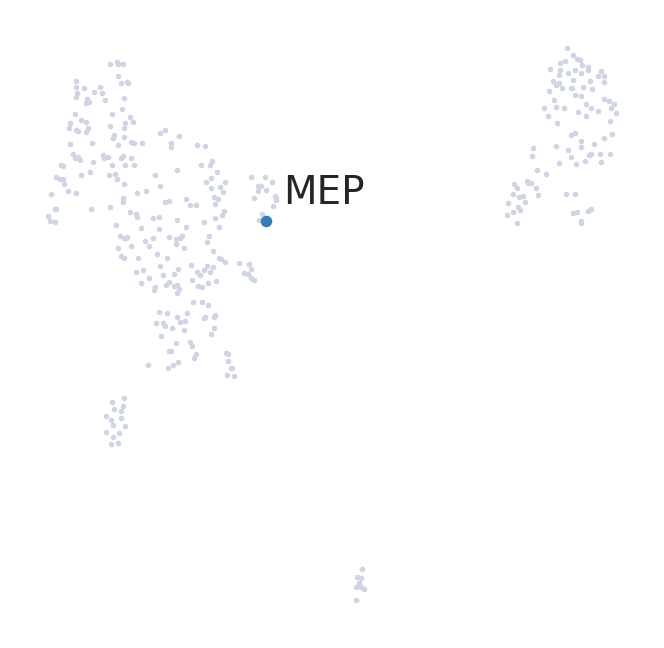

17 181 MEP


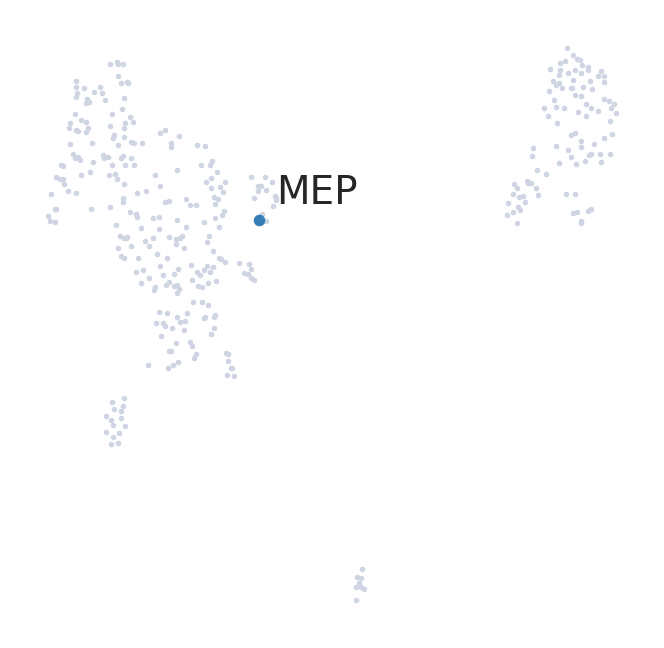

In [1487]:
import random

# tar_i = ["Fibro", "YSE", "HPC", "Endo", "Mes-like", 'PSC-like']
tar_i = ["Fibro", "YSE", "Endo", "Mes-like", 'PSC-like', "TB-like", "CM-like", "HPC", "MEP"]
for _ni in tar_i:
    # _i = 0
    # print(_i, c_adata.obs_names)
    _tmp_l = np.flatnonzero(_sadata.obs['discrete_label_ct']  == _ni)
    
    __i = random.choices(population=_tmp_l, k=5)
    for _i in __i:
        _tar_o = _sadata.obs_names[_i]
        print(_i, _tar_o, _ni)
        terminal_states = pd.Series(
            [_ni],
            index=[_tar_o]
        )
        
        palantir.plot.highlight_cells_on_umap(_sadata, terminal_states)
        plt.show()

# _umap.index[(_umap['x'] <1) & (_umap['x'] >1)]'


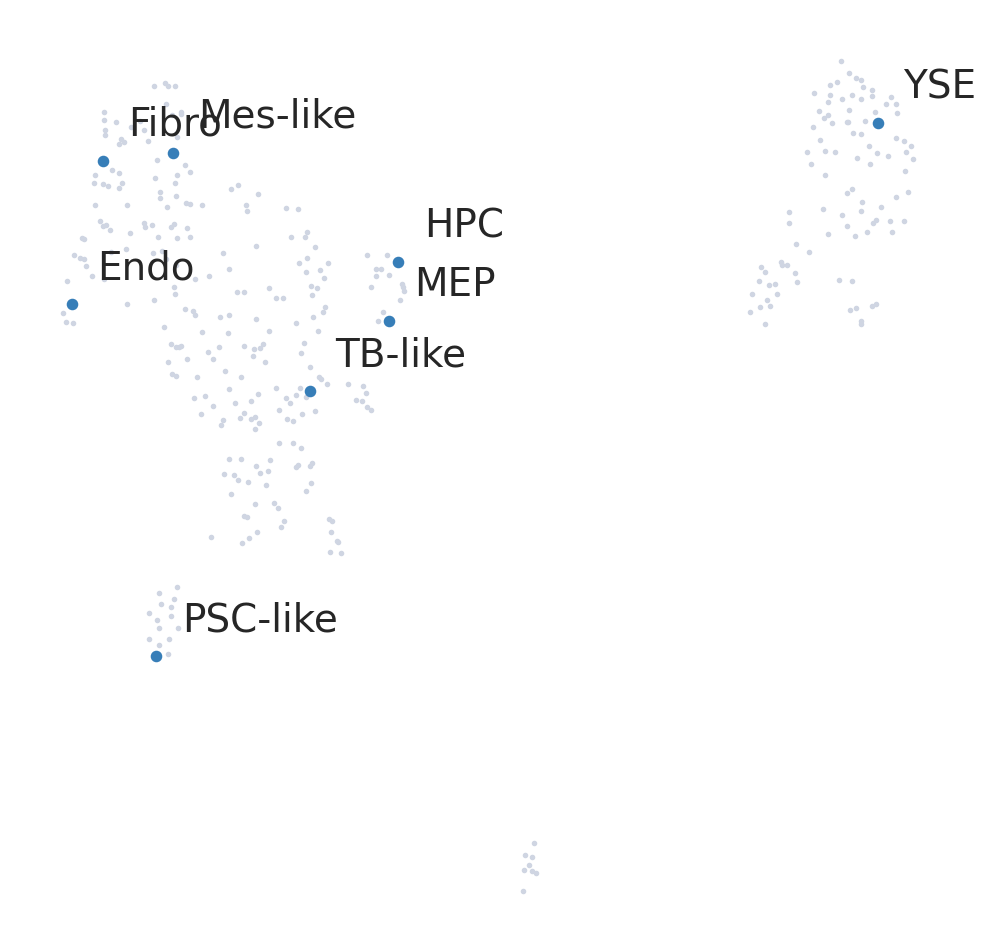

<Figure size 800x800 with 0 Axes>

In [1727]:
terminal_states = pd.Series(
    ["PSC-like", "TB-like", "Fibro", "YSE", "HPC", "MEP", "Endo", "Mes-like"],
    index=['1949', "3451", '690', '33', '2600', '186', '187', '3626'],
)
fig, ax = plt.subplots(figsize=(6, 6))

palantir.plot.highlight_cells_on_umap(_sadata, terminal_states, ax=ax)
plt.show()

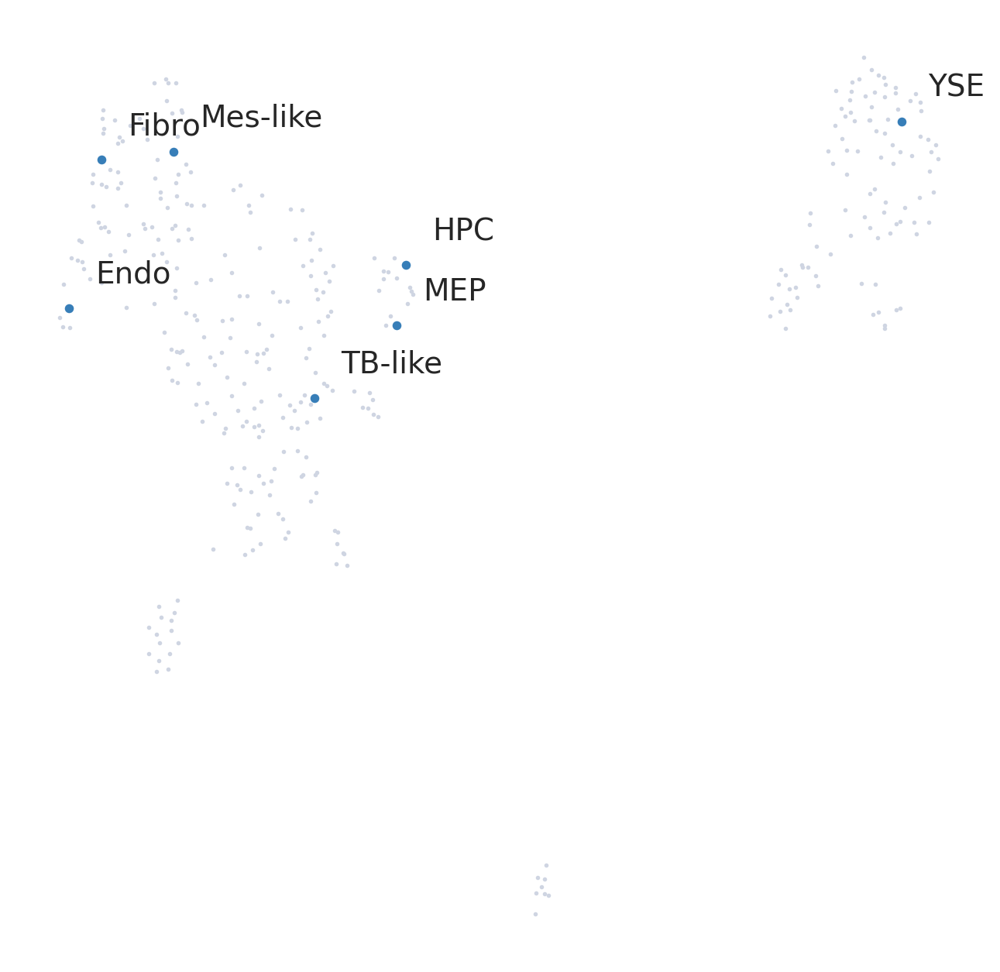

In [1705]:
# hemo 1
terminal_states = pd.Series(
    ["TB-like", "Fibro", "YSE", "HPC", "MEP", "Endo", "Mes-like"],
    index=["3451", '690', '33', '2600', '186', '187', '3626'],
)

palantir.plot.highlight_cells_on_umap(_sadata, terminal_states)
plt.show()

terminal_states = pd.Series(
     ["TB-like", "Fibro", "YSE", "HPC", "MEP", "Endo", "Mes-like"],
    index=["3451", '690', '33', '2600', '186', '187', '3626'],
)

In [1702]:
terminal_states = pd.Series(
    ["Fibro", "YSE", "HPC", "Endo", "Mes-like"],
    index=['690', '33', '2601', '187', '3628'],
)

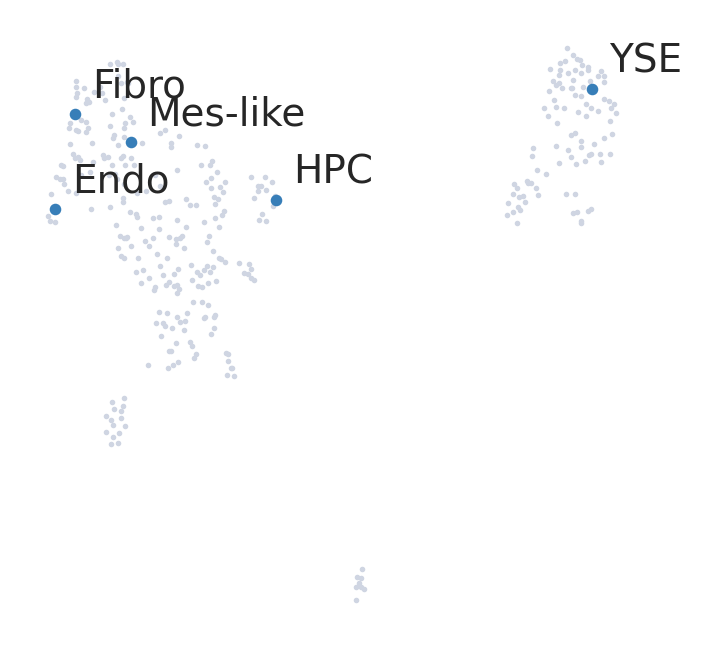

In [1023]:
palantir.plot.highlight_cells_on_umap(_sadata, terminal_states)
plt.show()

In [1709]:
# hemo 5
start_cell = "1949"
# # hemo 1
# start_cell = "1358"
pr_res = palantir.core.run_palantir(
    _sadata, start_cell, num_waypoints=50, terminal_states=terminal_states, knn=15
)

Sampling and flocking waypoints...
Time for determining waypoints: 8.02318255106608e-05 minutes
Determining pseudotime...
Shortest path distances using 15-nearest neighbor graph...
Time for shortest paths: 0.0037178913752237957 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 0.9993
Correlation at iteration 2: 0.9999
Correlation at iteration 3: 1.0000
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


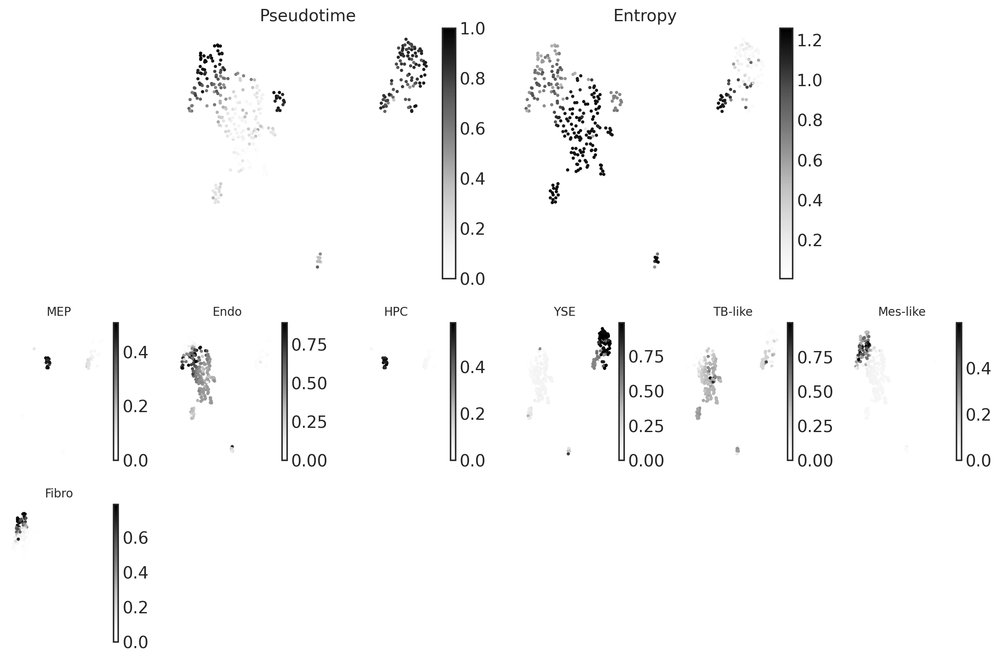

In [1710]:
palantir.plot.plot_palantir_results(_sadata, s=3)
plt.show()

In [1061]:
sc.tl.diffmap(_sadata)


computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.99007004 0.9862571  0.98385626 0.97922444 0.9591484
     0.94843024 0.93875474 0.92875266 0.9175573  0.9036211  0.8868677
     0.88226664 0.8739223  0.87143433]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:00)


In [1062]:
_sadata.obsm['X_diffmap'][:, 3].argmax()

109

/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/scvelo/plotting/scatter.py:656: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


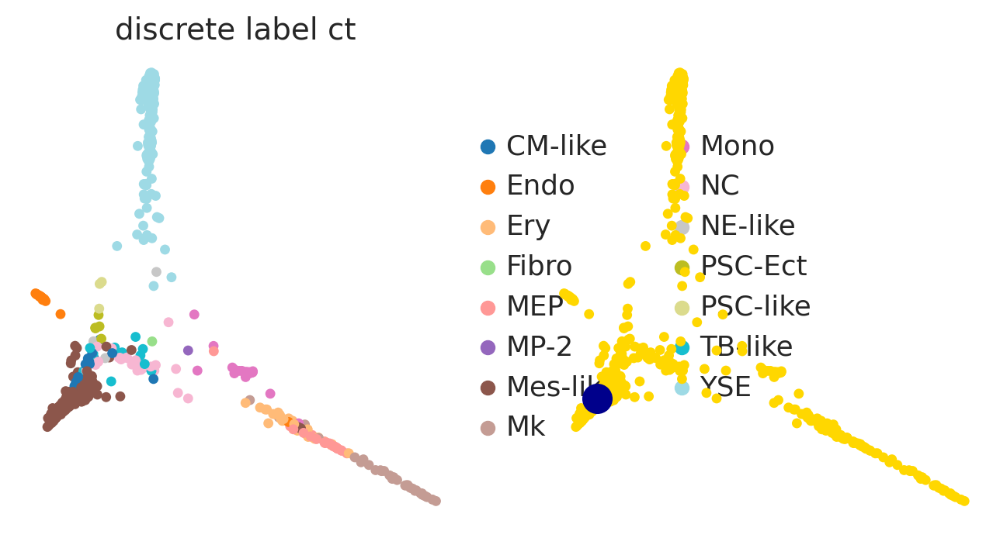

In [1064]:
root_ixs = 277  # has been found using `adata.obsm['X_diffmap'][:, 3].argmax()`
scv.pl.scatter(
    _sadata,
    basis="diffmap",
    c=["discrete_label_ct", root_ixs],
    legend_loc="right",
    components=["2,3"],
)


In [1065]:
sc.tl.dpt(_sadata)

computing Diffusion Pseudotime using n_dcs=10
    finished: added
    'dpt_pseudotime', the pseudotime (adata.obs) (0:00:00)


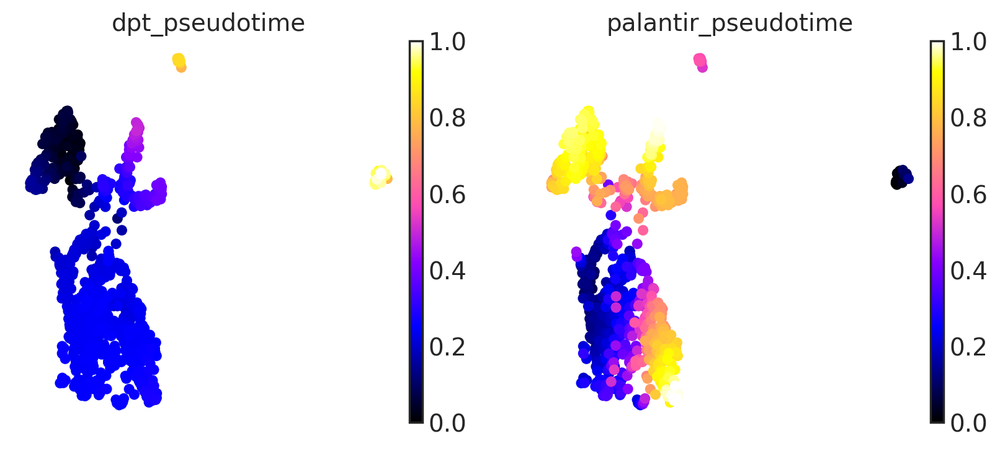

In [1066]:
sc.pl.embedding(
    _sadata,
    basis="umap",
    color=["dpt_pseudotime", "palantir_pseudotime"],
    color_map="gnuplot2",
)

In [1712]:
import numpy as np

import cellrank as cr
import scanpy as sc
import scvelo as scv

# scv.settings.verbosity = 3
# scv.settings.set_figure_params("scvelo")
# sc.settings.set_figure_params(frameon=False, dpi=100)
# cr.settings.verbosity = 2

In [1713]:
pk = cr.kernels.PseudotimeKernel(_sadata, time_key="palantir_pseudotime")
pk.compute_transition_matrix()

print(pk)

Computing transition matrix based on pseudotime


  0%|          | 0/363 [00:00<?, ?cell/s]

    Finish (0:00:00)
PseudotimeKernel[n=363]


Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:00)


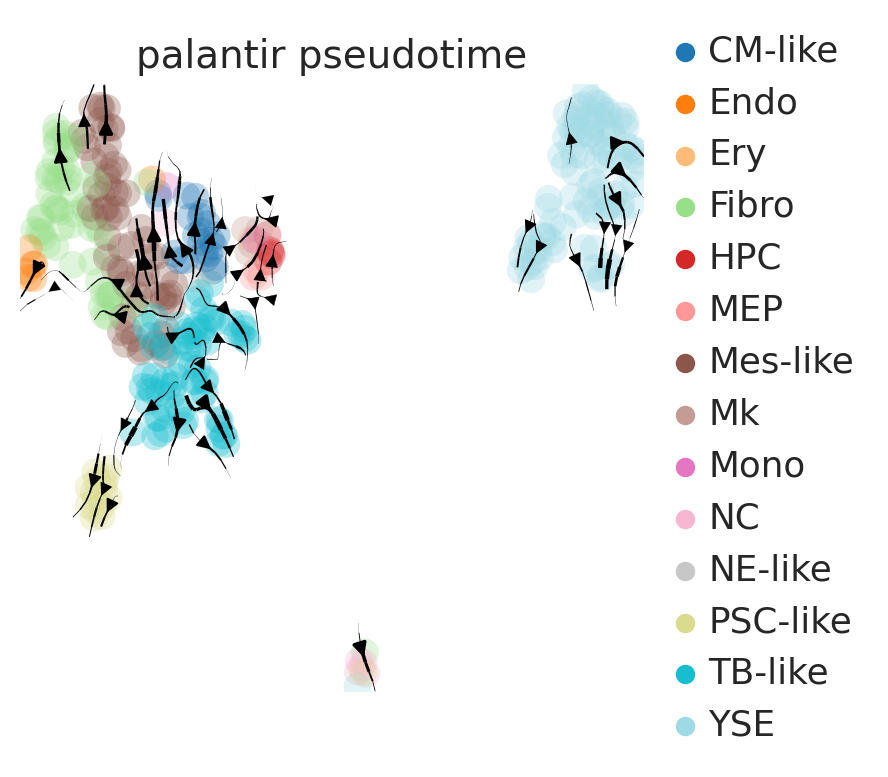

In [1725]:
fig, ax = plt.subplots(figsize=(4, 4))

pk.plot_projection(basis="umap", recompute=True, stream=True, color='discrete_label_ct', ax=ax, s=400, title="palantir pseudotime", legend_loc = 'right margin')


## cells = [
    "2845",
    "1051",
    "3750",
]
palantir.plot.plot_terminal_state_probs(_sadata, cells)
plt.show()


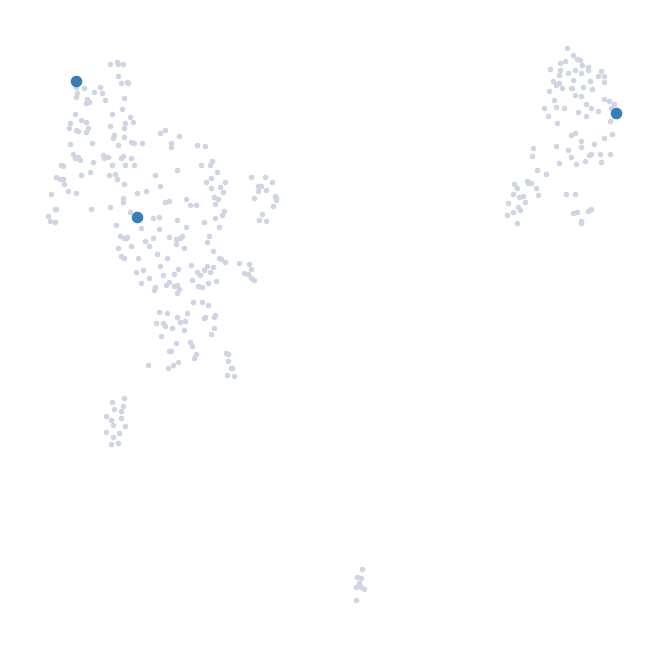

In [1528]:
palantir.plot.highlight_cells_on_umap(_sadata, cells)
plt.show()

In [1715]:
masks = palantir.presults.select_branch_cells(_sadata, q=.01, eps=.01)


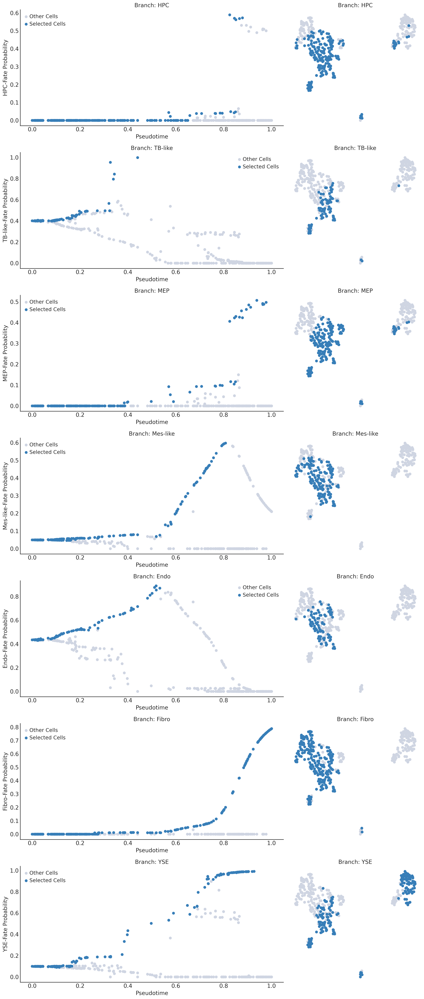

In [1716]:
palantir.plot.plot_branch_selection(_sadata)
plt.show()

[2025-03-07 15:43:08,503] [INFO    ] Using sparse Gaussian Process since n_landmarks (50) < n_samples (171) and rank = 1.0.
[2025-03-07 15:43:08,505] [INFO    ] Using covariance function Matern52(ls=1.4753418922424317).
[2025-03-07 15:43:08,536] [INFO    ] Computing 50 landmarks with k-means clustering.
[2025-03-07 15:43:09,341] [INFO    ] Sigma interpreted as element-wise standard deviation.


<Axes: title={'center': 'Branch: YSE'}>

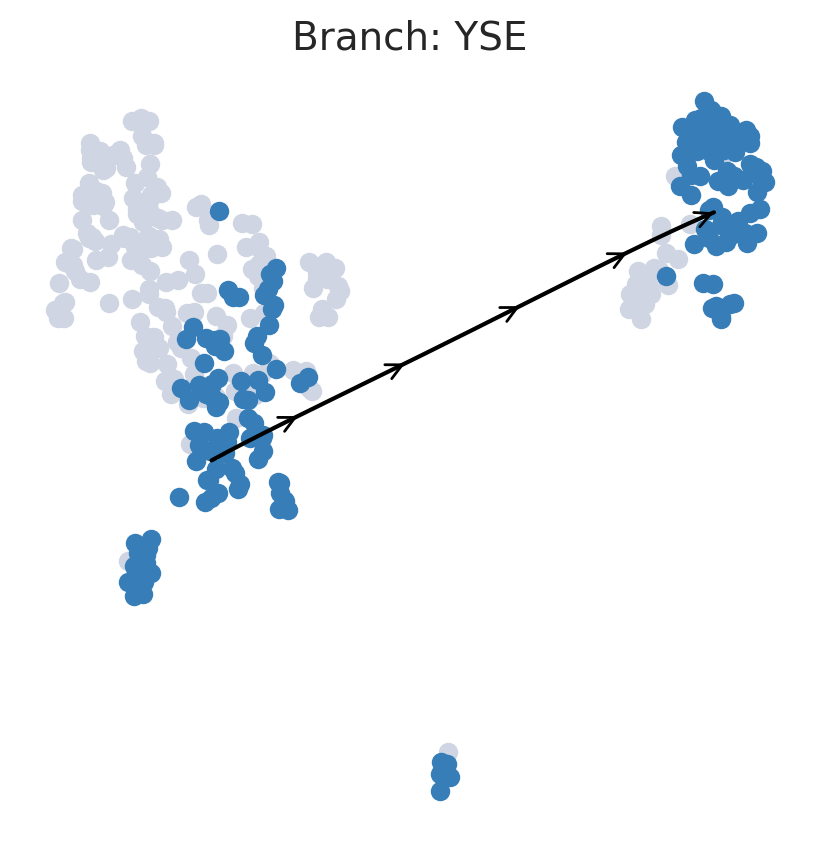

In [1717]:
palantir.plot.plot_trajectory(_sadata, "YSE")



[2025-03-07 15:43:11,560] [INFO    ] Using sparse Gaussian Process since n_landmarks (50) < n_samples (171) and rank = 1.0.
[2025-03-07 15:43:11,562] [INFO    ] Using covariance function Matern52(ls=1.4753418922424317).
[2025-03-07 15:43:11,563] [INFO    ] Computing 50 landmarks with k-means clustering.
[2025-03-07 15:43:11,607] [INFO    ] Sigma interpreted as element-wise standard deviation.


<Axes: title={'center': 'Branch: YSE'}, xlabel='UMAP1', ylabel='UMAP2'>

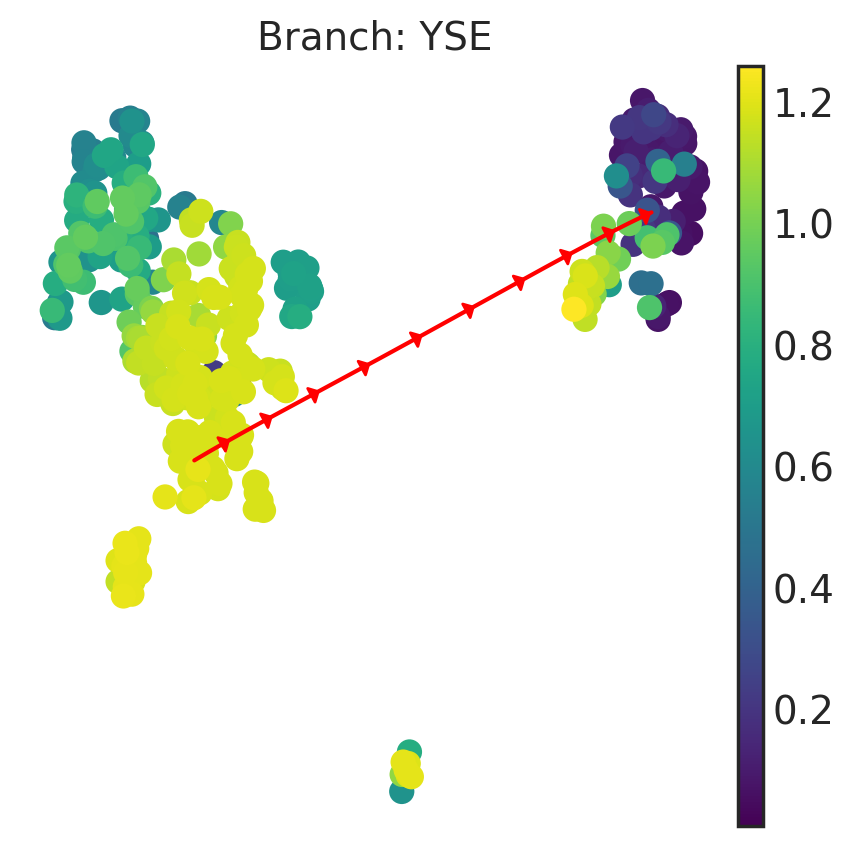

In [1718]:
palantir.plot.plot_trajectory(
    _sadata,
    "YSE",
    cell_color="palantir_entropy",
    n_arrows=10,
    color="red",
    scanpy_kwargs=dict(cmap="viridis"),
    arrowprops=dict(arrowstyle="-|>,head_length=.2,head_width=.2"),
)

[2025-03-07 15:43:14,535] [INFO    ] Using sparse Gaussian Process since n_landmarks (50) < n_samples (209) and rank = 1.0.
[2025-03-07 15:43:14,537] [INFO    ] Using covariance function Matern52(ls=1.4753418922424317).
[2025-03-07 15:43:14,538] [INFO    ] Computing 50 landmarks with k-means clustering.
[2025-03-07 15:43:14,571] [INFO    ] Sigma interpreted as element-wise standard deviation.


<Axes: title={'center': 'Branch: HPC'}, xlabel='UMAP1', ylabel='UMAP2'>

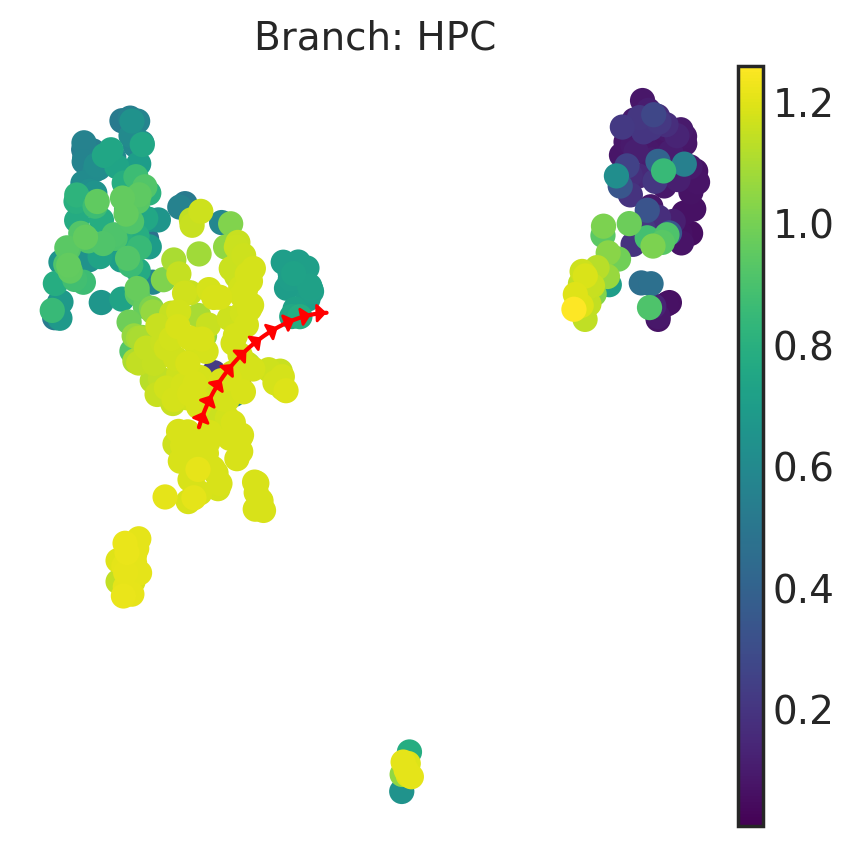

In [1719]:
palantir.plot.plot_trajectory(
    _sadata,
    "HPC",
    cell_color="palantir_entropy",
    n_arrows=10,
    color="red",
    scanpy_kwargs=dict(cmap="viridis"),
    arrowprops=dict(arrowstyle="-|>,head_length=.2,head_width=.2"),
)

[2025-03-07 15:43:17,143] [INFO    ] Using sparse Gaussian Process since n_landmarks (50) < n_samples (160) and rank = 1.0.
[2025-03-07 15:43:17,144] [INFO    ] Using covariance function Matern52(ls=1.4753418922424317).
[2025-03-07 15:43:17,175] [INFO    ] Computing 50 landmarks with k-means clustering.
[2025-03-07 15:43:17,922] [INFO    ] Sigma interpreted as element-wise standard deviation.


<Axes: title={'center': 'Branch: Mes-like'}, xlabel='UMAP1', ylabel='UMAP2'>

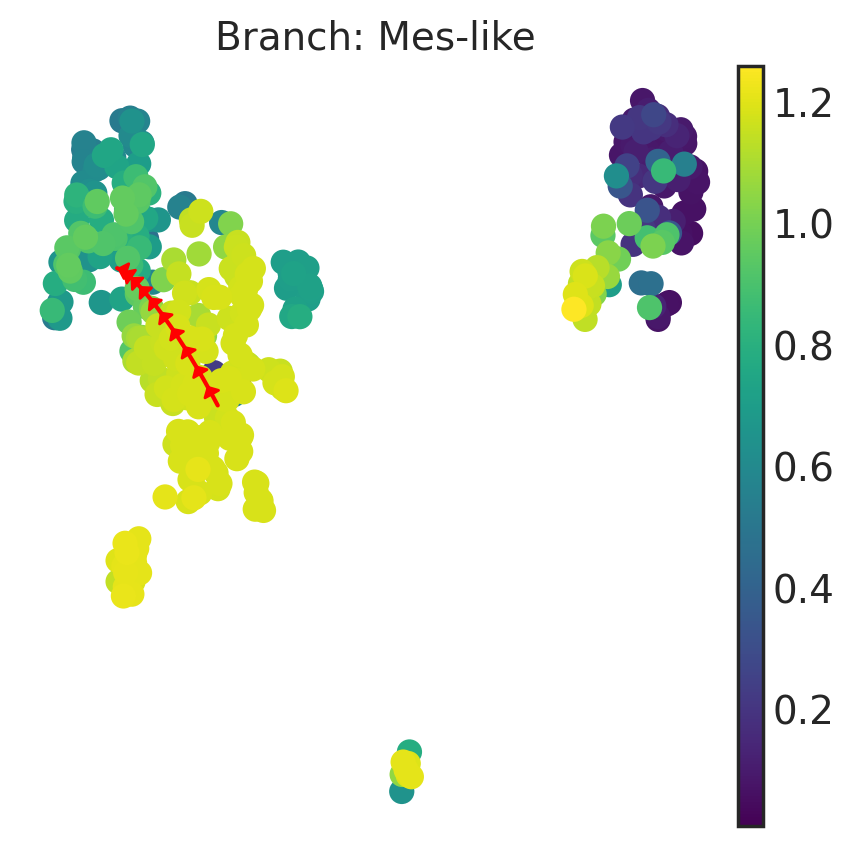

In [1720]:
palantir.plot.plot_trajectory(
    _sadata,
    "Mes-like",
    cell_color="palantir_entropy",
    n_arrows=10,
    color="red",
    scanpy_kwargs=dict(cmap="viridis"),
    arrowprops=dict(arrowstyle="-|>,head_length=.2,head_width=.2"),
)

[2025-03-07 15:43:22,130] [INFO    ] Using sparse Gaussian Process since n_landmarks (50) < n_samples (88) and rank = 1.0.
[2025-03-07 15:43:22,131] [INFO    ] Using covariance function Matern52(ls=1.4753418922424317).
[2025-03-07 15:43:22,161] [INFO    ] Computing 50 landmarks with k-means clustering.
[2025-03-07 15:43:22,893] [INFO    ] Sigma interpreted as element-wise standard deviation.


<Axes: title={'center': 'Branch: Endo'}, xlabel='UMAP1', ylabel='UMAP2'>

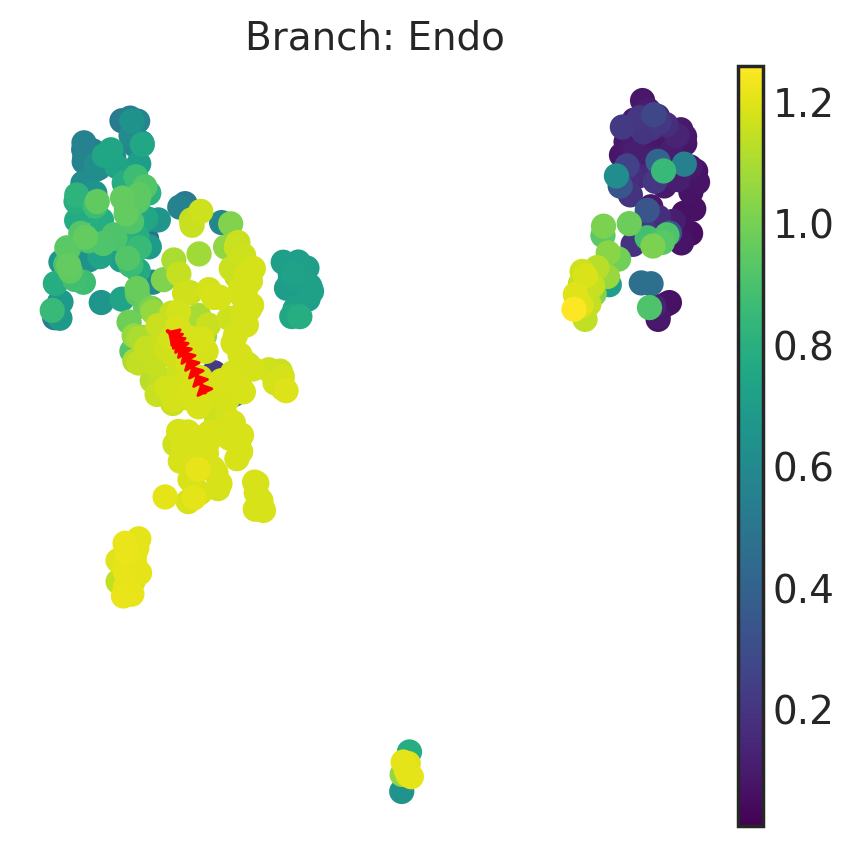

In [1721]:
palantir.plot.plot_trajectory(
    _sadata,
    "Endo",
    cell_color="palantir_entropy",
    n_arrows=10,
    color="red",
    scanpy_kwargs=dict(cmap="viridis"),
    arrowprops=dict(arrowstyle="-|>,head_length=.2,head_width=.2"),
)

[2025-03-07 15:43:25,224] [INFO    ] Using sparse Gaussian Process since n_landmarks (50) < n_samples (230) and rank = 1.0.
[2025-03-07 15:43:25,226] [INFO    ] Using covariance function Matern52(ls=1.4753418922424317).
[2025-03-07 15:43:25,254] [INFO    ] Computing 50 landmarks with k-means clustering.
[2025-03-07 15:43:26,122] [INFO    ] Sigma interpreted as element-wise standard deviation.


<Axes: title={'center': 'Branch: Fibro'}, xlabel='UMAP1', ylabel='UMAP2'>

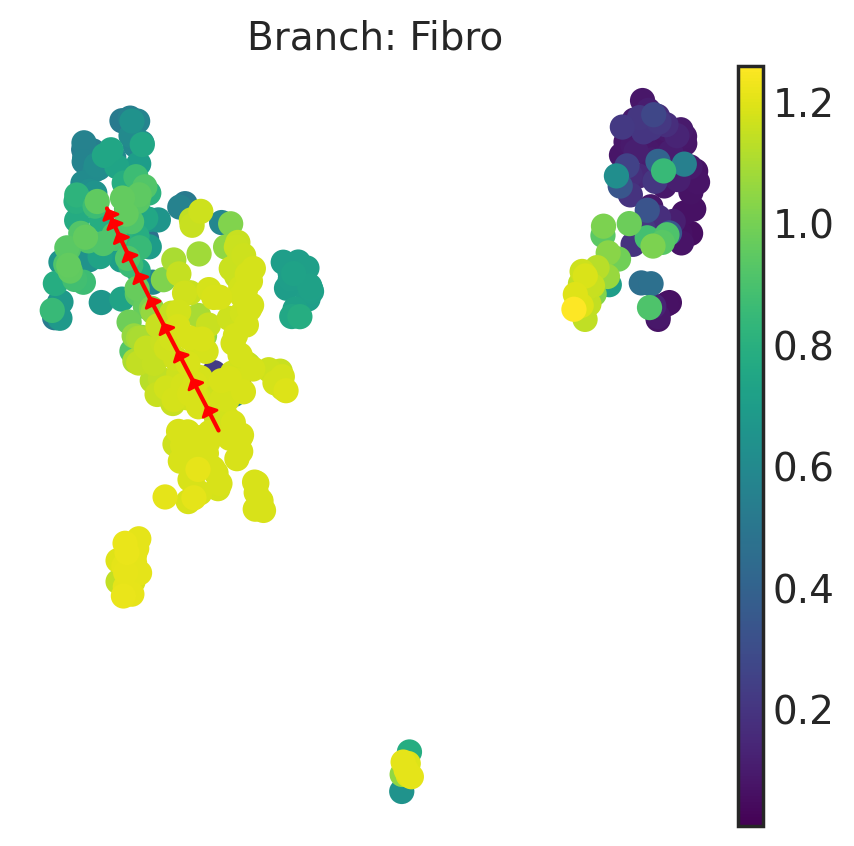

In [1722]:
palantir.plot.plot_trajectory(
    _sadata,
    "Fibro",
    cell_color="palantir_entropy",
    n_arrows=10,
    color="red",
    scanpy_kwargs=dict(cmap="viridis"),
    arrowprops=dict(arrowstyle="-|>,head_length=.2,head_width=.2"),
)

[2025-03-07 15:43:28,365] [INFO    ] Using sparse Gaussian Process since n_landmarks (50) < n_samples (77) and rank = 1.0.
[2025-03-07 15:43:28,366] [INFO    ] Using covariance function Matern52(ls=1.4753418922424317).
[2025-03-07 15:43:28,394] [INFO    ] Computing 50 landmarks with k-means clustering.
[2025-03-07 15:43:29,104] [INFO    ] Sigma interpreted as element-wise standard deviation.


<Axes: title={'center': 'Branch: TB-like'}, xlabel='UMAP1', ylabel='UMAP2'>

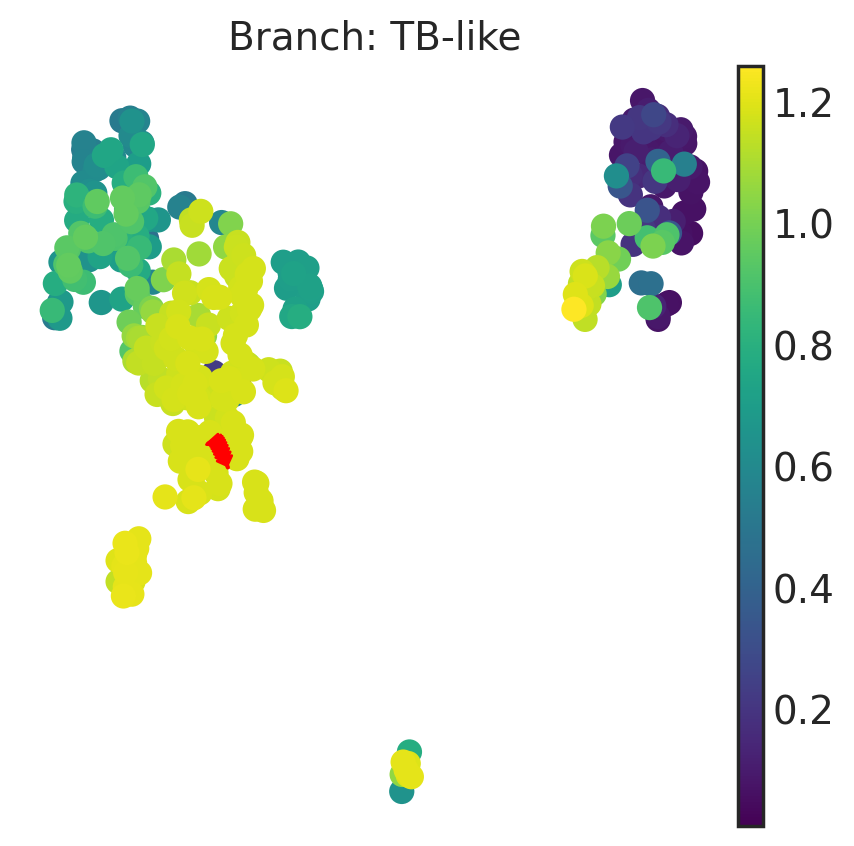

In [1723]:
palantir.plot.plot_trajectory(
    _sadata,
    "TB-like",
    cell_color="palantir_entropy",
    n_arrows=10,
    color="red",
    scanpy_kwargs=dict(cmap="viridis"),
    arrowprops=dict(arrowstyle="-|>,head_length=.2,head_width=.2"),
)

[2025-03-07 15:43:42,740] [INFO    ] Using sparse Gaussian Process since n_landmarks (50) < n_samples (187) and rank = 1.0.
[2025-03-07 15:43:42,742] [INFO    ] Using covariance function Matern52(ls=1.4753418922424317).
[2025-03-07 15:43:42,788] [INFO    ] Computing 50 landmarks with k-means clustering.
[2025-03-07 15:43:43,602] [INFO    ] Sigma interpreted as element-wise standard deviation.


<Axes: title={'center': 'Branch: MEP'}, xlabel='UMAP1', ylabel='UMAP2'>

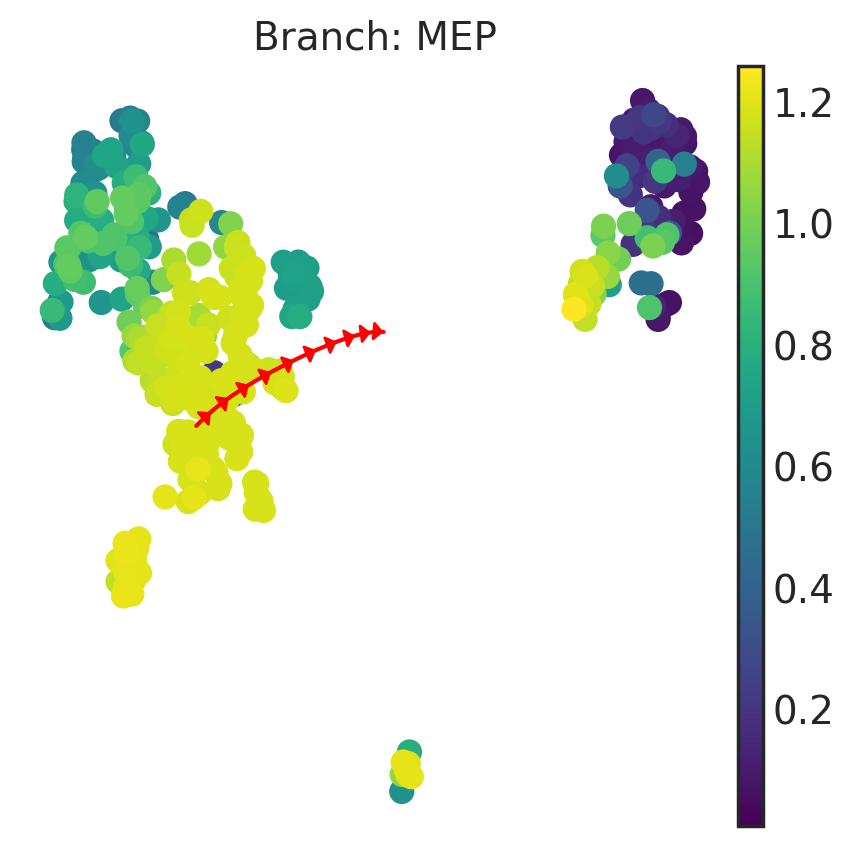

In [1724]:
palantir.plot.plot_trajectory(
    _sadata,
    "MEP",
    cell_color="palantir_entropy",
    n_arrows=10,
    color="red",
    scanpy_kwargs=dict(cmap="viridis"),
    arrowprops=dict(arrowstyle="-|>,head_length=.2,head_width=.2"),
)

In [1728]:
gene_trends = palantir.presults.compute_gene_trends(
    _sadata,
    expression_key="MAGIC_imputed_data",
)

MEP
[2025-03-07 15:47:54,309] [INFO    ] Using non-sparse Gaussian Process since n_landmarks (500) >= n_samples (187) and rank = 1.0.
[2025-03-07 15:47:54,311] [INFO    ] Using covariance function Matern52(ls=1.0).
[2025-03-07 15:47:55,130] [INFO    ] Sigma interpreted as element-wise standard deviation.
Endo
[2025-03-07 15:47:55,447] [INFO    ] Using non-sparse Gaussian Process since n_landmarks (500) >= n_samples (88) and rank = 1.0.
[2025-03-07 15:47:55,448] [INFO    ] Using covariance function Matern52(ls=1.0).
[2025-03-07 15:47:56,100] [INFO    ] Sigma interpreted as element-wise standard deviation.
HPC
[2025-03-07 15:47:56,458] [INFO    ] Using non-sparse Gaussian Process since n_landmarks (500) >= n_samples (209) and rank = 1.0.
[2025-03-07 15:47:56,458] [INFO    ] Using covariance function Matern52(ls=1.0).
[2025-03-07 15:47:57,229] [INFO    ] Sigma interpreted as element-wise standard deviation.
YSE
[2025-03-07 15:47:57,486] [INFO    ] Using non-sparse Gaussian Process since n

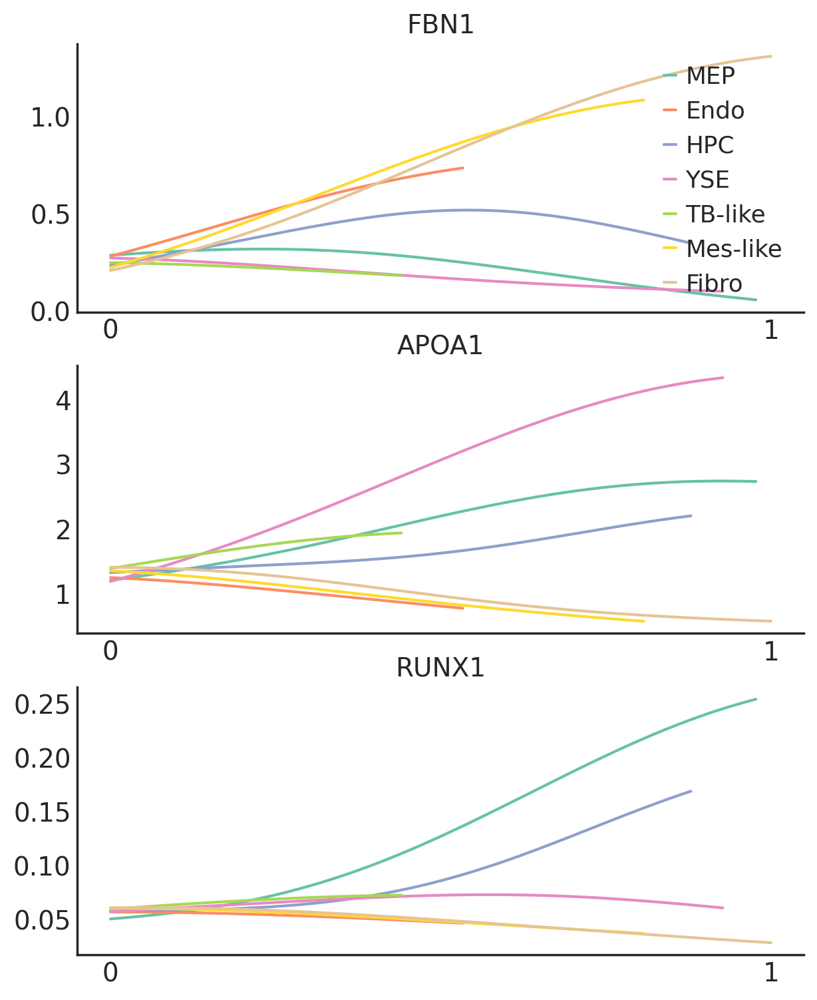

In [1729]:
genes = ['FBN1', 'APOA1', 'RUNX1']
palantir.plot.plot_gene_trends(_sadata, genes)
plt.show()

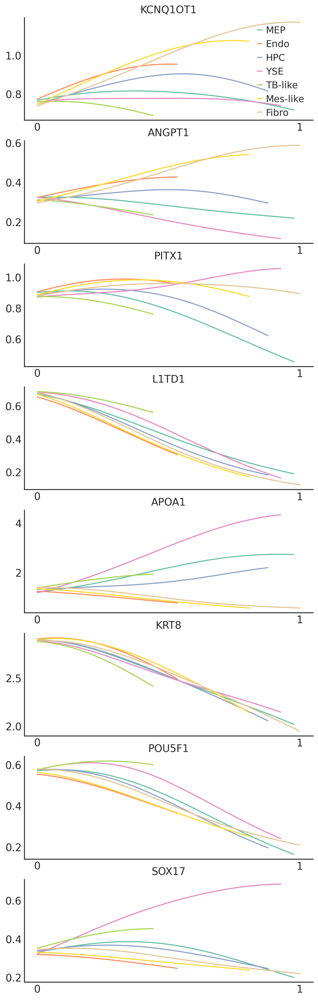

In [1730]:
genes = ["KCNQ1OT1", "ANGPT1", "PITX1", "L1TD1", 'APOA1', 'KRT8', 'POU5F1', 'SOX17']
palantir.plot.plot_gene_trends(_sadata, genes)
plt.show()

In [ ]:
palantir.plot.plot_gene_trend_heatmaps(_sadata, genes)
plt.show()

In [ ]:
marker_genes = {
    "CM-like": ['NKX2-5', 'MSX1', 'MSX2', 'MDK', 'ID3'], # cm-like
    "Ect-like": ['KCNQ1OT1', 'SNHG14', 'DST', 'PRTG', 'TBX3'], # ect-like
    "Endo": ['KDR', 'CDH5', 'PECAM1', 'CD34'], # endo
    "Ery": ['HBZ', 'HBA1', 'HBA2', 'GYPA', 'TFRC'], # ery
    "Fibro": ['ANGPT1', 'HGF', 'FBN1', 'ITGA1'], # fibro
    "HPC": ['RUNX1', 'IL5RA', 'ITGB2', 'CEBPB', 'IFI6'], # hpc
    "MEP": ['GYPB', 'GIHCG', 'HDC', 'ARHGDIB', 'GMFG'], # mep
    "MP-1": ['PRG3', 'PRG2', 'EPX', 'PRSS57', 'MS4A3'], # mp-1
    "MP-2": ['LMO4', 'GATA2', 'PTPRC', 'KCNK17', 'FCER1G'], # mp-2
    "Mes-like": ['PITX1', 'TMEM88', 'HAND1', 'BMP4', 'ACTC1'], # mes-like
    "Mk": ['PF4', 'PPBP', 'GP9', 'PLEK', 'THBS1'], # mk
    "Mono": ['C1QB', 'CD14', 'S100A9', 'S100B', 'CEBPD'], # mono
    "NC": ['PLP1', 'PAX3', 'SOX10', 'SOX11'], # nc
    "NE-like": ['SFRP2', 'GPC3', 'PAX6', 'FZD3', 'SOX2'], # ne-like
    "PSC-Ect": ['L1TD1', 'TERF1', 'DNMT3B', 'SEMA6A', 'NES'], # psc-ect
    "PSC-like": ['POU5F1', 'SOX17', 'NANOG', 'NANOS3', 'TFAP2C'], # psc-like
    "TB-like": ['KRT8', 'KRT18', 'CDH1', 'TFAP2A', 'PTN'], # tb-like
    "YSE": ['APOA1', 'APOA2', 'APOE', 'AFP', 'KRT19'] # yse
    # Note: DMXL2 should be. "COBLL1", "TCF4"],
}

sc.pl.dotplot(c_adata, marker_genes, groupby="discrete_label_ct", standard_scale="var", cmap="Reds")
# sc.pl.dotplot(c_adata, marker_genes, groupby="discrete_label_ct", standard_scale="var", cmap="Purples")


In [656]:
sc.tl.draw_graph(c_adata)

drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fr', graph_drawing coordinates (adata.obsm) (0:00:20)


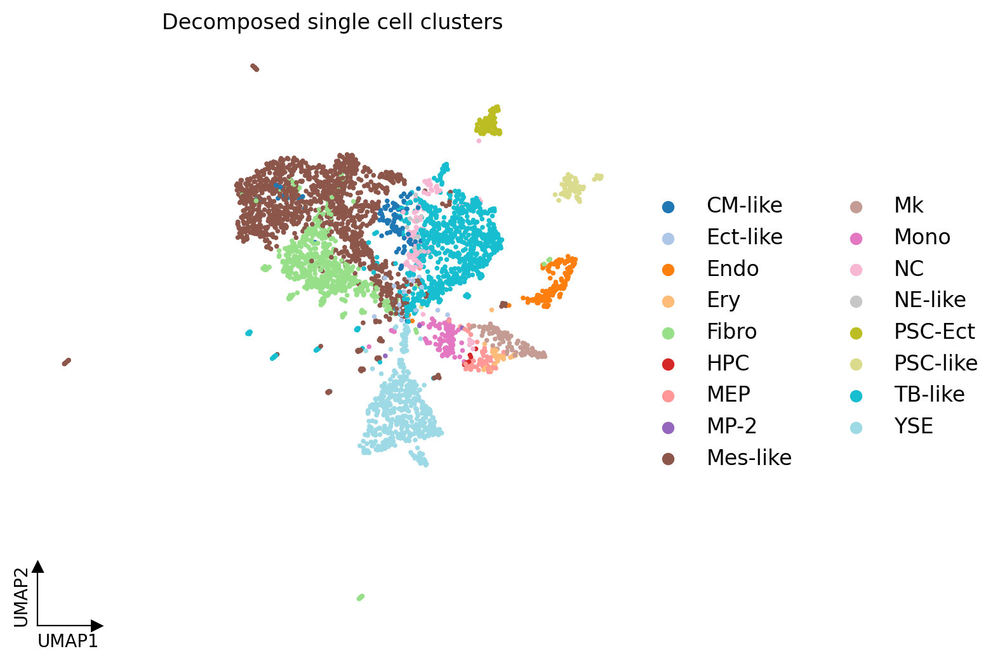

In [481]:
fig, ax = plt.subplots(figsize=(6, 6))
sc.pl.umap(c_adata, color=['discrete_label_ct'], show=False, ax=ax, legend_fontsize=12, title='Decomposed single cell clusters')

shrink_by = 0.1
xlim = ax.get_xlim()
ylim = ax.get_ylim()

xbound = xlim[0] + (xlim[1] - xlim[0]) * shrink_by
ybound = ylim[0] + (ylim[1] - ylim[0]) * shrink_by

b = ax.spines["bottom"]
b.set_bounds(xlim[0], xbound)
ax.set_xlabel(ax.get_xlabel(), x=0, ha="left")
ax.plot(xbound, 0, ">k", transform=ax.get_xaxis_transform(), clip_on=False)

b = ax.spines["left"]
b.set_bounds(ylim[0], ybound)
ax.set_ylabel(ax.get_ylabel(), y=0, ha="left")
ax.plot(0, ybound, "^k", transform=ax.get_yaxis_transform(), clip_on=False)

ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

In [482]:
c_adata

AnnData object with n_obs × n_vars = 3997 × 2235
    obs: 'x', 'y', 'spot_index', 'cell_index', 'cell_nums', 'discrete_label', 'discrete_label_ct', 'cell_w', 'hemo_label', '1872T>A', '1868G>A', '2129G>A', '1906G>A', '843G>A', '842C>A', '9989T>C', '838T>A', '8594T>G', '3219G>A', '2559T>G', '8597T>G', '2266T>G', '3174T>A', '8610T>G', '8618T>G', '2292G>A', '1858G>A', '2562T>G', '2351T>G', '8603T>G', '2507A>T', 'barcode', 'clone', 'clusters'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'cell_locations', 'clusters_colors', 'hvg', 'id_colors', 'leiden', 'log1p', 'neighbors', 'pca', 'spatial', 'umap', 'discrete_label_ct_colors', 'clusters', 'clone_colors', 'diffmap_evals', 'DM_EigenValues'
    obsm: 'spatial', 'X_pca', 'X_umap', 'DM_EigenVectors', 'DM_EigenVectors_multiscaled'
    varm: 'PCs'
    obsp: 'distances', 'connectivities', 'DM_Kernel', 'DM_Similarity'

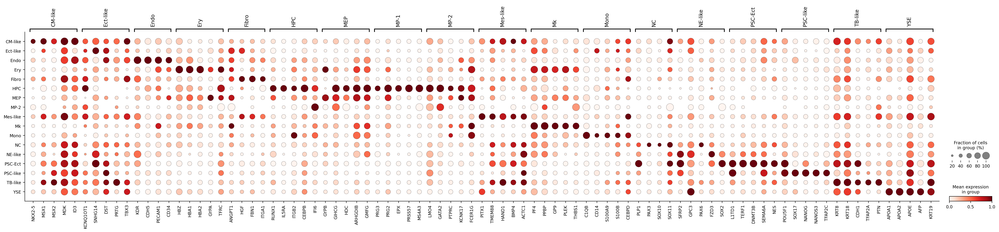

In [483]:
marker_genes = {
    "CM-like": ['NKX2-5', 'MSX1', 'MSX2', 'MDK', 'ID3'], # cm-like
    "Ect-like": ['KCNQ1OT1', 'SNHG14', 'DST', 'PRTG', 'TBX3'], # ect-like
    "Endo": ['KDR', 'CDH5', 'PECAM1', 'CD34'], # endo
    "Ery": ['HBZ', 'HBA1', 'HBA2', 'GYPA', 'TFRC'], # ery
    "Fibro": ['ANGPT1', 'HGF', 'FBN1', 'ITGA1'], # fibro
    "HPC": ['RUNX1', 'IL5RA', 'ITGB2', 'CEBPB', 'IFI6'], # hpc
    "MEP": ['GYPB', 'GIHCG', 'HDC', 'ARHGDIB', 'GMFG'], # mep
    "MP-1": ['PRG3', 'PRG2', 'EPX', 'PRSS57', 'MS4A3'], # mp-1
    "MP-2": ['LMO4', 'GATA2', 'PTPRC', 'KCNK17', 'FCER1G'], # mp-2
    "Mes-like": ['PITX1', 'TMEM88', 'HAND1', 'BMP4', 'ACTC1'], # mes-like
    "Mk": ['PF4', 'PPBP', 'GP9', 'PLEK', 'THBS1'], # mk
    "Mono": ['C1QB', 'CD14', 'S100A9', 'S100B', 'CEBPD'], # mono
    "NC": ['PLP1', 'PAX3', 'SOX10', 'SOX11'], # nc
    "NE-like": ['SFRP2', 'GPC3', 'PAX6', 'FZD3', 'SOX2'], # ne-like
    "PSC-Ect": ['L1TD1', 'TERF1', 'DNMT3B', 'SEMA6A', 'NES'], # psc-ect
    "PSC-like": ['POU5F1', 'SOX17', 'NANOG', 'NANOS3', 'TFAP2C'], # psc-like
    "TB-like": ['KRT8', 'KRT18', 'CDH1', 'TFAP2A', 'PTN'], # tb-like
    "YSE": ['APOA1', 'APOA2', 'APOE', 'AFP', 'KRT19'] # yse
    # Note: DMXL2 should be. "COBLL1", "TCF4"],
}

sc.pl.dotplot(c_adata, marker_genes, groupby="discrete_label_ct", standard_scale="var", cmap="Reds")
# sc.pl.dotplot(c_adata, marker_genes, groupby="discrete_label_ct", standard_scale="var", cmap="Purples")


In [523]:
ct_dc_df = adata.uns['cell_locations']
print(ct_dc_df.shape)
m_df = pd.merge(ct_dc_df, clone_df, how='left', left_on="spot_index", right_on="ID").dropna()
m_df.shape
# sc_df = pd.merge(sc_p_df, clone_df, how='left')

(3997, 8)


(3997, 10)

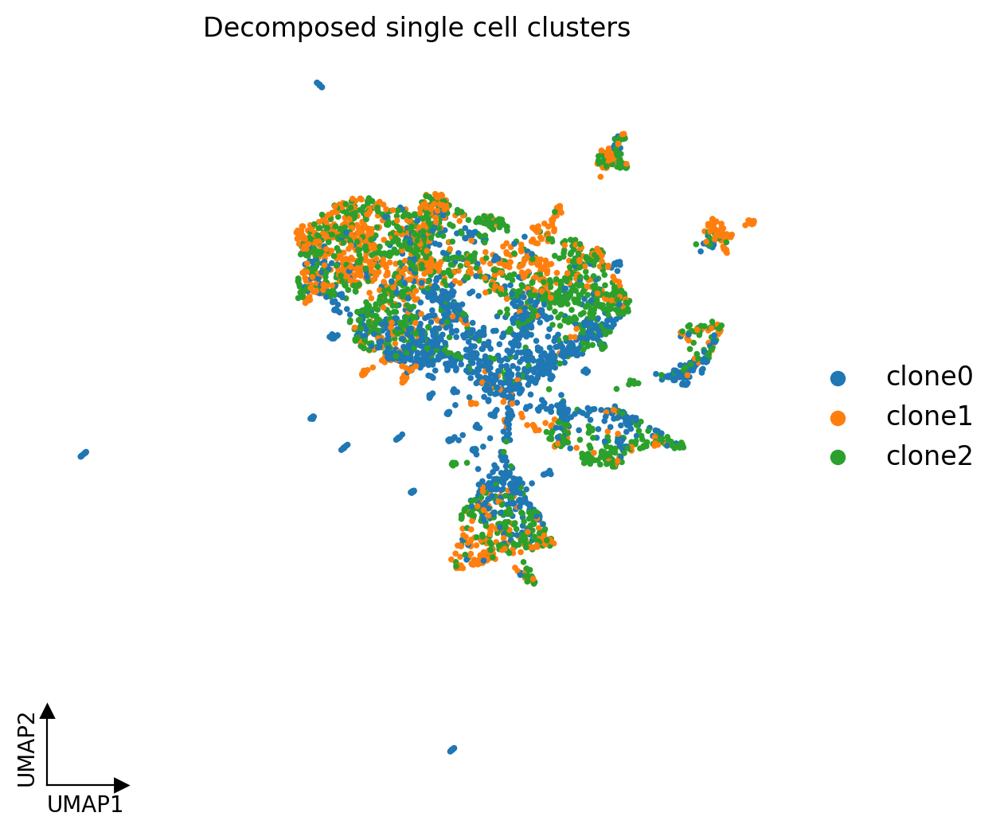

In [484]:
fig, ax = plt.subplots(figsize=(6, 6))
sc.pl.umap(c_adata, color=['clone'], show=False, ax=ax, legend_fontsize=12, title='Decomposed single cell clusters')

shrink_by = 0.1
xlim = ax.get_xlim()
ylim = ax.get_ylim()

xbound = xlim[0] + (xlim[1] - xlim[0]) * shrink_by
ybound = ylim[0] + (ylim[1] - ylim[0]) * shrink_by

b = ax.spines["bottom"]
b.set_bounds(xlim[0], xbound)
ax.set_xlabel(ax.get_xlabel(), x=0, ha="left")
ax.plot(xbound, 0, ">k", transform=ax.get_xaxis_transform(), clip_on=False)

b = ax.spines["left"]
b.set_bounds(ylim[0], ybound)
ax.set_ylabel(ax.get_ylabel(), y=0, ha="left")
ax.plot(0, ybound, "^k", transform=ax.get_yaxis_transform(), clip_on=False)

ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

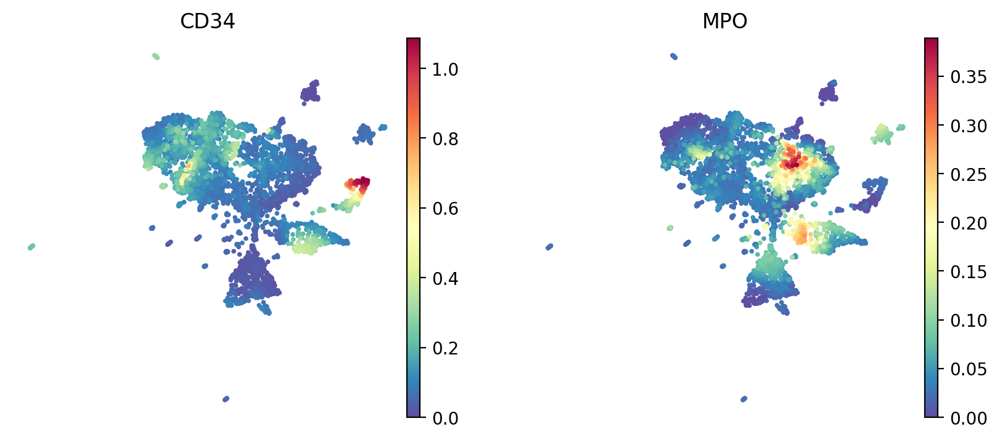

In [485]:
imputed_X = palantir.utils.run_magic_imputation(c_adata)
sc.pl.embedding(
    c_adata,
    basis="umap",
    layer="MAGIC_imputed_data",
    color=["CD34", "MPO"],
    frameon=False,
)
plt.show()

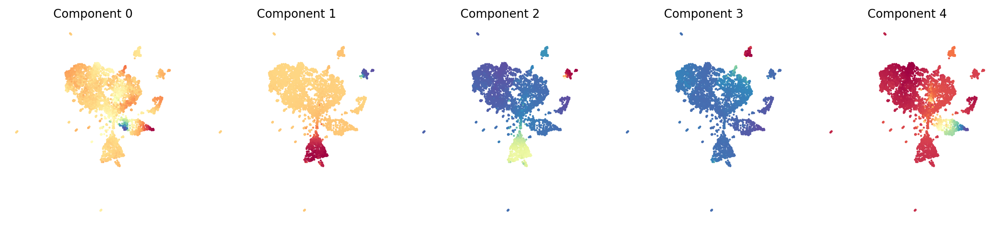

In [486]:
palantir.plot.plot_diffusion_components(c_adata)
plt.show()

In [ ]:
import matplotlib as mpl


import math


ncols = 5
_n = len(all_part_i)
n_l = int(math.ceil(_n/ncols))

nrows = n_l
figsize = 4
wspace = 0
fig, axs = plt.subplots(
    nrows=nrows,
    ncols=ncols,
    figsize=(ncols * figsize + figsize * wspace * (ncols - 1), nrows * figsize),constrained_layout=True
)
# print(axs)
# plt.subplots_adjust(wspace=wspace)

p_s = 1.5

axs = axs.flatten()

for i in range(_n):
#     print(i, int(i/ncols), i%ncols)
    # _ax = axs[int(i/ncols), i%ncols]
    _ax = axs[i]
#     _ax = axs[int(i%ncols)]
    _ax.get_xaxis().set_visible(False)
    _ax.get_yaxis().set_visible(False)


# fig, ax = plt.subplots(1,1,figsize=(12, 8),dpi=100)
    ax = _ax
    # merged_df = adata.uns['cell_locations'].copy()
    merged_df = m_df.copy()
    # merged_df = merged_df[merged_df['discrete_label_ct'].isin(['Ery', 'Mk', 'MEP', 'YSE'])]
    
    # merged_df
    test = sc.AnnData(np.zeros(merged_df.shape), obs=merged_df)
    test.obsm['spatial'] = merged_df[["x", "y"]].to_numpy().copy()
    test.uns = adata.uns
    
    size=0.8
    size=0.5
    alpha_img=0.3
    lw=1
    palette='Paired'
    show_circle = False
    legend = True
    # ax=None
    # annotation_list = ["discrete_label_ct"]
    annotation_list = ["clone"]
    crop_coord = None
    _title = ""
    crop_coord = [5500, 8200, 4500, 6200]
    crop_coord = all_part_i[i][1]
    skip_coord = all_part_i[i][2]
    _title = all_part_i[i][0]
    subset=None
    
    if crop_coord != None:
        # subset = test.obs[['x','y']].query('(%d<x<%d) & (%d<y<%d)' % (crop_coord[0], crop_coord[1], crop_coord[2], crop_coord[3])).index
        subset = get_tar_df(test.obs, 'x', 'y', crop_coord, skip_coord)
    
    if subset is not None:
            #test = test[test.obs[annotation_list].isin(subset)]
            # test.obs.loc[~test.obs[annotation_list].isin(subset),annotation_list] = None
            test.obs.loc[~test.obs.index.isin(subset),annotation_list] = None
    sc.pl.spatial(
            test,
            color=annotation_list,
            crop_coord = crop_coord,
            size=size,
            frameon=False,
            alpha_img=alpha_img,
            show=False,
            palette=palette,
            na_in_legend=False,
            ax=ax,title=_title,sort_order=True
        )
    if show_circle:
            sf = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['tissue_hires_scalef']
            spot_radius = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['spot_diameter_fullres']/2
            for sloc in adata.obsm['spatial']:
                rect = mpl.patches.Circle(
                    (sloc[0] * sf, sloc[1] * sf),
                    spot_radius * sf,
                    ec="grey",
                    lw=lw,
                    fill=False
                )
                ax.add_patch(rect)
    ax.axes.xaxis.label.set_visible(False)
    ax.axes.yaxis.label.set_visible(False)
    
    if not legend:
        ax.get_legend().remove()
    
    # make frame visible
    for _, spine in ax.spines.items():
        spine.set_visible(True)
        
[fig.delaxes(ax) for ax in axs.flatten() if not ax.has_data()]


In [ ]:
handles, labels = ax.get_legend_handles_labels()  # Get the legend handles and labels
legend_colors = [handle.get_facecolor() for handle in handles]  # Extract the colors

# Print the legend colors and labels
print("Legend Labels:", labels)
print("Legend Colors:", legend_colors)

# tuple(legend_colors[0][0].tolist())
_color_mapping = {labels[i]: tuple(legend_colors[i][0].tolist())for i in range(len(labels))}
_color_mapping

/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/autofs/bal31/jhsu/home/_env

[]

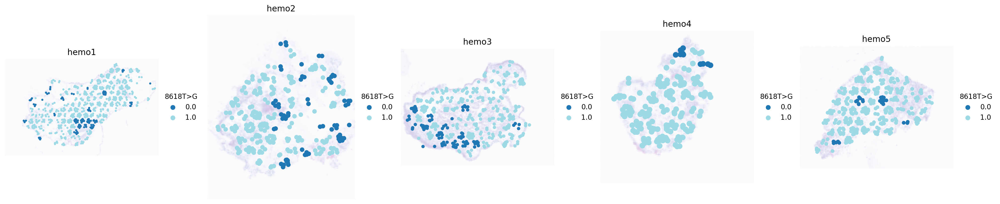

In [345]:
import matplotlib as mpl


import math


ncols = 5
_n = len(all_part_i)
n_l = int(math.ceil(_n/ncols))

nrows = n_l
figsize = 4
wspace = 0
fig, axs = plt.subplots(
    nrows=nrows,
    ncols=ncols,
    figsize=(ncols * figsize + figsize * wspace * (ncols - 1), nrows * figsize),constrained_layout=True
)
# print(axs)
# plt.subplots_adjust(wspace=wspace)

p_s = 1.5


tar_l = '8618T>G'
axs = axs.flatten()

for i in range(_n):
#     print(i, int(i/ncols), i%ncols)
    # _ax = axs[int(i/ncols), i%ncols]
    _ax = axs[i]
#     _ax = axs[int(i%ncols)]
    _ax.get_xaxis().set_visible(False)
    _ax.get_yaxis().set_visible(False)


# fig, ax = plt.subplots(1,1,figsize=(12, 8),dpi=100)
    ax = _ax
    # merged_df = adata.uns['cell_locations'].copy()
    merged_df = m_df.copy()
    merged_df[tar_l] = merged_df[tar_l].astype('str')
    
    # merged_df = merged_df[merged_df['discrete_label_ct'].isin(['Ery', 'Mk', 'MEP', 'YSE'])]
    
    # merged_df
    test = sc.AnnData(np.zeros(merged_df.shape), obs=merged_df)
    test.obsm['spatial'] = merged_df[["x", "y"]].to_numpy().copy()
    test.uns = adata.uns
    
    size=0.8
    size=0.5
    alpha_img=0.3
    lw=1
    palette='tab20'
    show_circle = False
    legend = True
    # ax=None
    annotation_list = [tar_l]
    # annotation_list = ["clone"]
    crop_coord = None
    _title = ""
    crop_coord = [5500, 8200, 4500, 6200]
    crop_coord = all_part_i[i][1]
    skip_coord = all_part_i[i][2]
    _title = all_part_i[i][0]
    subset=None
    
    if crop_coord != None:
        # subset = test.obs[['x','y']].query('(%d<x<%d) & (%d<y<%d)' % (crop_coord[0], crop_coord[1], crop_coord[2], crop_coord[3])).index
        subset = get_tar_df(test.obs, 'x', 'y', crop_coord, skip_coord)
    
    if subset is not None:
            #test = test[test.obs[annotation_list].isin(subset)]
            # test.obs.loc[~test.obs[annotation_list].isin(subset),annotation_list] = None
            test.obs.loc[~test.obs.index.isin(subset),annotation_list] = None
    sc.pl.spatial(
            test,
            color=annotation_list,
            crop_coord = crop_coord,
            size=size,
            frameon=False,
            alpha_img=alpha_img,
            show=False,
            palette=palette,
            na_in_legend=False,
            ax=ax,title=_title,sort_order=True
        )
    if show_circle:
            sf = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['tissue_hires_scalef']
            spot_radius = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['spot_diameter_fullres']/2
            for sloc in adata.obsm['spatial']:
                rect = mpl.patches.Circle(
                    (sloc[0] * sf, sloc[1] * sf),
                    spot_radius * sf,
                    ec="grey",
                    lw=lw,
                    fill=False
                )
                ax.add_patch(rect)
    ax.axes.xaxis.label.set_visible(False)
    ax.axes.yaxis.label.set_visible(False)
    
    # ax.legend(bbox_to_anchor=(1.3, 0.85),fontsize=9)
    ax.get_legend().set_title("%s" % (tar_l))
    if not legend:
        ax.get_legend().remove()
    
    # make frame visible
    for _, spine in ax.spines.items():
        spine.set_visible(True)
        
[fig.delaxes(ax) for ax in axs.flatten() if not ax.has_data()]


/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/autofs/bal31/jhsu/home/_env/anaconda3/envs/scanpy/lib/python3.12/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/autofs/bal31/jhsu/home/_env

[]

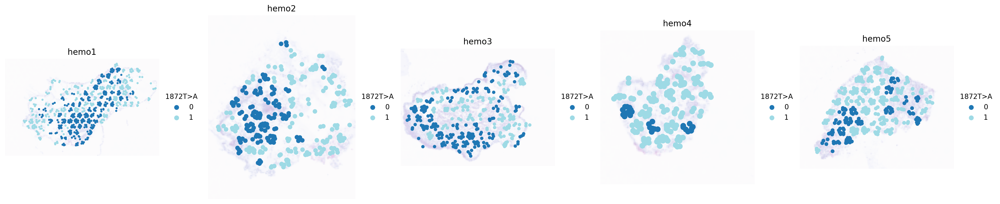

In [361]:
import matplotlib as mpl


import math


ncols = 5
_n = len(all_part_i)
n_l = int(math.ceil(_n/ncols))

nrows = n_l
figsize = 4
wspace = 0
fig, axs = plt.subplots(
    nrows=nrows,
    ncols=ncols,
    figsize=(ncols * figsize + figsize * wspace * (ncols - 1), nrows * figsize),constrained_layout=True
)
# print(axs)
# plt.subplots_adjust(wspace=wspace)

p_s = 1.5


tar_l = '1872T>A'
axs = axs.flatten()

for i in range(_n):
#     print(i, int(i/ncols), i%ncols)
    # _ax = axs[int(i/ncols), i%ncols]
    _ax = axs[i]
#     _ax = axs[int(i%ncols)]
    _ax.get_xaxis().set_visible(False)
    _ax.get_yaxis().set_visible(False)


# fig, ax = plt.subplots(1,1,figsize=(12, 8),dpi=100)
    ax = _ax
    # merged_df = adata.uns['cell_locations'].copy()
    merged_df = m_df.copy()
    merged_df[tar_l] = merged_df[tar_l].astype('int64').astype('str')
    
    # merged_df = merged_df[merged_df['discrete_label_ct'].isin(['Ery', 'Mk', 'MEP', 'YSE'])]
    
    # merged_df
    test = sc.AnnData(np.zeros(merged_df.shape), obs=merged_df)
    test.obsm['spatial'] = merged_df[["x", "y"]].to_numpy().copy()
    test.uns = adata.uns
    
    size=0.8
    size=0.5
    alpha_img=0.3
    lw=1
    palette='tab20'
    show_circle = False
    legend = True
    # ax=None
    annotation_list = [tar_l]
    # annotation_list = ["clone"]
    crop_coord = None
    _title = ""
    crop_coord = [5500, 8200, 4500, 6200]
    crop_coord = all_part_i[i][1]
    skip_coord = all_part_i[i][2]
    _title = all_part_i[i][0]
    subset=None
    
    if crop_coord != None:
        # subset = test.obs[['x','y']].query('(%d<x<%d) & (%d<y<%d)' % (crop_coord[0], crop_coord[1], crop_coord[2], crop_coord[3])).index
        subset = get_tar_df(test.obs, 'x', 'y', crop_coord, skip_coord)
    
    if subset is not None:
            #test = test[test.obs[annotation_list].isin(subset)]
            # test.obs.loc[~test.obs[annotation_list].isin(subset),annotation_list] = None
            test.obs.loc[~test.obs.index.isin(subset),annotation_list] = None
    sc.pl.spatial(
            test,
            color=annotation_list,
            crop_coord = crop_coord,
            size=size,
            frameon=False,
            alpha_img=alpha_img,
            show=False,
            palette=palette,
            na_in_legend=False,
            ax=ax,title=_title,sort_order=True
        )
    if show_circle:
            sf = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['tissue_hires_scalef']
            spot_radius = adata.uns['spatial'][list(adata.uns['spatial'].keys())[0]]['scalefactors']['spot_diameter_fullres']/2
            for sloc in adata.obsm['spatial']:
                rect = mpl.patches.Circle(
                    (sloc[0] * sf, sloc[1] * sf),
                    spot_radius * sf,
                    ec="grey",
                    lw=lw,
                    fill=False
                )
                ax.add_patch(rect)
    ax.axes.xaxis.label.set_visible(False)
    ax.axes.yaxis.label.set_visible(False)
    
    # ax.legend(bbox_to_anchor=(1.3, 0.85),fontsize=9)
    ax.get_legend().set_title("%s" % (tar_l))
    if not legend:
        ax.get_legend().remove()
    
    # make frame visible
    for _, spine in ax.spines.items():
        spine.set_visible(True)
        
[fig.delaxes(ax) for ax in axs.flatten() if not ax.has_data()]


In [334]:
m_df.columns

Index(['x', 'y', 'spot_index', 'cell_index', 'cell_nums', 'discrete_label',
       'discrete_label_ct', 'cell_w', 'hemo_label', '1872T>A', '1868G>A',
       '2129G>A', '1906G>A', '843G>A', '842C>A', '9989T>C', '838T>A',
       '8594T>G', '3219G>A', '2559T>G', '8597T>G', '2266T>G', '3174T>A',
       '8610T>G', '8618T>G', '2292G>A', '1858G>A', '2562T>G', '2351T>G',
       '8603T>G', '2507A>T', 'barcode', 'clone'],
      dtype='object')

hemo1
hemo2
hemo3
hemo4
hemo5


[None, None, None, None, None]

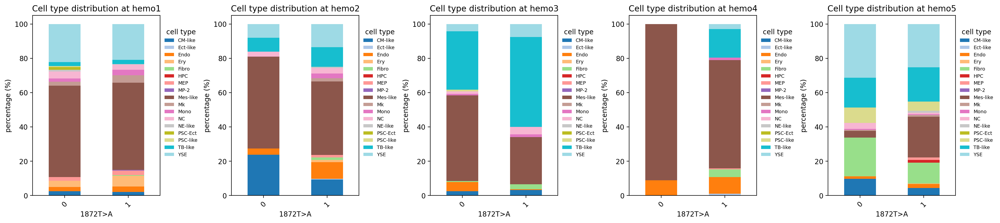

In [394]:
# plt.style.use(plt.rcParamsDefault)

ncols = 5
nrows = 2
figsize = 4
wspace = 0
fig, axs = plt.subplots(
    nrows=nrows,
    ncols=ncols,
    figsize=(ncols * figsize + figsize * wspace * (ncols - 1), nrows * figsize), constrained_layout=True
)

axs = axs.flatten()
ax_i = 0

tar_l = '1872T>A'


_n = len(all_part_i)
for i in range(_n):
    crop_coord = all_part_i[i][1]
    skip_coord = all_part_i[i][2]
    _title = all_part_i[i][0]


    # tar_hemo_id = 'hemo1'
    tar_hemo_id = _title
    print(tar_hemo_id)
    tar_m_df = m_df[m_df['hemo_label'] == tar_hemo_id].copy()
    tar_m_df[tar_l] = tar_m_df[tar_l].astype('int64').astype('str')
    
    _cnt_tar_m = tar_m_df.groupby([tar_l, 'discrete_label_ct'])['cell_w'].sum().reset_index().pivot(index=tar_l, columns='discrete_label_ct', values='cell_w')
    
    __cnt_tar_m = (_cnt_tar_m.div(_cnt_tar_m.sum(axis=1), axis=0) * 100).round(3)
    # print(__cnt_tar_m)
    
    ax = axs[ax_i]
    ax_i += 1
    
    # color_mapping = dict(zip(__cnt_tar_m.columns.tolist(), sns.color_palette('Paired', len(__cnt_tar_m.columns.tolist()))))
    color_mapping = _color_mapping
    # color_mapping = dict(zip(__cnt_tar_m.columns.tolist(), ([sns.color_palette("Paired", 10)[:] + sns.color_palette("Set2", len(__cnt_tar_m.columns.tolist())-10)][:])[0] ))
    plot_colors = [color_mapping[t] for t in __cnt_tar_m.columns.tolist()]
    
    __cnt_tar_m.plot(kind='bar', stacked=True, ax=ax, color=plot_colors)
    ax.set_title('Cell type distribution at %s' % (tar_hemo_id))
    ax.set_xlabel("%s" % (tar_l))
    ax.set_ylabel('percentage (%)')
    
    # for c in ax.containers:
    #     labels = ["%.1f" % (v.get_height()) if v.get_height() > 0 else '' for v in c]
    #     ax.bar_label(c, labels=labels, label_type='center')
    # ax.legend(bbox_to_anchor=(1.0, 0.95),fontsize=7)
    ax.legend(bbox_to_anchor=(1.0, 0.95),fontsize=7, frameon=False)
    ax.get_legend().set_title("cell type")
    ax.tick_params(axis='x', labelrotation=45)
    # break

[fig.delaxes(ax) for ax in axs.flatten() if not ax.has_data()]
